# TITLE: Hand Detection using EEG Data
 # By: Sai Teja Yarlagadda

## Import Dependencies

In [1]:
import numpy as np
import pandas as pd
import pywt
from glob import glob
import os
import mne
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
from sklearn.decomposition import FastICA

In [2]:
all_filepath=glob('CN/*.csv')
print(all_filepath)

['CN/RightHand_Movement_EPOCX_204221_2024.02.16T17.23.20.05.00.md.bp.csv', 'CN/Left_Leg_ Movement_EPOCX_204221_2024.02.16T17.29.34.05.00.md.bp.csv', 'CN/LeftHand_movement_EPOCX_204221_2024.02.16T17.17.07.05.00.md.bp.csv', 'CN/Right_Leg_Movement_EPOCX_204221_2024.02.16T17.33.33.05.00.md.bp.csv']


In [3]:
filepath=all_filepath[2]
filepath1=all_filepath[0]
print(filepath)
print(filepath1)

CN/LeftHand_movement_EPOCX_204221_2024.02.16T17.17.07.05.00.md.bp.csv
CN/RightHand_Movement_EPOCX_204221_2024.02.16T17.23.20.05.00.md.bp.csv


In [4]:
# data_ll=pd.read_csv(filepath)
data_rh=pd.read_csv(filepath1,skiprows=1)
data_lh=pd.read_csv(filepath, skiprows=1)

In [5]:
# data_ll.head()
data_lh.head()


,Timestamp,OriginalTimestamp,EEG.Counter,EEG.Interpolated,EEG.AF3,EEG.F7,EEG.F3,EEG.FC5,EEG.T7,EEG.P7,...,POW.F8.Theta,POW.F8.Alpha,POW.F8.BetaL,POW.F8.BetaH,POW.F8.Gamma,POW.AF4.Theta,POW.AF4.Alpha,POW.AF4.BetaL,POW.AF4.BetaH,POW.AF4.Gamma
0,1.708122e+09,1.708122e+09,66.0,0.0,4290.641113,4276.666504,4326.025879,4316.538574,4307.692383,4310.641113,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1.708122e+09,1.708122e+09,67.0,0.0,4294.487305,4276.794922,4331.666504,4327.179688,4310.128418,4311.410156,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.708122e+09,1.708122e+09,68.0,0.0,4297.948730,4275.897461,4334.487305,4327.692383,4309.230957,4311.538574,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1.708122e+09,1.708122e+09,69.0,0.0,4294.487305,4268.846191,4328.077148,4314.358887,4305.256348,4313.333496,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1.708122e+09,1.708122e+09,70.0,0.0,4281.538574,4258.717773,4319.743652,4307.179688,4300.000000,4310.384766,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Exploratory Data Analysis

In [6]:

af4_index = data_lh.columns.get_loc('EEG.AF4')
data_lh = data_lh.iloc[:, :af4_index + 1]
data_lh.head()

,Timestamp,OriginalTimestamp,EEG.Counter,EEG.Interpolated,EEG.AF3,EEG.F7,EEG.F3,EEG.FC5,EEG.T7,EEG.P7,EEG.O1,EEG.O2,EEG.P8,EEG.T8,EEG.FC6,EEG.F4,EEG.F8,EEG.AF4
0,1.708122e+09,1.708122e+09,66.0,0.0,4290.641113,4276.666504,4326.025879,4316.538574,4307.692383,4310.641113,4296.794922,4301.538574,4276.922852,4291.666504,4502.051270,4482.307617,4371.282227,4441.025879
1,1.708122e+09,1.708122e+09,67.0,0.0,4294.487305,4276.794922,4331.666504,4327.179688,4310.128418,4311.410156,4305.512695,4308.846191,4288.077148,4293.205078,4505.000000,4490.128418,4377.692383,4447.820313
2,1.708122e+09,1.708122e+09,68.0,0.0,4297.948730,4275.897461,4334.487305,4327.692383,4309.230957,4311.538574,4304.487305,4314.743652,4302.820313,4297.051270,4510.256348,4498.846191,4384.358887,4449.102539
3,1.708122e+09,1.708122e+09,69.0,0.0,4294.487305,4268.846191,4328.077148,4314.358887,4305.256348,4313.333496,4306.666504,4322.051270,4308.846191,4300.384766,4511.153809,4496.922852,4384.871582,4447.307617
4,1.708122e+09,1.708122e+09,70.0,0.0,4281.538574,4258.717773,4319.743652,4307.179688,4300.000000,4310.384766,4311.922852,4326.538574,4309.230957,4300.641113,4506.025879,4487.948730,4377.436035,4443.846191


In [7]:
af4_index = data_rh.columns.get_loc('EEG.AF4')
data_rh = data_rh.iloc[:, :af4_index + 1]

In [8]:
data_rh.head()

,Timestamp,OriginalTimestamp,EEG.Counter,EEG.Interpolated,EEG.AF3,EEG.F7,EEG.F3,EEG.FC5,EEG.T7,EEG.P7,EEG.O1,EEG.O2,EEG.P8,EEG.T8,EEG.FC6,EEG.F4,EEG.F8,EEG.AF4
0,1.708122e+09,1.708122e+09,82.0,0.0,4301.025879,4282.563965,4322.179688,4325.000000,4310.641113,4307.307617,4307.436035,4305.641113,4291.410156,4293.846191,4507.436035,4489.871582,4383.077148,4440.641113
1,1.708122e+09,1.708122e+09,83.0,0.0,4296.153809,4286.025879,4321.922852,4324.871582,4312.179688,4308.205078,4307.563965,4303.974121,4291.666504,4296.666504,4502.436035,4488.974121,4389.358887,4441.794922
2,1.708122e+09,1.708122e+09,84.0,0.0,4295.769043,4289.743652,4323.077148,4327.051270,4313.589844,4312.692383,4309.102539,4307.051270,4294.487305,4296.666504,4498.846191,4491.282227,4391.538574,4445.897461
3,1.708122e+09,1.708122e+09,85.0,0.0,4296.410156,4282.307617,4321.666504,4325.897461,4313.205078,4313.077148,4305.384766,4303.846191,4294.358887,4293.205078,4497.692383,4485.128418,4384.487305,4443.077148
4,1.708122e+09,1.708122e+09,86.0,0.0,4299.871582,4280.641113,4322.820313,4324.230957,4311.794922,4310.512695,4301.153809,4294.871582,4291.538574,4290.128418,4497.948730,4483.461426,4377.563965,4441.410156


In [9]:
# data_ll.info()
data_lh.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38688 entries, 0 to 38687
Data columns (total 18 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Timestamp          38688 non-null  float64
 1   OriginalTimestamp  38688 non-null  float64
 2   EEG.Counter        38688 non-null  float64
 3   EEG.Interpolated   38688 non-null  float64
 4   EEG.AF3            38688 non-null  float64
 5   EEG.F7             38688 non-null  float64
 6   EEG.F3             38688 non-null  float64
 7   EEG.FC5            38688 non-null  float64
 8   EEG.T7             38688 non-null  float64
 9   EEG.P7             38688 non-null  float64
 10  EEG.O1             38688 non-null  float64
 11  EEG.O2             38688 non-null  float64
 12  EEG.P8             38688 non-null  float64
 13  EEG.T8             38688 non-null  float64
 14  EEG.FC6            38688 non-null  float64
 15  EEG.F4             38688 non-null  float64
 16  EEG.F8             386

In [10]:
data_lh.describe()

,Timestamp,OriginalTimestamp,EEG.Counter,EEG.Interpolated,EEG.AF3,EEG.F7,EEG.F3,EEG.FC5,EEG.T7,EEG.P7,EEG.O1,EEG.O2,EEG.P8,EEG.T8,EEG.FC6,EEG.F4,EEG.F8,EEG.AF4
count,3.868800e+04,3.868800e+04,38688.000000,38688.0,38688.000000,38688.000000,38688.000000,38688.000000,38688.000000,38688.000000,38688.000000,38688.000000,38688.000000,38688.000000,38688.000000,38688.000000,38688.000000,38688.000000
mean,1.708122e+09,1.708122e+09,63.514888,0.0,4310.451454,4295.871279,4332.790225,4328.911019,4308.063754,4311.402244,4308.326320,4309.705437,4300.575329,4291.018645,4512.981312,4500.558842,4388.121732,4455.993232
std,8.720576e+01,8.720577e+01,36.939062,0.0,19.731505,26.894242,15.412625,17.224762,13.491204,10.376529,9.928135,13.271874,11.796026,13.235937,22.925272,19.901863,31.202480,21.396466
min,1.708122e+09,1.708122e+09,0.000000,0.0,4227.820313,4213.077148,4241.666504,4261.410156,4229.102539,4246.025879,4251.282227,4229.615234,4235.769043,4218.974121,4378.077148,4397.948730,4241.922852,4342.307617
25%,1.708122e+09,1.708122e+09,32.000000,0.0,4297.692383,4281.282227,4324.487305,4320.641113,4300.000000,4306.538574,4302.660278,4301.890870,4293.589844,4281.794922,4501.538574,4489.358887,4371.666504,4443.846191
50%,1.708122e+09,1.708122e+09,64.000000,0.0,4309.615234,4293.717773,4331.025879,4326.794922,4308.333496,4310.769043,4309.102539,4309.871582,4299.358887,4292.051270,4509.871582,4499.423096,4384.230957,4455.512695
75%,1.708122e+09,1.708122e+09,95.000000,0.0,4318.717773,4303.589844,4341.153809,4335.512695,4313.205078,4317.307617,4313.333496,4316.794922,4308.846191,4297.051270,4522.563965,4509.358887,4398.461426,4463.461426
max,1.708122e+09,1.708122e+09,127.000000,0.0,4433.333496,4470.769043,4449.102539,4432.051270,4385.384766,4362.820313,4350.897461,4419.358887,4361.666504,4374.102539,4690.256348,4625.897461,4608.077148,4588.461426


In [11]:
data_rh.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39004 entries, 0 to 39003
Data columns (total 18 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Timestamp          39004 non-null  float64
 1   OriginalTimestamp  39004 non-null  float64
 2   EEG.Counter        39004 non-null  float64
 3   EEG.Interpolated   39004 non-null  float64
 4   EEG.AF3            39004 non-null  float64
 5   EEG.F7             39004 non-null  float64
 6   EEG.F3             39004 non-null  float64
 7   EEG.FC5            39004 non-null  float64
 8   EEG.T7             39004 non-null  float64
 9   EEG.P7             39004 non-null  float64
 10  EEG.O1             39004 non-null  float64
 11  EEG.O2             39004 non-null  float64
 12  EEG.P8             39004 non-null  float64
 13  EEG.T8             39004 non-null  float64
 14  EEG.FC6            39004 non-null  float64
 15  EEG.F4             39004 non-null  float64
 16  EEG.F8             390

In [12]:
data_lh.shape

(38688, 18)

In [13]:
data_rh.shape

(39004, 18)

In [14]:
#Data visual

In [15]:
print(data_lh.columns)


Index(['Timestamp', 'OriginalTimestamp', 'EEG.Counter', 'EEG.Interpolated',
       'EEG.AF3', 'EEG.F7', 'EEG.F3', 'EEG.FC5', 'EEG.T7', 'EEG.P7', 'EEG.O1',
       'EEG.O2', 'EEG.P8', 'EEG.T8', 'EEG.FC6', 'EEG.F4', 'EEG.F8', 'EEG.AF4'],
      dtype='object')


In [16]:
print(data_rh.columns)


Index(['Timestamp', 'OriginalTimestamp', 'EEG.Counter', 'EEG.Interpolated',
       'EEG.AF3', 'EEG.F7', 'EEG.F3', 'EEG.FC5', 'EEG.T7', 'EEG.P7', 'EEG.O1',
       'EEG.O2', 'EEG.P8', 'EEG.T8', 'EEG.FC6', 'EEG.F4', 'EEG.F8', 'EEG.AF4'],
      dtype='object')


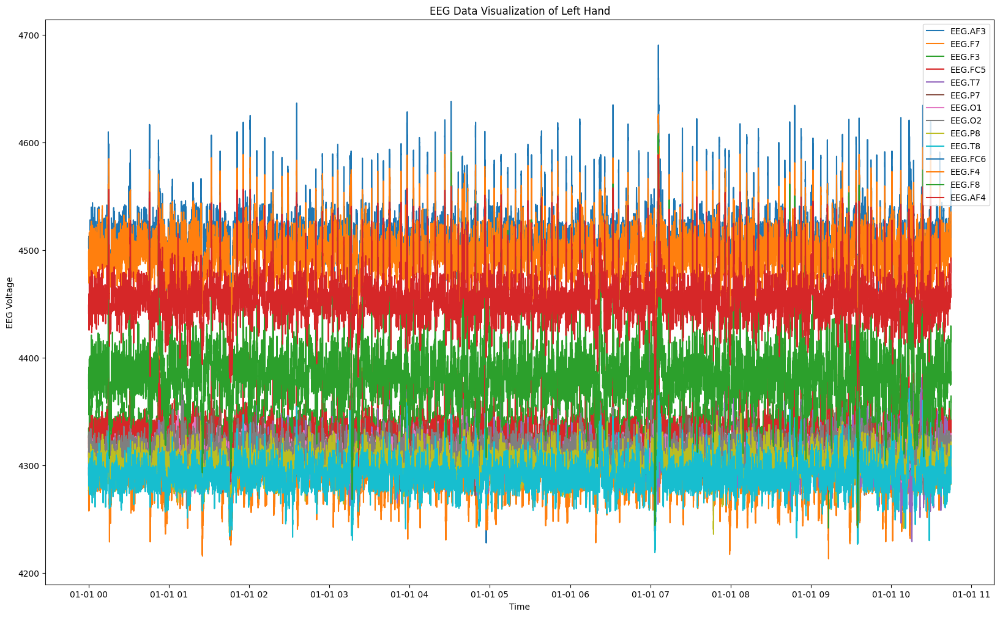

In [17]:
# Extract EEG channels data
eeg_channels = data_lh.loc[:, 'EEG.AF3':'EEG.AF4']

# Extract timestamps
timestamps = pd.to_datetime(data_lh.index, unit='s')

# Plot EEG channels over time
plt.figure(figsize=(20, 12))
for column in eeg_channels.columns:
    plt.plot(timestamps, eeg_channels[column], label=column)
plt.xlabel('Time')
plt.ylabel('EEG Voltage')
plt.title('EEG Data Visualization of Left Hand')
plt.legend()
plt.gcf()
plt.savefig('lh_plot.png')
plt.show()

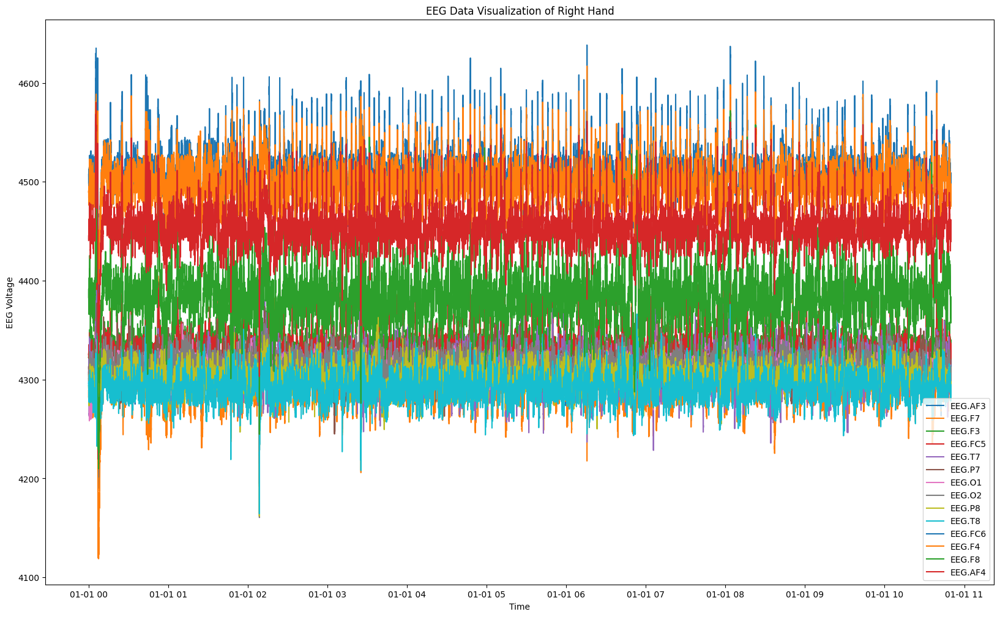

In [18]:


# Extract EEG channels data
eeg_channels1 = data_rh.loc[:, 'EEG.AF3':'EEG.AF4']

# Extract timestamps
timestamps1 = pd.to_datetime(data_rh.index, unit='s')

# Plot EEG channels over time
plt.figure(figsize=(20, 12))
for column in eeg_channels1.columns:
    plt.plot(timestamps1, eeg_channels1[column], label=column)
plt.xlabel('Time')
plt.ylabel('EEG Voltage')
plt.title('EEG Data Visualization of Right Hand')
plt.legend()
plt.gcf()
plt.savefig('rh_plot.png')
plt.show()


In [19]:
plt.savefig('rh_plot.png')

<Figure size 640x480 with 0 Axes>

## Data Filtration 

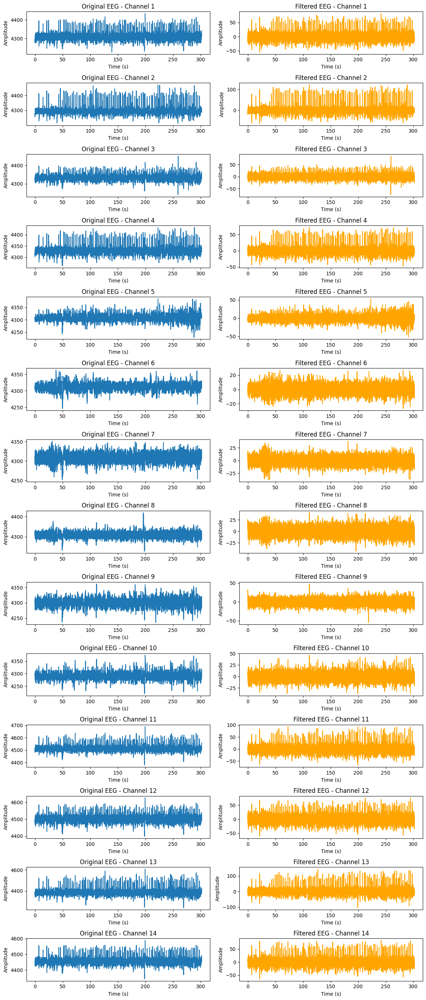

In [20]:
#LEFT HAND
# Load EEG data from the dataset (replace 'your_dataset.csv' with the actual filename)
eeg_df = data_lh

# Extract EEG data from the DataFrame (assuming EEG channels start from column 'EEG.AF3' to 'POW.AF4.Gamma')
eeg_data = eeg_df.iloc[:, 4:18].values  # Assuming EEG data starts from column index 4

# Extract timestamps from the DataFrame
timestamps = eeg_df['Timestamp'].values

# Define band-pass filter parameters
low_freq = 1  # Low cutoff frequency (Hz)
high_freq = 30  # High cutoff frequency (Hz)
sample_rate = 128  # Sampling rate (Hz)
order = 4  # Filter order

# Function to apply band-pass filter to EEG data
def bandpass_filter(eeg_data, lowcut, highcut, fs, order=4):
    nyquist_freq = 0.5 * fs
    low = lowcut / nyquist_freq
    high = highcut / nyquist_freq
    b, a = butter(order, [low, high], btype='band')
    filtered_data = filtfilt(b, a, eeg_data, axis=0)
    return filtered_data

# Apply band-pass filter to EEG data
filtered_eeg_data = bandpass_filter(eeg_data, low_freq, high_freq, sample_rate, order)

# Plot original and filtered EEG data for inspection
def plot_filtered_eeg(original_data, filtered_data, timestamps, sample_rate=128):
    time_axis = (timestamps - timestamps[0])  # Convert timestamps to relative time in seconds

    num_channels = original_data.shape[1]
    fig, ax = plt.subplots(num_channels, 2, figsize=(12, 2*num_channels))
    for i in range(num_channels):
        ax[i, 0].plot(time_axis, original_data[:, i])
        ax[i, 0].set_title(f'Original EEG - Channel {i+1}')
        ax[i, 0].set_xlabel('Time (s)')
        ax[i, 0].set_ylabel('Amplitude')
        
        ax[i, 1].plot(time_axis, filtered_data[:, i], color='orange')
        ax[i, 1].set_title(f'Filtered EEG - Channel {i+1}')
        ax[i, 1].set_xlabel('Time (s)')
        ax[i, 1].set_ylabel('Amplitude')

    plt.tight_layout()
    plt.show()

# Call the function to plot original and filtered EEG data
plot_filtered_eeg(eeg_data, filtered_eeg_data, timestamps)


## Data Artifacts Removal

Creating RawArray with float64 data, n_channels=14, n_times=38688
    Range : 0 ... 38687 =      0.000 ...   302.242 secs
Ready.
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 423 samples (3.305 s)

Fitting ICA to data using 14 channels (please be patient, this may take a while)
Selecting by number: 2 components
Fitting ICA took 0.0s.
Applying ICA to Raw instance
    Transforming to ICA space (2 components)
    Zeroing out 2 ICA components
    Projecting back using 14 PCA components


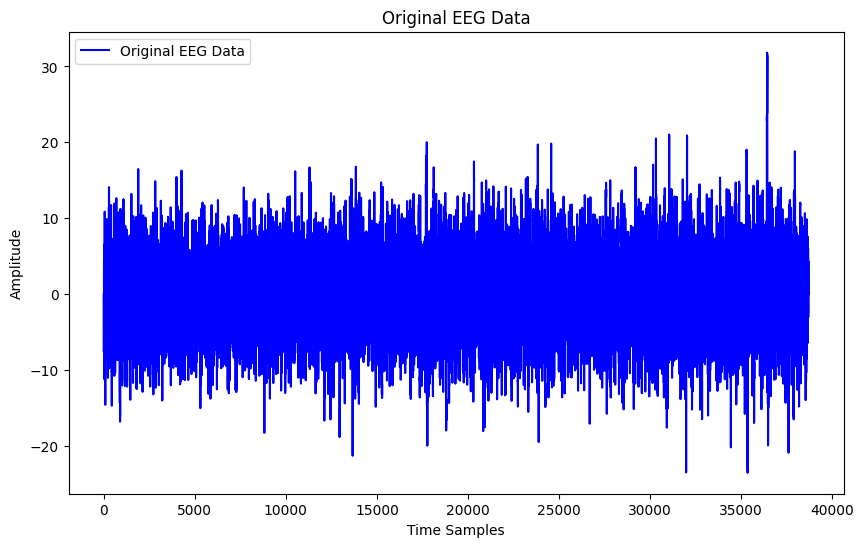

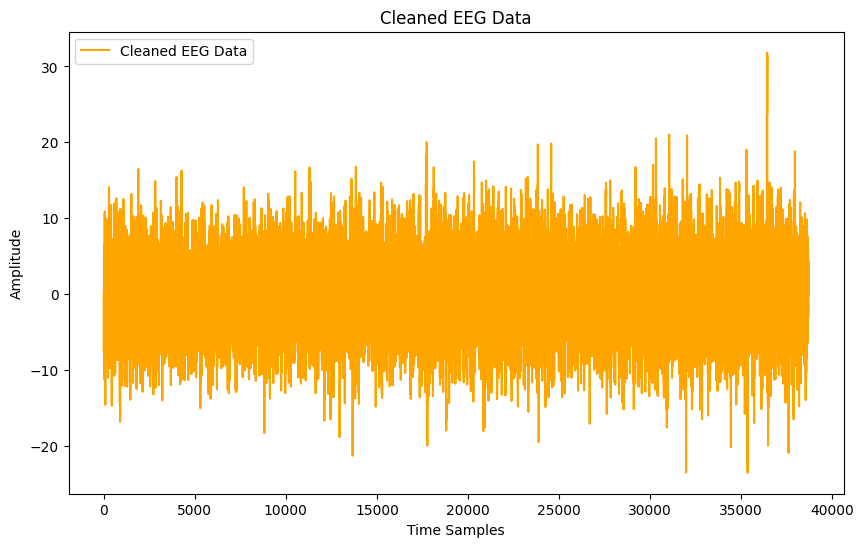

In [21]:
import pandas as pd
import numpy as np
import mne
from sklearn.decomposition import FastICA
import matplotlib.pyplot as plt

# Load EEG data from the CSV file
eeg_df = data_lh

# Extract EEG data columns (assuming EEG channels start from the 5th column)
eeg_data = eeg_df.iloc[:, 4:18].values

# Extract channel names
ch_names = eeg_df.columns[4:18].tolist()

# Create MNE Info object
info = mne.create_info(ch_names=ch_names, sfreq=128, ch_types='eeg')

# Transpose EEG data (rows as channels, columns as samples)
eeg_data = eeg_data.T

# Create MNE Raw object
raw_lh = mne.io.RawArray(eeg_data, info)

# Apply high-pass filter at 1 Hz
raw_lh.filter(l_freq=1, h_freq=None)

# Apply Independent Component Analysis (ICA) for artifact removal
n_components = 0.999999  # Set a threshold closer to 1
ica = mne.preprocessing.ICA(n_components=2, random_state=42)
ica.fit(raw_lh)

# ica = mne.preprocessing.ICA(n_components=5, random_state=42)
# ica.fit(raw)

# Identify components representing artifacts based on visual inspection
# Exclude artifact-related components from the data
ica.exclude = [0, 1, 2]  # Example: Exclude components 0, 1, and 2

# Apply ICA to Raw instance and obtain cleaned data
cleaned_eeg_data = ica.apply(raw_lh)

# Plot original and cleaned EEG data for inspection
# Plot original EEG data
plt.figure(figsize=(10, 6))
plt.plot(raw_lh._data[0, :],color='blue', label='Original EEG Data')
plt.xlabel('Time Samples')
plt.ylabel('Amplitude')
plt.title('Original EEG Data')
plt.legend()
plt.show()

# Plot cleaned EEG data
plt.figure(figsize=(10, 6))
plt.plot(cleaned_eeg_data._data[0, :],color='orange', label='Cleaned EEG Data')
plt.xlabel('Time Samples')
plt.ylabel('Amplitude')
plt.title('Cleaned EEG Data')
plt.legend()
plt.show()

# Save cleaned EEG data to CSV file
cleaned_eeg_df = pd.DataFrame(cleaned_eeg_data._data.T, columns=ch_names)
cleaned_eeg_df.to_csv('cleaned_data_lh.csv', index=False)


In [22]:
# Assuming 'raw' contains your loaded EEG data
duration = 5  # Duration of each epoch in seconds

# Define the start and end times for each epoch
start_times = np.arange(0, raw_lh.times[-1] - duration, duration)  # Adjusted to prevent exceeding max time
end_times = start_times + duration

# Create empty list to store epoch objects
epochs_lh = []

# Iterate over each epoch and extract the data
for start, end in zip(start_times, end_times):
    epoch = raw_lh.copy().crop(tmin=start, tmax=end)
    epochs_lh.append(epoch)

# Now 'epochs' is a list containing individual epoch objects
# You can further process or analyze each epoch as needed


In [23]:
print("Number of epochs:", len(epochs_lh))

Number of epochs: 60


In [24]:
# Define baseline start and end (in seconds)
baseline_start = -0.2
baseline_end = 0

# Get the sampling frequency from the first epoch
sfreq = epochs_lh[0].info['sfreq']

# Convert baseline start and end from seconds to samples
baseline_start_idx = int(baseline_start * sfreq)
baseline_end_idx = int(baseline_end * sfreq)

# Ensure baseline indices are within the range of epoch data
baseline_start_idx = max(0, baseline_start_idx)
baseline_end_idx = min(epochs_lh[0].get_data().shape[1], baseline_end_idx)

# Compute baseline correction for each epoch
baseline_corrected_epochs_lh = []
for epoch in epochs_lh:
    # Extract epoch data
    epoch_data = epoch.get_data()
    
    # Check if baseline indices are valid
    if baseline_start_idx < baseline_end_idx:
        # Compute baseline correction (mean or median) along the time dimension
        baseline_values = np.mean(epoch_data[:, baseline_start_idx:baseline_end_idx], axis=1)
        # Or, if you prefer median:
        # baseline_values = np.median(epoch_data[:, baseline_start_idx:baseline_end_idx], axis=1)
        
        # Apply baseline correction
        baseline_corrected_epoch = epoch_data - baseline_values[:, np.newaxis]
    else:
        # If baseline indices are invalid, set baseline-corrected epoch to original epoch data
        baseline_corrected_epoch = epoch_data
    
    baseline_corrected_epochs_lh.append(baseline_corrected_epoch)

# baseline_corrected_epochs is now a list containing the baseline-corrected data for each epoch


In [25]:
for i, baseline_corrected_epoch in enumerate(baseline_corrected_epochs_lh):
    print(f"Epoch {i+1}: Shape = {baseline_corrected_epoch.shape}")


Epoch 1: Shape = (14, 641)
Epoch 2: Shape = (14, 641)
Epoch 3: Shape = (14, 641)
Epoch 4: Shape = (14, 641)
Epoch 5: Shape = (14, 641)
Epoch 6: Shape = (14, 641)
Epoch 7: Shape = (14, 641)
Epoch 8: Shape = (14, 641)
Epoch 9: Shape = (14, 641)
Epoch 10: Shape = (14, 641)
Epoch 11: Shape = (14, 641)
Epoch 12: Shape = (14, 641)
Epoch 13: Shape = (14, 641)
Epoch 14: Shape = (14, 641)
Epoch 15: Shape = (14, 641)
Epoch 16: Shape = (14, 641)
Epoch 17: Shape = (14, 641)
Epoch 18: Shape = (14, 641)
Epoch 19: Shape = (14, 641)
Epoch 20: Shape = (14, 641)
Epoch 21: Shape = (14, 641)
Epoch 22: Shape = (14, 641)
Epoch 23: Shape = (14, 641)
Epoch 24: Shape = (14, 641)
Epoch 25: Shape = (14, 641)
Epoch 26: Shape = (14, 641)
Epoch 27: Shape = (14, 641)
Epoch 28: Shape = (14, 641)
Epoch 29: Shape = (14, 641)
Epoch 30: Shape = (14, 641)
Epoch 31: Shape = (14, 641)
Epoch 32: Shape = (14, 641)
Epoch 33: Shape = (14, 641)
Epoch 34: Shape = (14, 641)
Epoch 35: Shape = (14, 641)
Epoch 36: Shape = (14, 641)
E

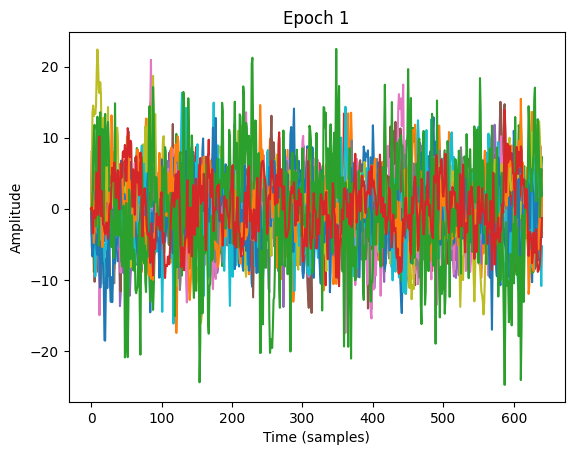

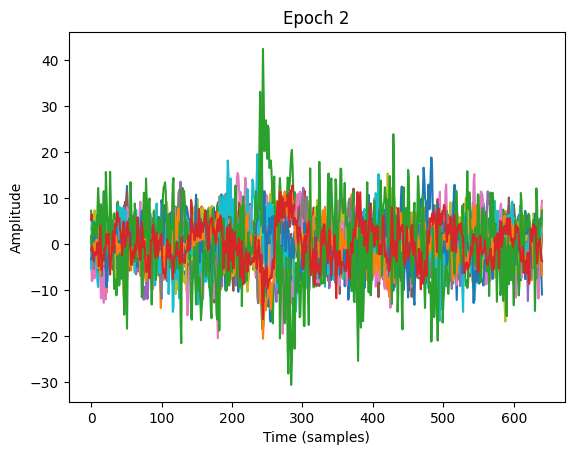

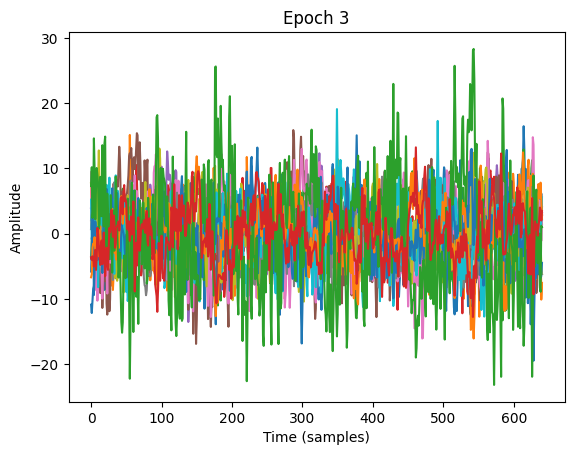

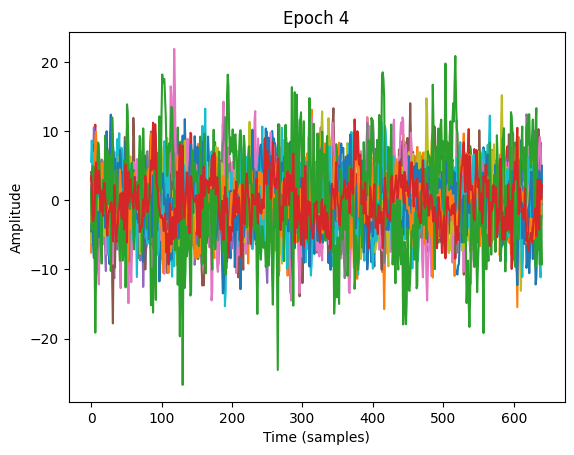

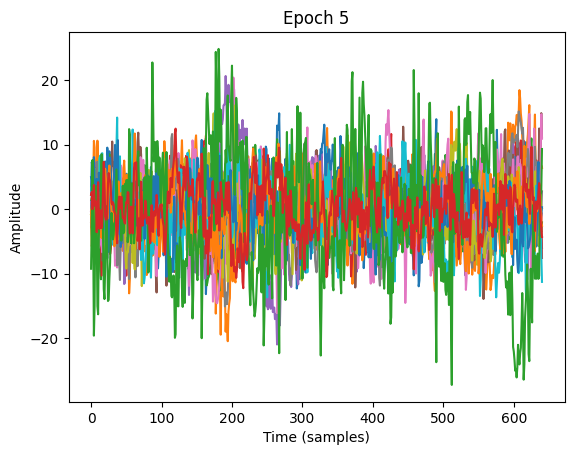

...

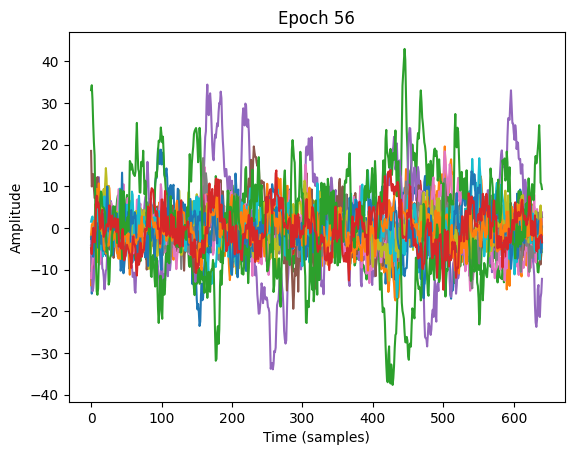

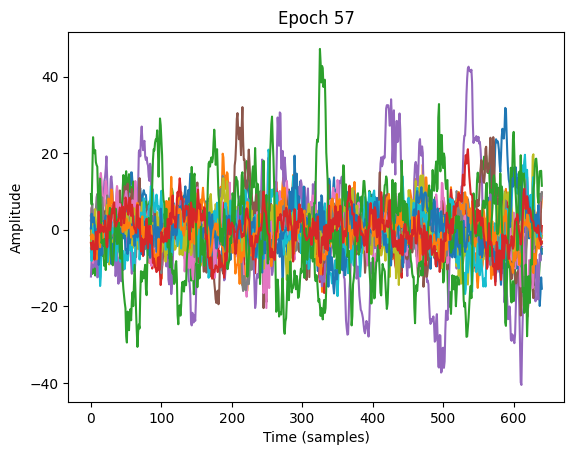

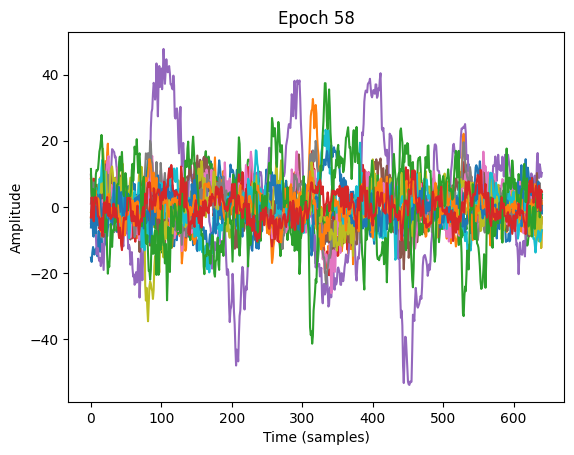

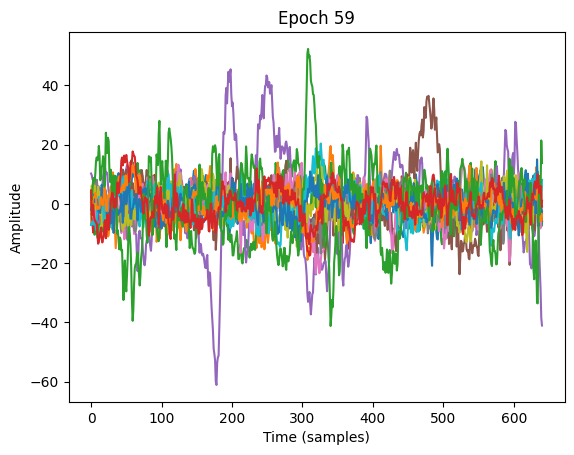

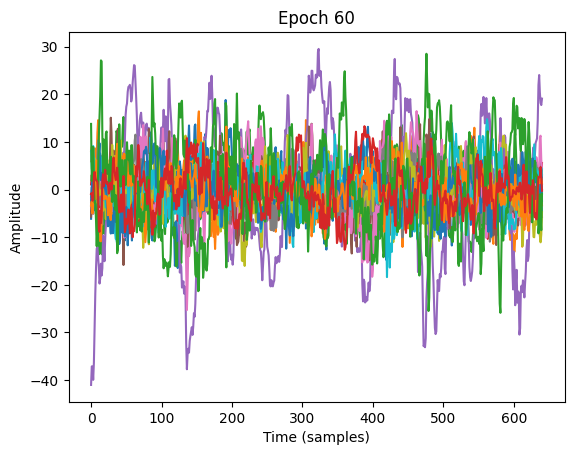

In [26]:
# # Define thresholds for amplitude and variance
# amplitude_threshold = 100  # Adjust according to your data
# variance_threshold = 50    # Adjust according to your data

# # Initialize an empty list to store clean epochs
# clean_epochs = []

# # Iterate over each epoch and apply threshold-based rejection
# for epoch in baseline_corrected_epochs:
#     if np.max(np.abs(epoch)) < amplitude_threshold and np.var(epoch) < variance_threshold:
#         clean_epochs.append(epoch)

# # Convert the list of clean epochs to a numpy array
# clean_epochs = np.array(clean_epochs)

# # Print the number of remaining clean epochs
# print("Number of clean epochs after threshold-based rejection:", len(clean_epochs))
# Define thresholds for amplitude and variance
amplitude_threshold = 50  # Adjust according to your data
variance_threshold = 20    # Adjust according to your data

# Initialize an empty list to store clean epochs
clean_epochs = []

# Iterate over each epoch and apply threshold-based rejection
for epoch in baseline_corrected_epochs_lh:
    if np.max(np.abs(epoch)) < amplitude_threshold and np.var(epoch) < variance_threshold:
        clean_epochs.append(epoch)

# Convert the list of clean epochs to a numpy array
clean_epochs = np.array(clean_epochs)

# Print the number of remaining clean epochs
# print("Number of clean epochs after threshold-based rejection:", len(clean_epochs))


# Visualize individual epochs for manual inspection
for idx, epoch in enumerate(baseline_corrected_epochs_lh):
    plt.figure()
    plt.plot(epoch.T)
    plt.title(f"Epoch {idx+1}")
    plt.xlabel("Time (samples)")
    plt.ylabel("Amplitude")
    plt.show()


/Users/saiyarlagadda/.pyenv/versions/3.12.0/lib/python3.12/site-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'Series.swapaxes' is deprecated and will be removed in a future version. Please use 'Series.transpose' instead.
  return bound(*args, **kwds)


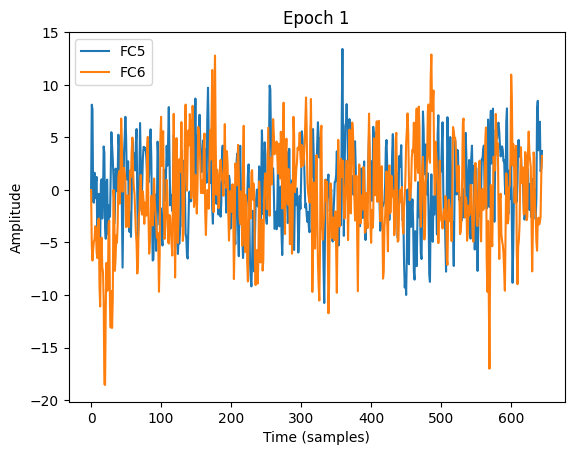

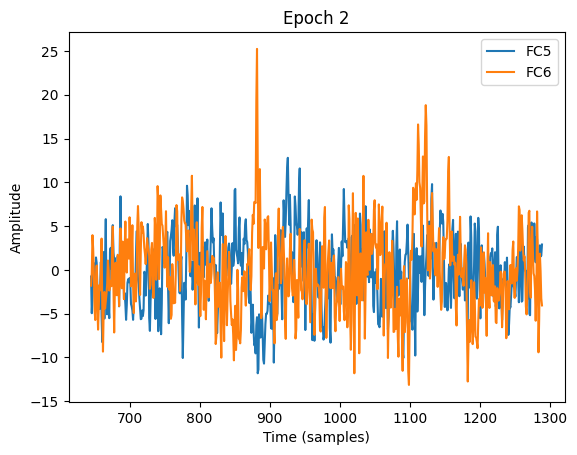

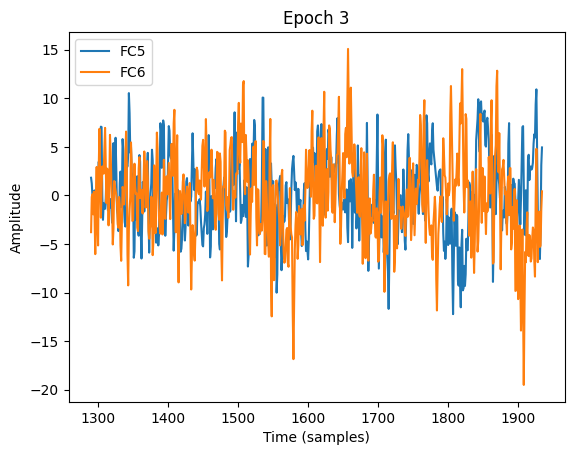

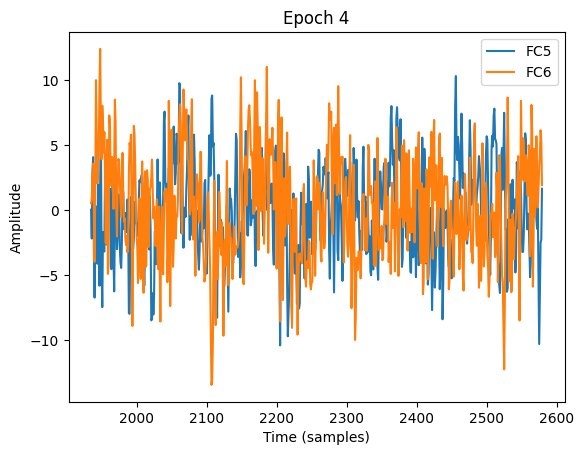

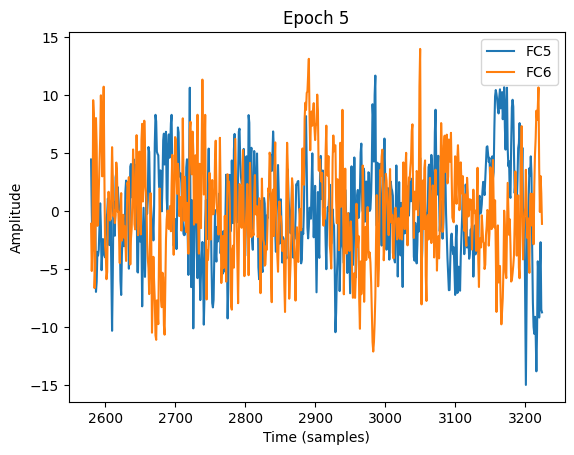

...

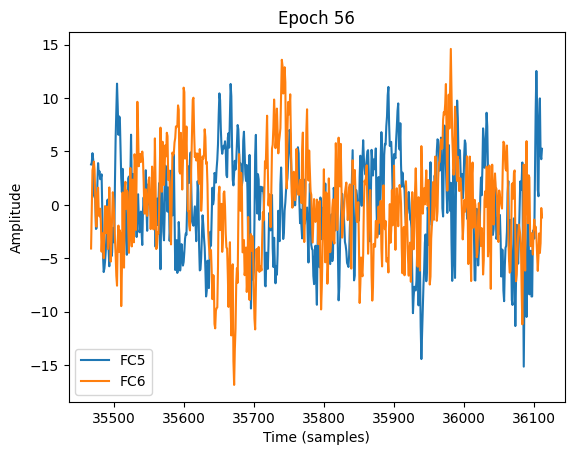

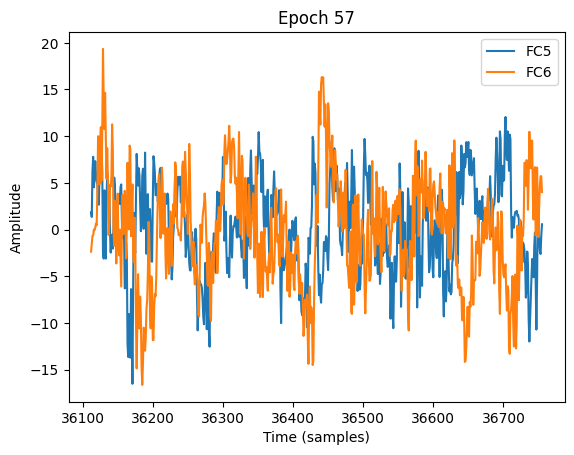

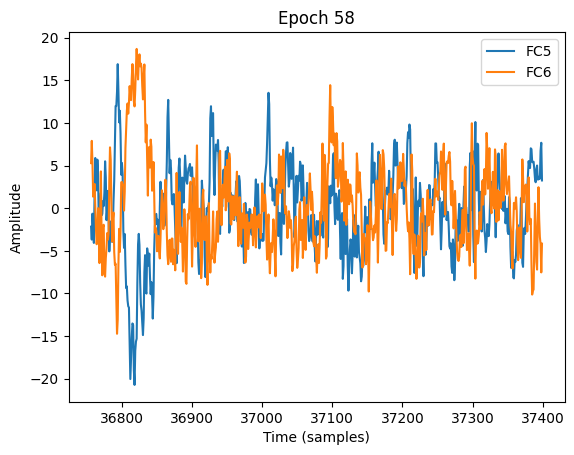

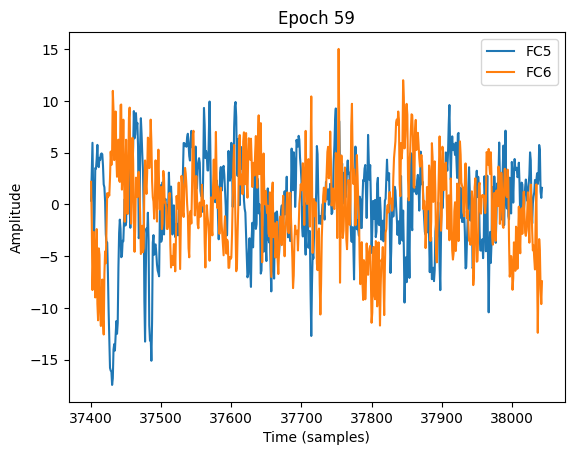

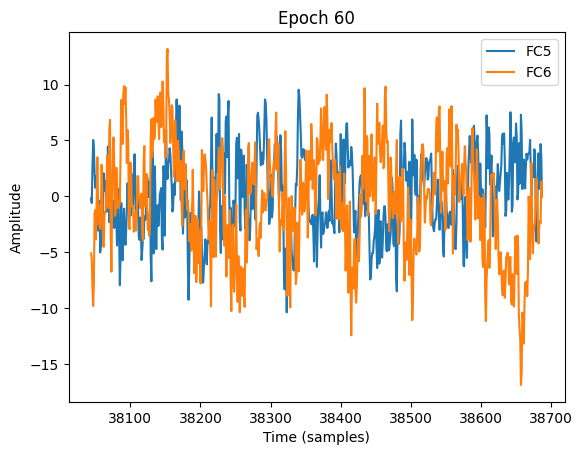

In [27]:
# Sample sampling rate (250 Hz)
sampling_rate = 128

# Function to epoch the data based on a specified duration (in seconds)
def epoch_data(data, duration_seconds):
    num_samples_per_epoch = int(duration_seconds * sampling_rate)
    num_epochs = len(data) // num_samples_per_epoch
    epochs = np.array_split(data, num_epochs)
    return epochs

# Specify the duration of each epoch in seconds
epoch_duration_seconds = 5

# Epoch the 'FC5' and 'FC6' data
epochs_fc5 = epoch_data(data_lh['EEG.FC5'], epoch_duration_seconds)
epochs_fc6 = epoch_data(data_lh['EEG.FC6'], epoch_duration_seconds)

# Visualize the epochs
for idx, (epoch_fc5, epoch_fc6) in enumerate(zip(epochs_fc5, epochs_fc6)):
    plt.figure()
    plt.plot(epoch_fc5, label='FC5')
    plt.plot(epoch_fc6, label='FC6')
    plt.title(f"Epoch {idx+1}")
    plt.xlabel("Time (samples)")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.show()


## Feature Extraction

In [28]:
# Feature Extraction
!pip install PyWavelets

In [29]:


# Define parameters for wavelet transform
wavelet = 'db2'  # Choose a discrete wavelet, e.g., Daubechies 2
level = 4  # Choose the level of decomposition
mode = 'zero'  # Choose the extension mode for wavelet decomposition
axis = -1  # Choose the axis along which to apply wavelet transform

# Function to compute wavelet coefficients for each epoch
def compute_wavelet_coefficients(epoch_data, wavelet, level, mode, axis):
    coefficients = pywt.wavedec(epoch_data, wavelet, level=level, mode=mode, axis=axis)
    return coefficients

# Perform wavelet transform for each epoch
wavelet_coefficients_lh = []
max_epoch_length = 0
for epoch_data in baseline_corrected_epochs_lh:
    epoch_coefficients = compute_wavelet_coefficients(epoch_data, wavelet, level, mode, axis)
    wavelet_coefficients_lh.append(epoch_coefficients)
    # Update the maximum length of epochs
    max_epoch_length = max(max_epoch_length, epoch_data.shape[1])

# Pad or truncate each epoch to the length of the longest epoch
padded_wavelet_coefficients = []
for epoch_coeffs in wavelet_coefficients_lh:
    padded_epoch_coeffs = [np.pad(coef, ((0, 0), (0, max_epoch_length - coef.shape[1])), mode='constant') for coef in epoch_coeffs]
    padded_wavelet_coefficients.append(padded_epoch_coeffs)

# Convert the list of padded wavelet coefficients to a numpy array
wavelet_coefficients_array_lh = np.array(padded_wavelet_coefficients)

# Now 'wavelet_coefficients_array' contains the wavelet coefficients for each epoch,
# with each epoch padded or truncated to the length of the longest epoch


In [30]:
print("Shape of wavelet coefficients array:", wavelet_coefficients_array_lh.shape)


Shape of wavelet coefficients array: (60, 5, 14, 641)


## Temporal Analysis

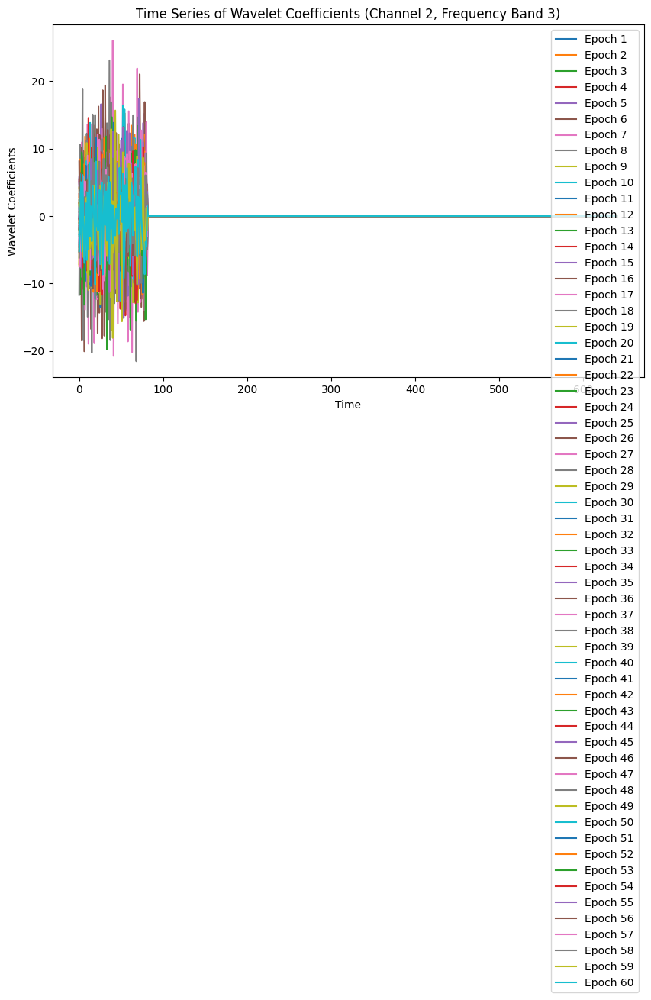

In [31]:


# Select a specific channel and frequency band for analysis
channel_index = 1  # Index of the channel (e.g., 0 for the first channel)
frequency_band_index = 2  # Index of the frequency band (e.g., 0 for the first frequency band)

# Extract wavelet coefficients for the selected channel and frequency band
wavelet_coefficients_channel_band = wavelet_coefficients_array_lh[:, frequency_band_index, channel_index, :]

# Plot the time series of wavelet coefficients
plt.figure(figsize=(10, 6))
for epoch_index in range(wavelet_coefficients_channel_band.shape[0]):
    plt.plot(wavelet_coefficients_channel_band[epoch_index, :], label=f'Epoch {epoch_index + 1}')

plt.title(f'Time Series of Wavelet Coefficients (Channel {channel_index + 1}, Frequency Band {frequency_band_index + 1})')
plt.xlabel('Time')
plt.ylabel('Wavelet Coefficients')
plt.legend()
plt.show()


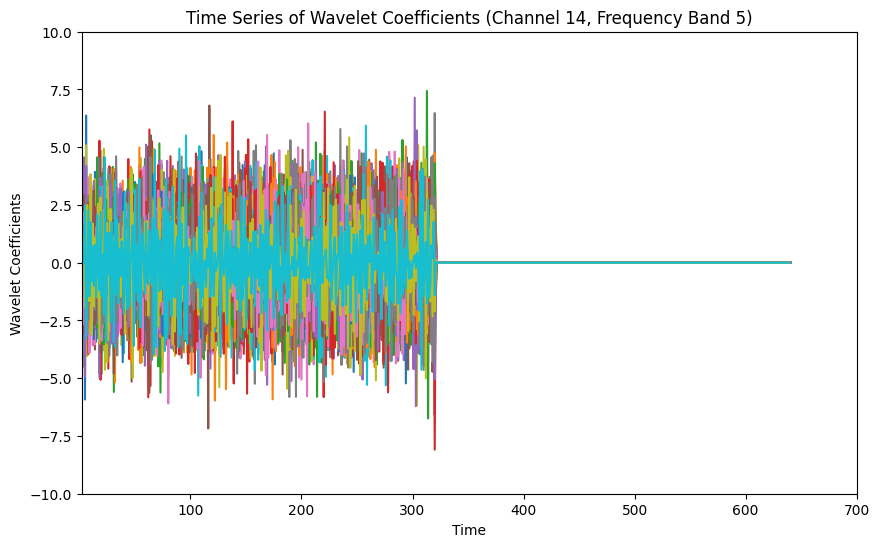

In [32]:


# Select a specific channel and frequency band for analysis
channel_index = 13  # Index of the channel (e.g., 0 for the first channel)
frequency_band_index = 4  # Index of the frequency band (e.g., 0 for the first frequency band)

# Extract wavelet coefficients for the selected channel and frequency band
wavelet_coefficients_channel_band = wavelet_coefficients_array_lh[:, frequency_band_index, channel_index, :]

# Set the range for x-axis (time range from 0 to 100)
x_min = 2
x_max = 700

# Set the range for y-axis (wavelet coefficients range from -40 to 40)
y_min = -10
y_max = 10

# Plot the time series of wavelet coefficients
plt.figure(figsize=(10, 6))
for epoch_index in range(wavelet_coefficients_channel_band.shape[0]):
    plt.plot(wavelet_coefficients_channel_band[epoch_index, :], label=f'Epoch {epoch_index + 1}')

plt.title(f'Time Series of Wavelet Coefficients (Channel {channel_index + 1}, Frequency Band {frequency_band_index + 1})')
plt.xlabel('Time')
plt.ylabel('Wavelet Coefficients')
plt.xlim(x_min, x_max)  # Set x-axis limits
plt.ylim(y_min, y_max)  # Set y-axis limits
# plt.legend()
plt.show()


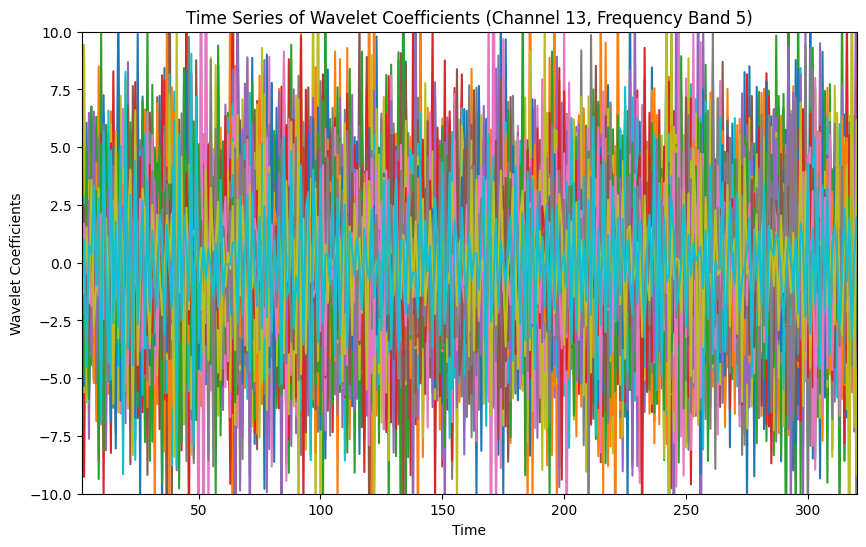

In [33]:


# Select a specific channel and frequency band for analysis
channel_index = 12  # Index of the channel (e.g., 0 for the first channel)
frequency_band_index = 4  # Index of the frequency band (e.g., 0 for the first frequency band)

# Extract wavelet coefficients for the selected channel and frequency band
wavelet_coefficients_channel_band = wavelet_coefficients_array_lh[:, frequency_band_index, channel_index, :]

# Set the range for x-axis (time range from 0 to 100)
x_min = 2
x_max = 320

# Set the range for y-axis (wavelet coefficients range from -40 to 40)
y_min = -10
y_max = 10

# Plot the time series of wavelet coefficients
plt.figure(figsize=(10, 6))
for epoch_index in range(wavelet_coefficients_channel_band.shape[0]):
    plt.plot(wavelet_coefficients_channel_band[epoch_index, :], label=f'Epoch {epoch_index + 1}')

plt.title(f'Time Series of Wavelet Coefficients (Channel {channel_index + 1}, Frequency Band {frequency_band_index + 1})')
plt.xlabel('Time')
plt.ylabel('Wavelet Coefficients')
plt.xlim(x_min, x_max)  # Set x-axis limits
plt.ylim(y_min, y_max)  # Set y-axis limits
# plt.legend()
plt.show()


Epoch 1: Shape = (5, 14, 641)


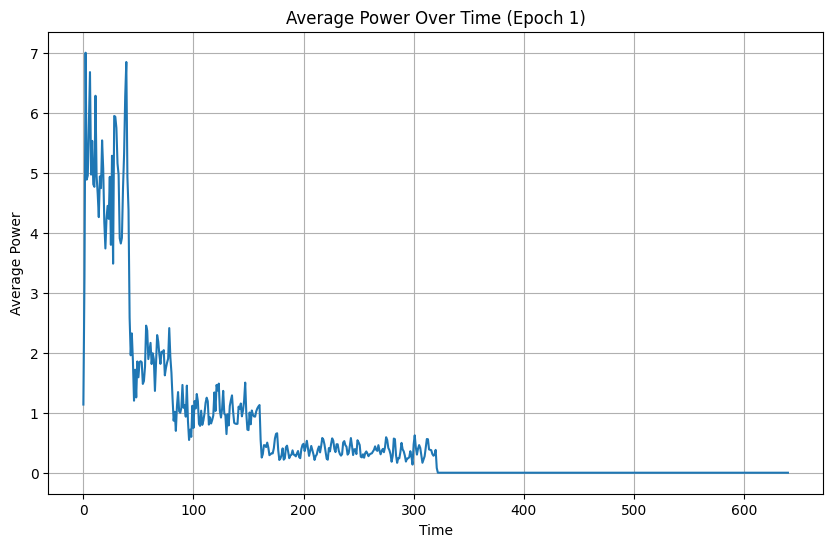

Epoch 2: Shape = (5, 14, 641)


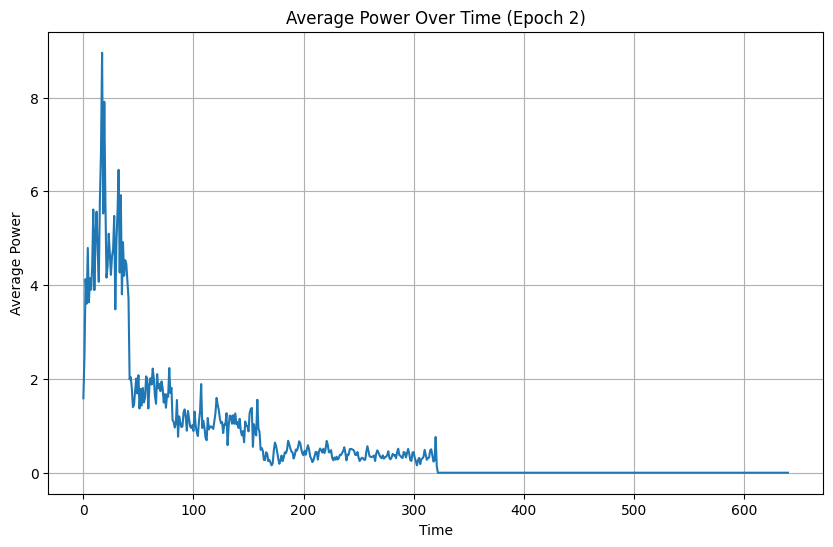

Epoch 3: Shape = (5, 14, 641)


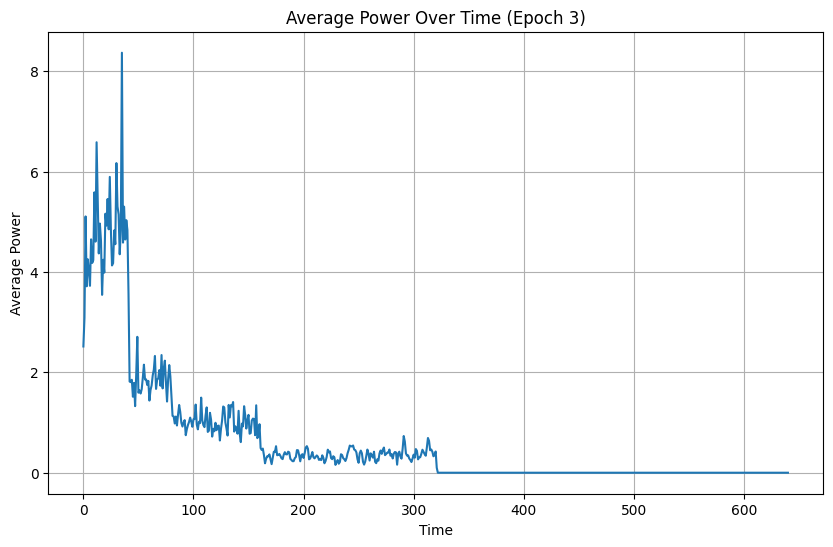

Epoch 4: Shape = (5, 14, 641)


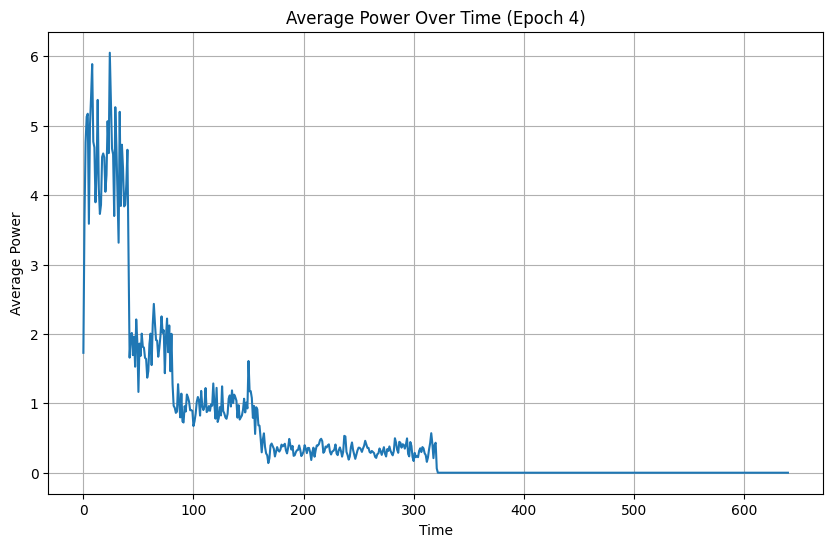

Epoch 5: Shape = (5, 14, 641)


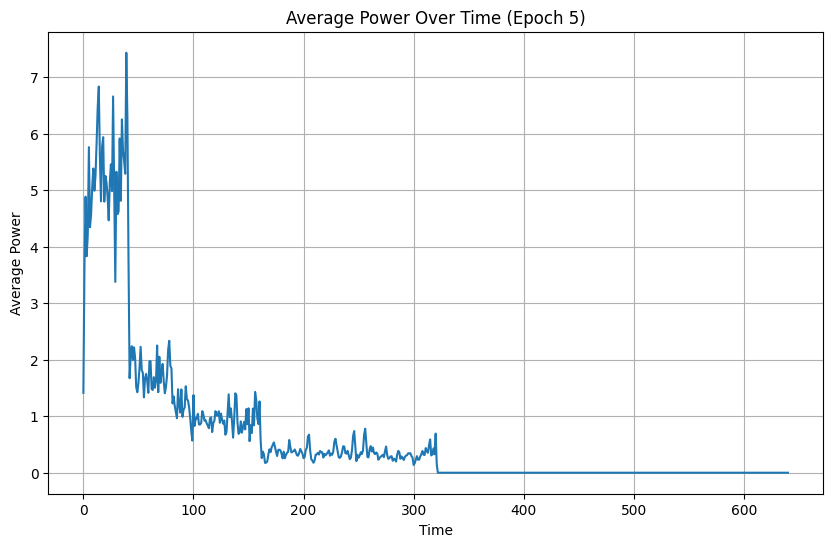

Epoch 6: Shape = (5, 14, 641)


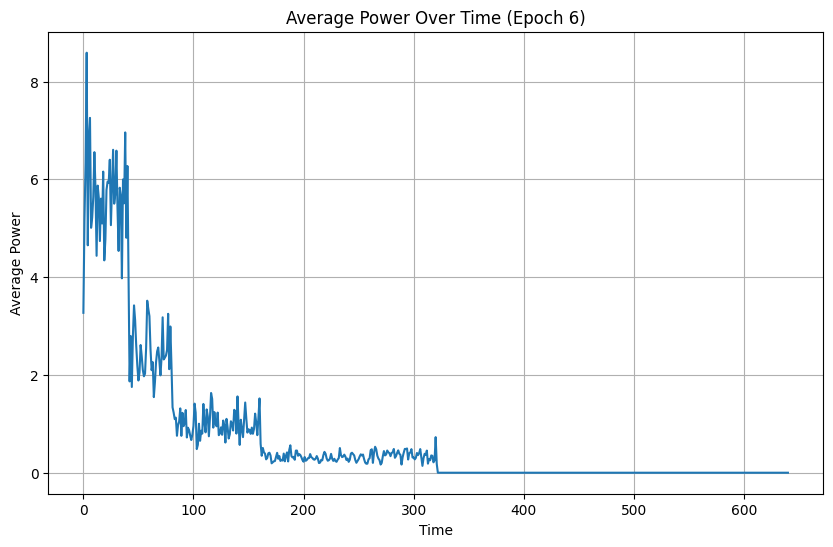

Epoch 7: Shape = (5, 14, 641)


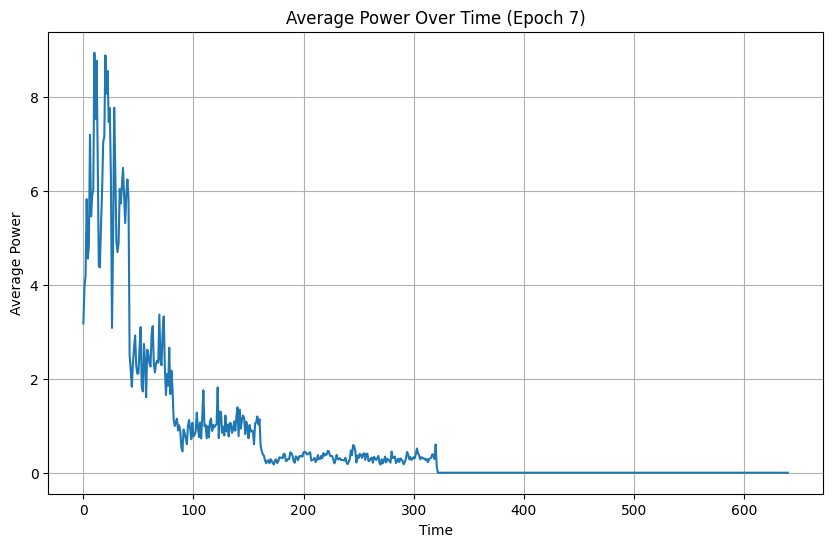

Epoch 8: Shape = (5, 14, 641)


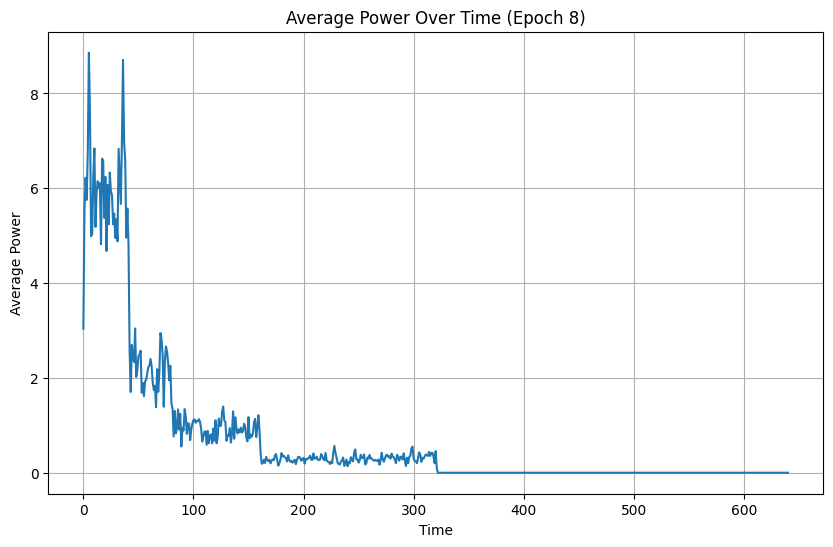

Epoch 9: Shape = (5, 14, 641)


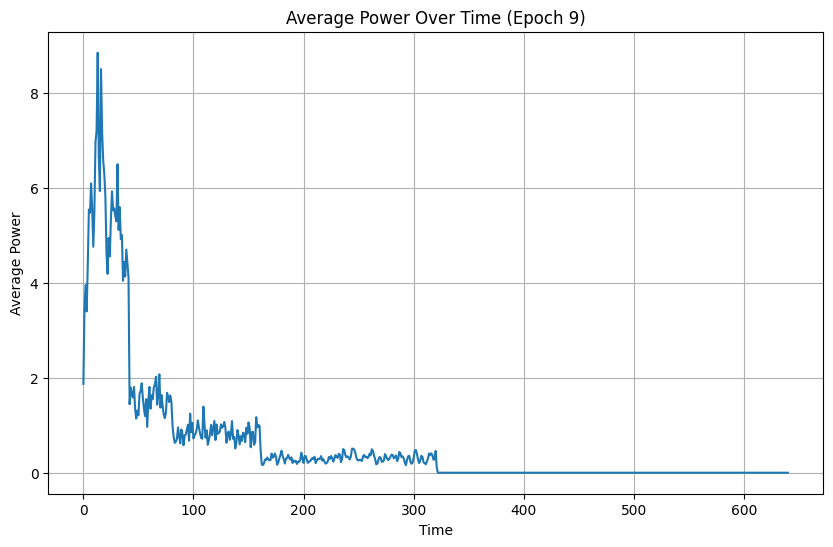

Epoch 10: Shape = (5, 14, 641)


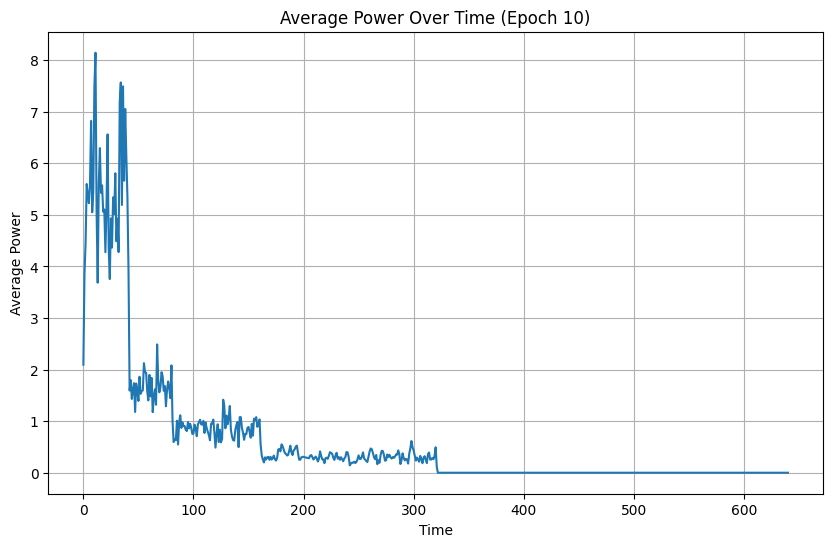

Epoch 11: Shape = (5, 14, 641)


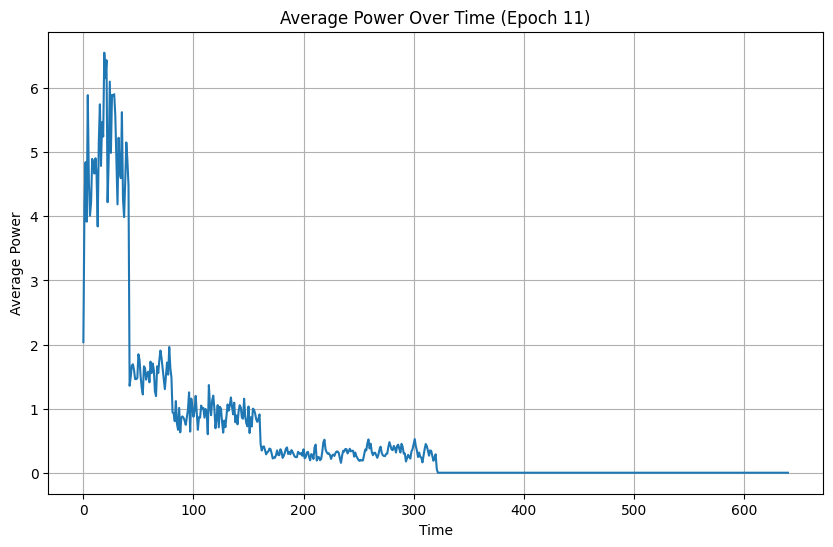

Epoch 12: Shape = (5, 14, 641)


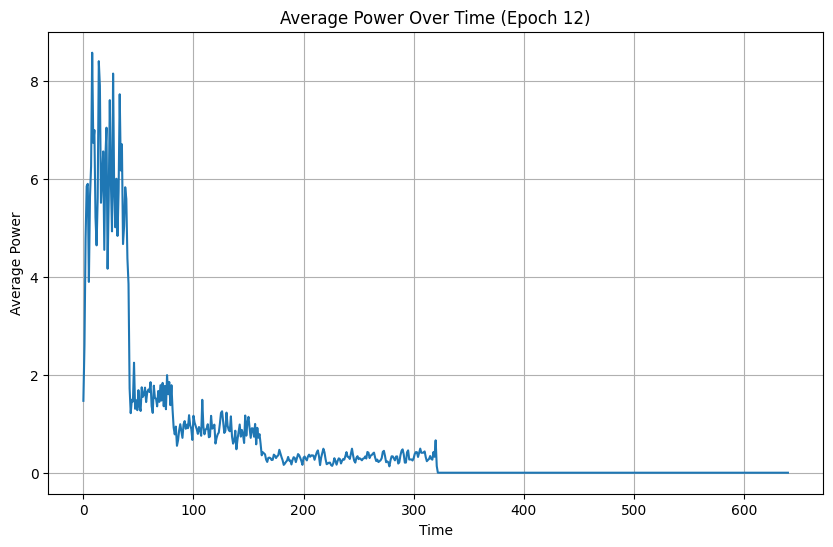

Epoch 13: Shape = (5, 14, 641)


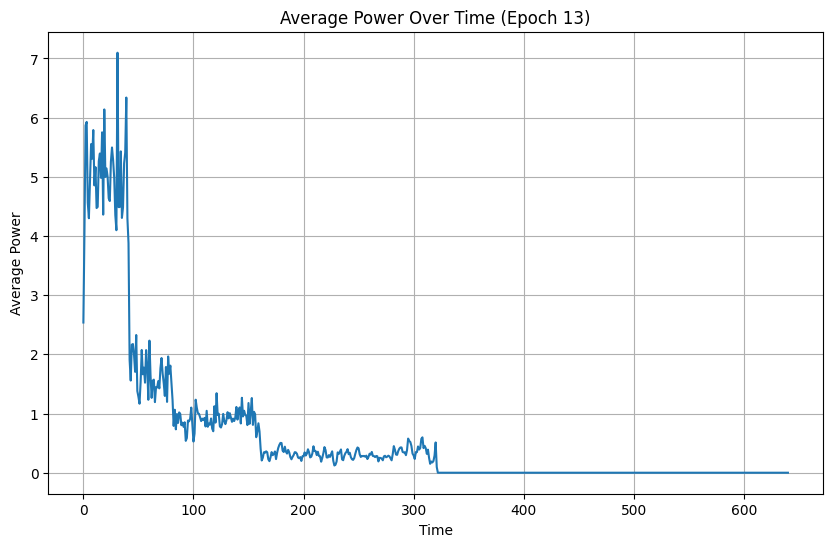

Epoch 14: Shape = (5, 14, 641)


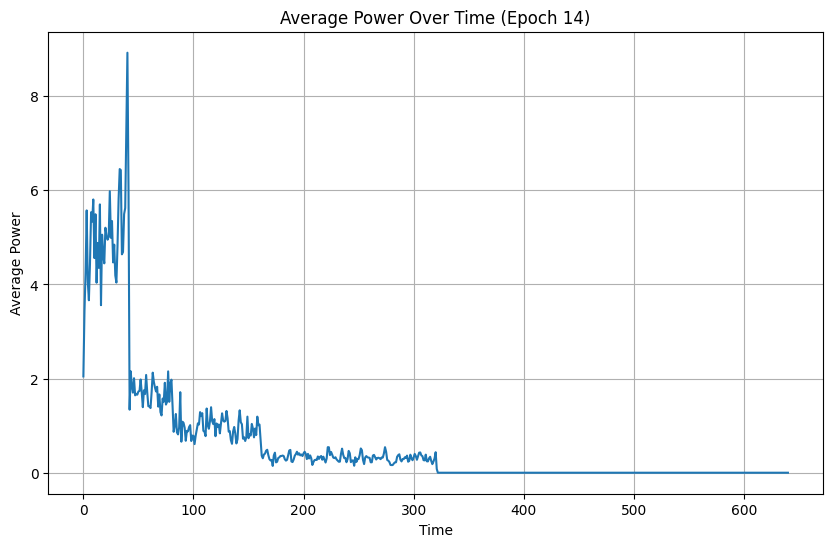

Epoch 15: Shape = (5, 14, 641)


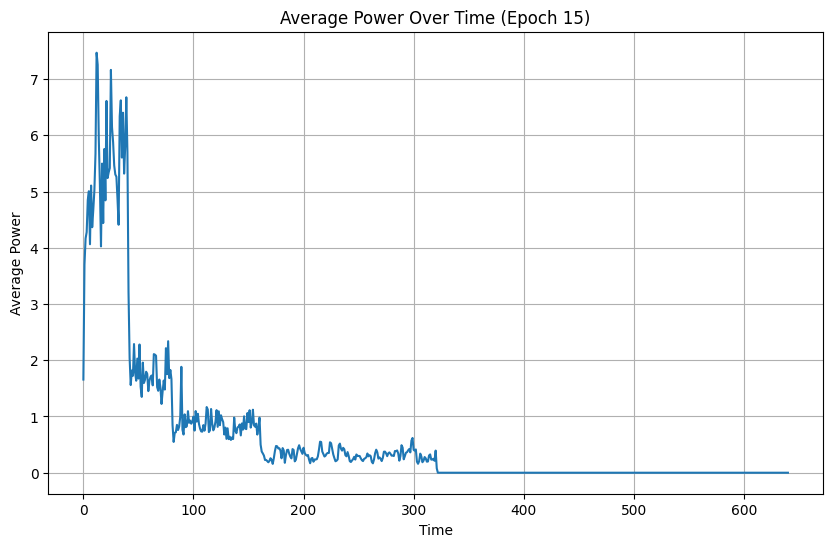

Epoch 16: Shape = (5, 14, 641)


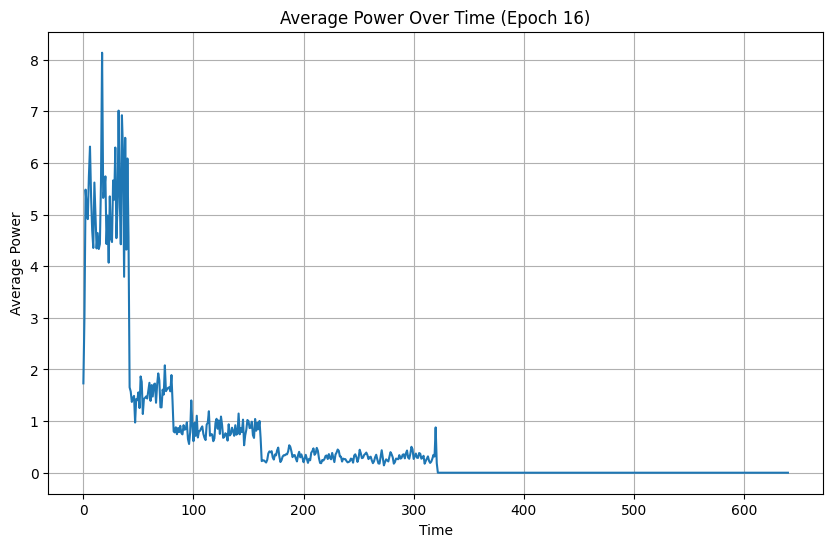

Epoch 17: Shape = (5, 14, 641)


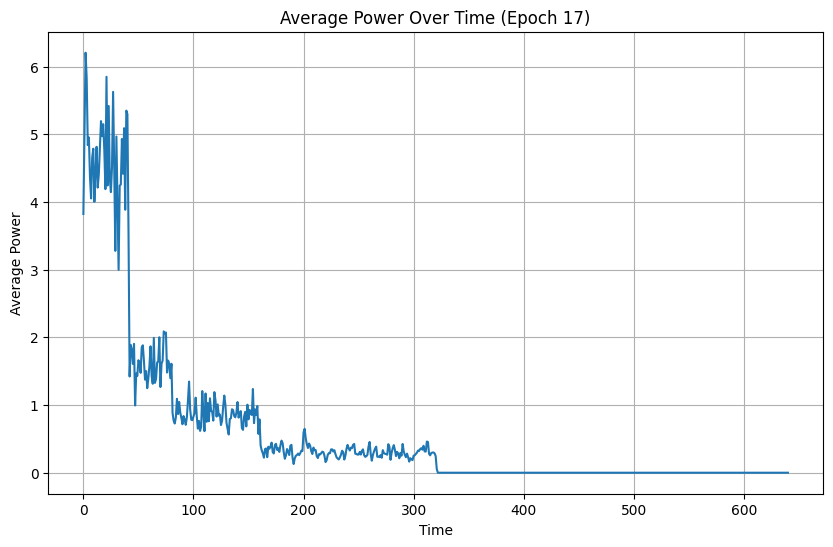

Epoch 18: Shape = (5, 14, 641)


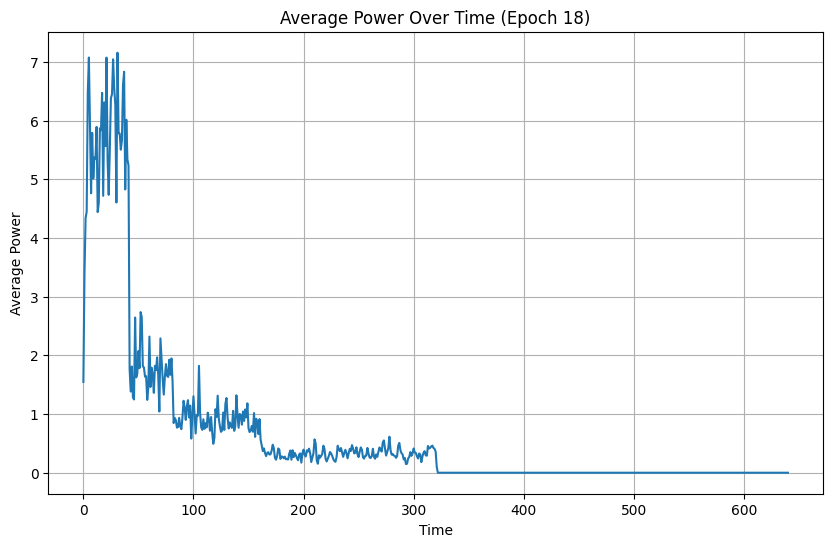

Epoch 19: Shape = (5, 14, 641)


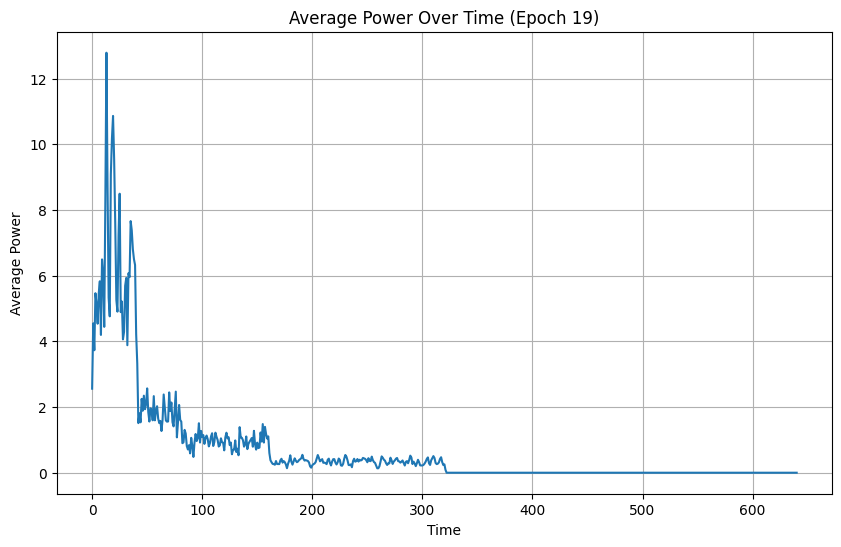

Epoch 20: Shape = (5, 14, 641)


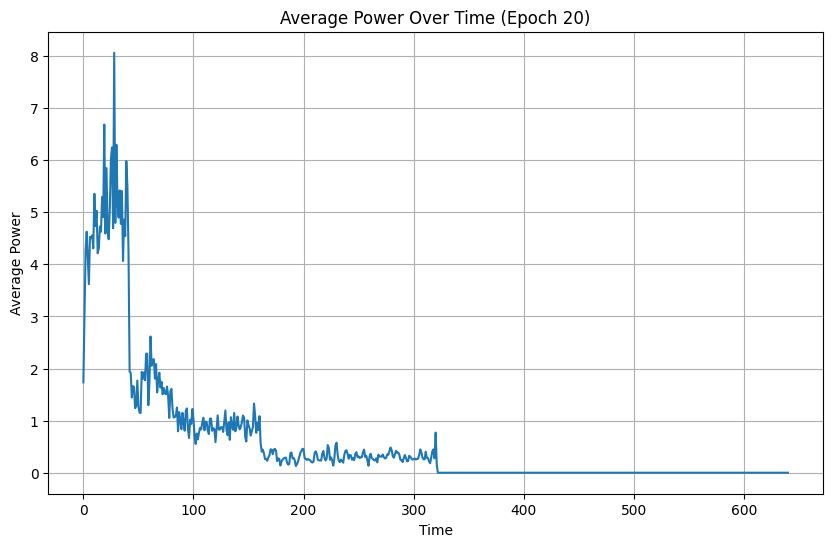

Epoch 21: Shape = (5, 14, 641)


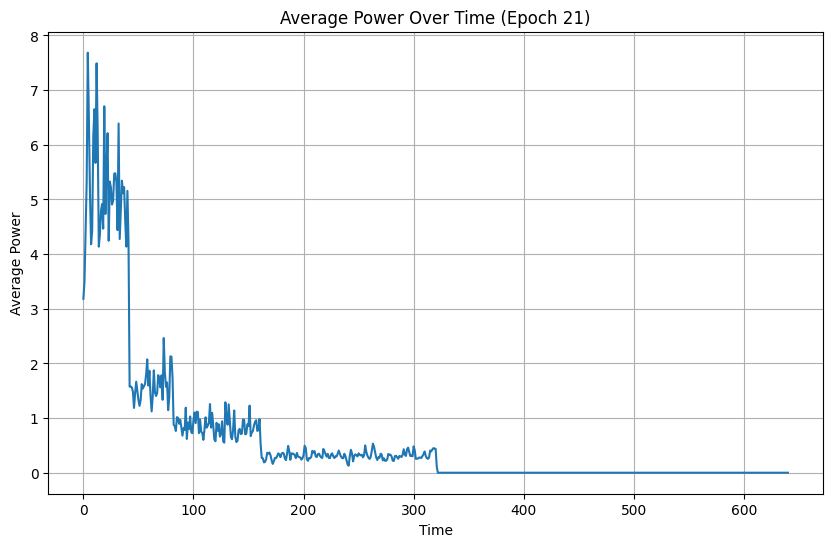

Epoch 22: Shape = (5, 14, 641)


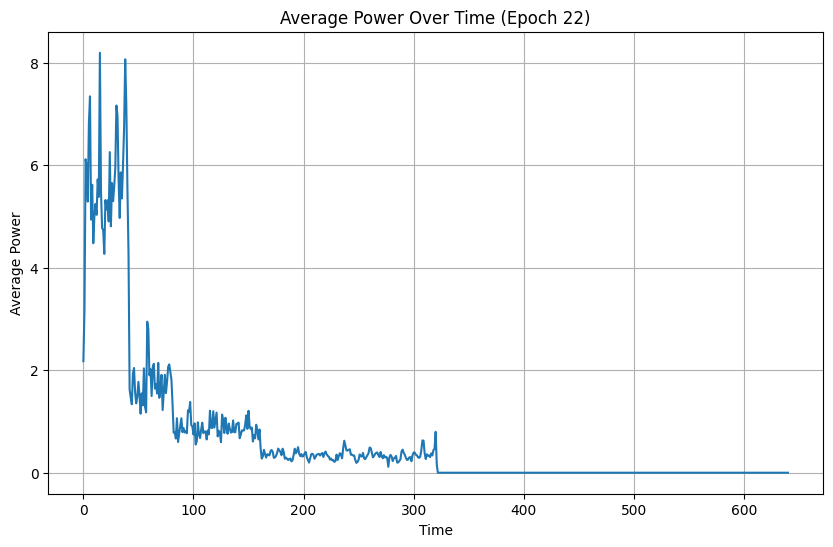

Epoch 23: Shape = (5, 14, 641)


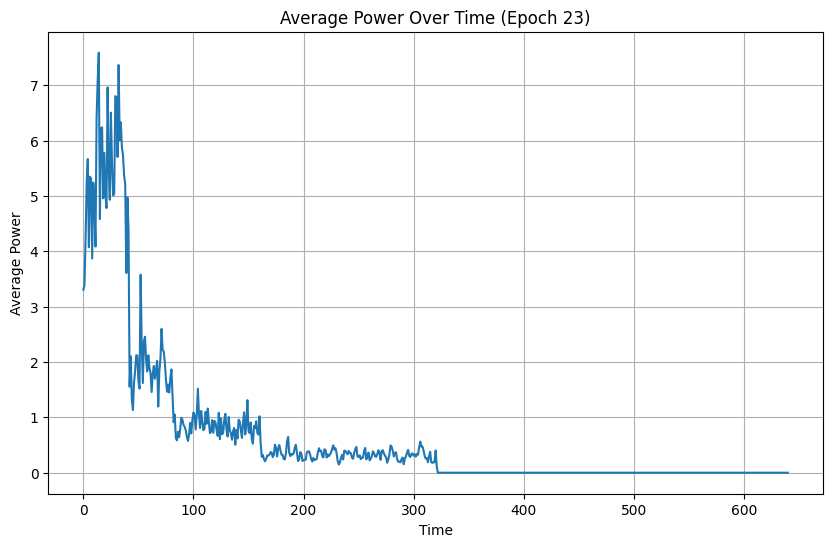

Epoch 24: Shape = (5, 14, 641)


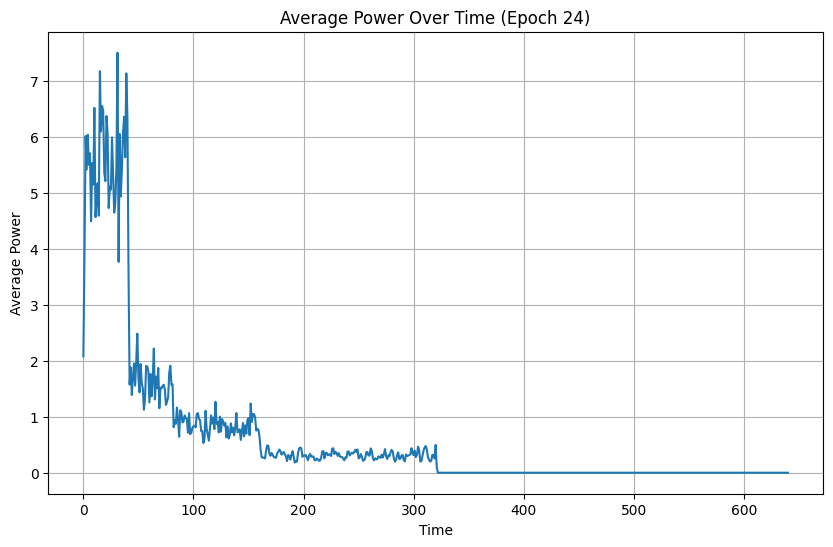

Epoch 25: Shape = (5, 14, 641)


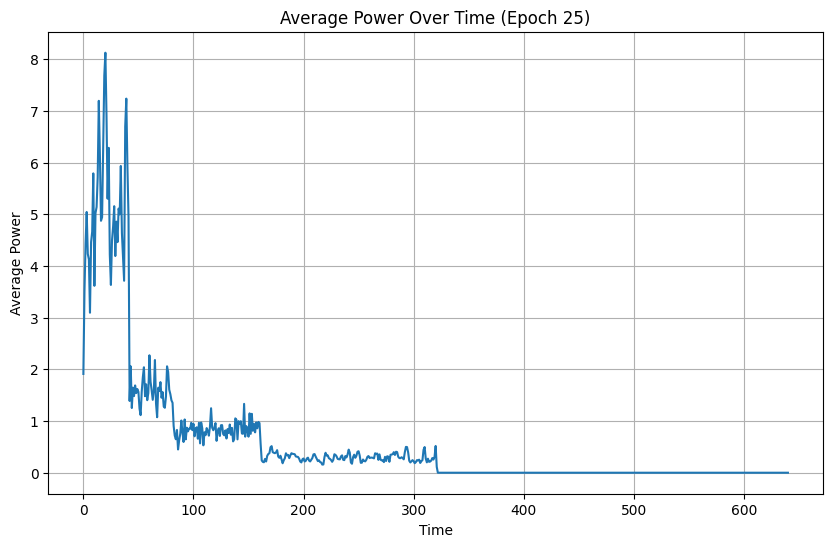

Epoch 26: Shape = (5, 14, 641)


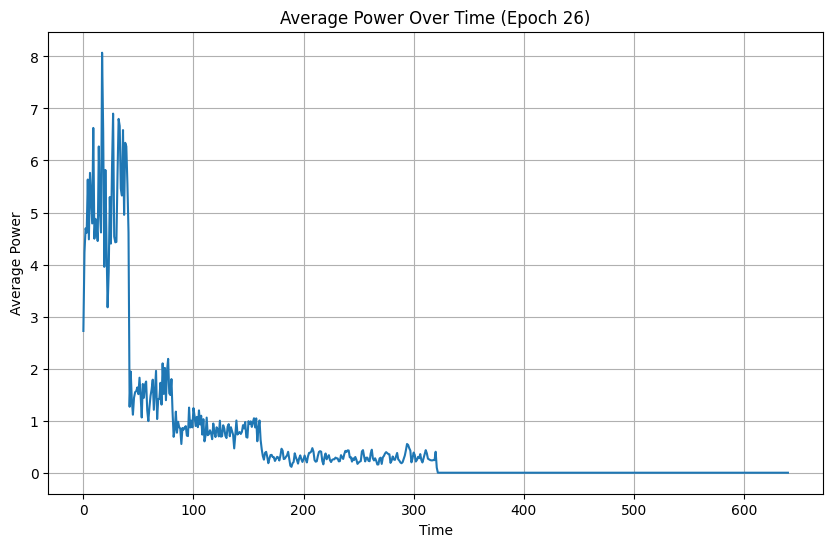

Epoch 27: Shape = (5, 14, 641)


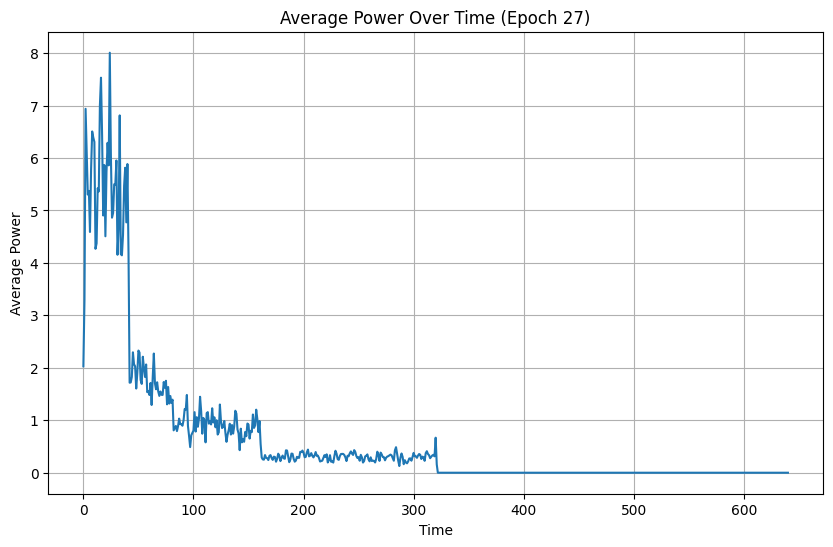

Epoch 28: Shape = (5, 14, 641)


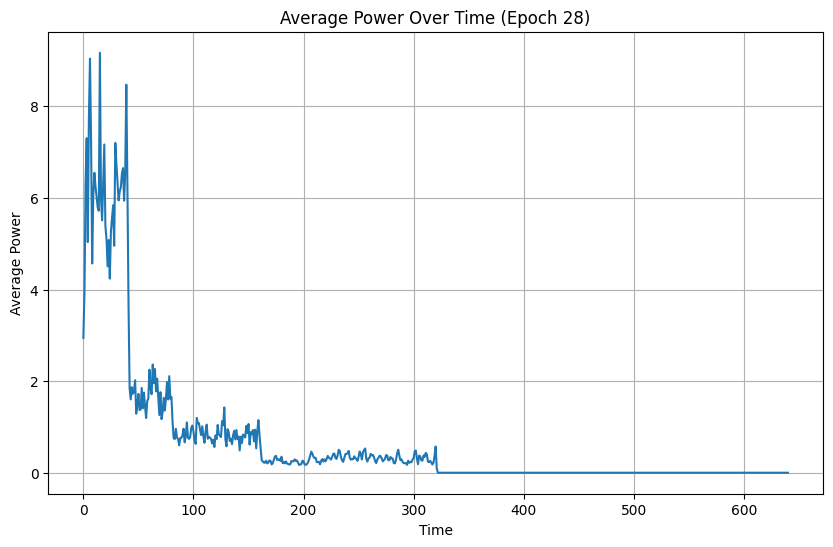

Epoch 29: Shape = (5, 14, 641)


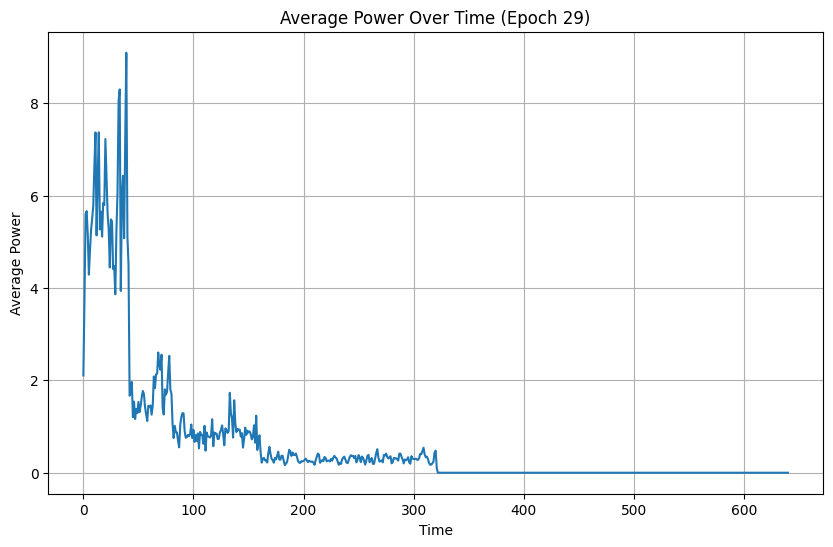

Epoch 30: Shape = (5, 14, 641)


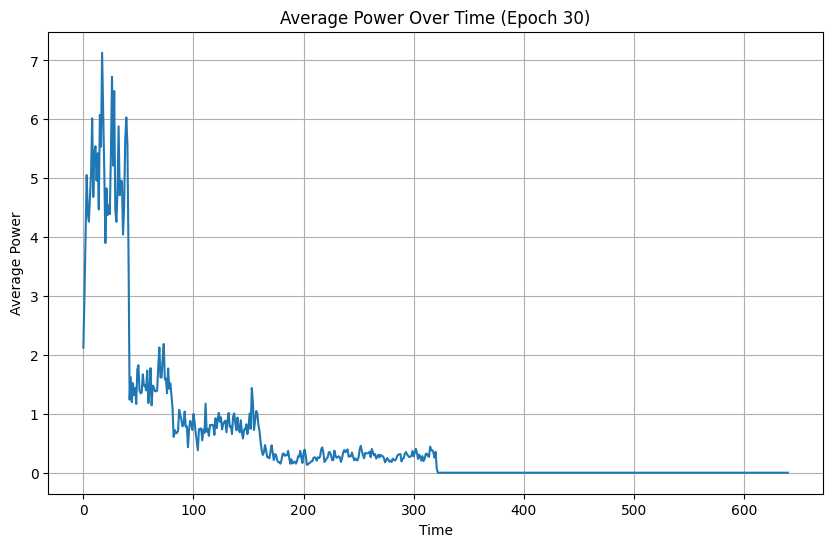

Epoch 31: Shape = (5, 14, 641)


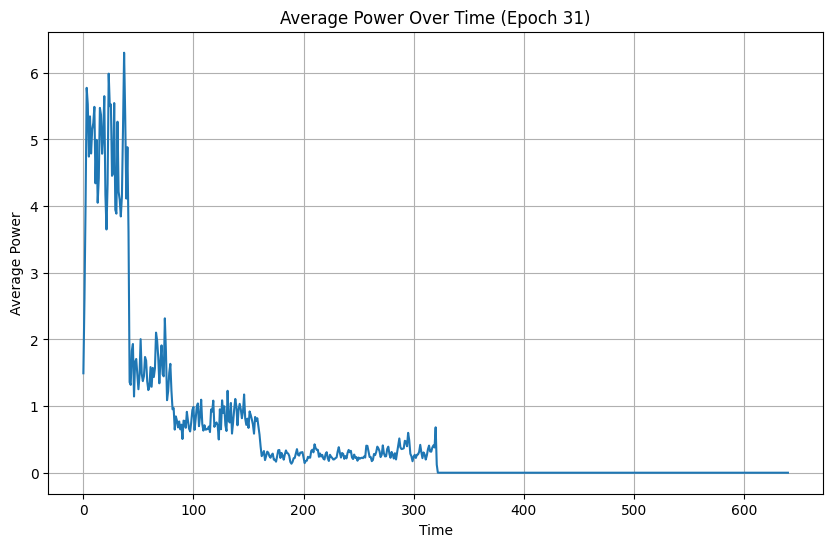

Epoch 32: Shape = (5, 14, 641)


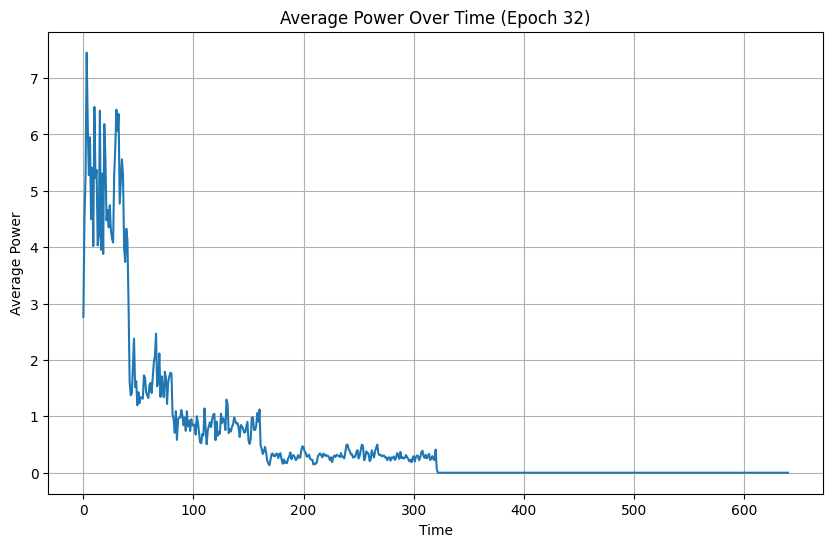

Epoch 33: Shape = (5, 14, 641)


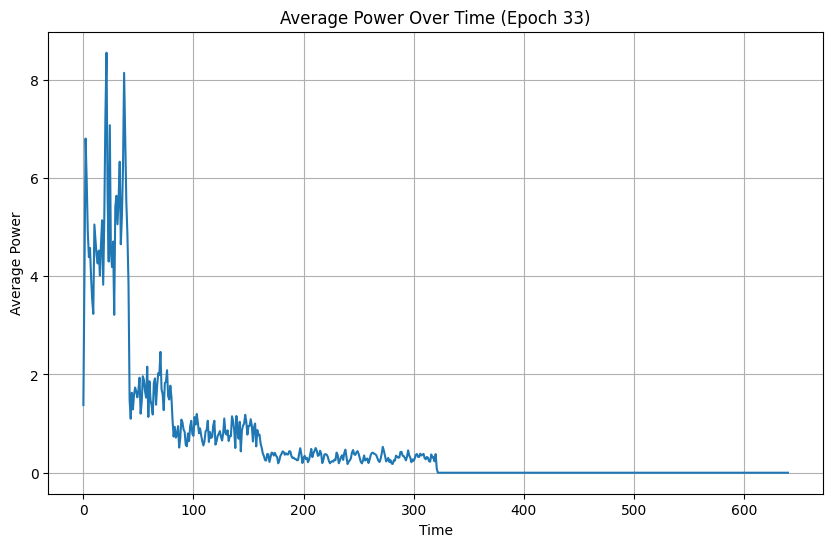

Epoch 34: Shape = (5, 14, 641)


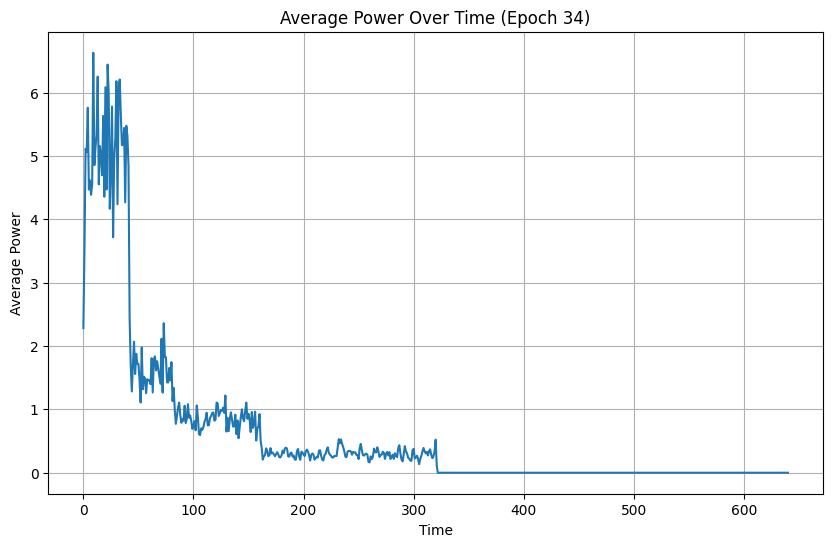

Epoch 35: Shape = (5, 14, 641)


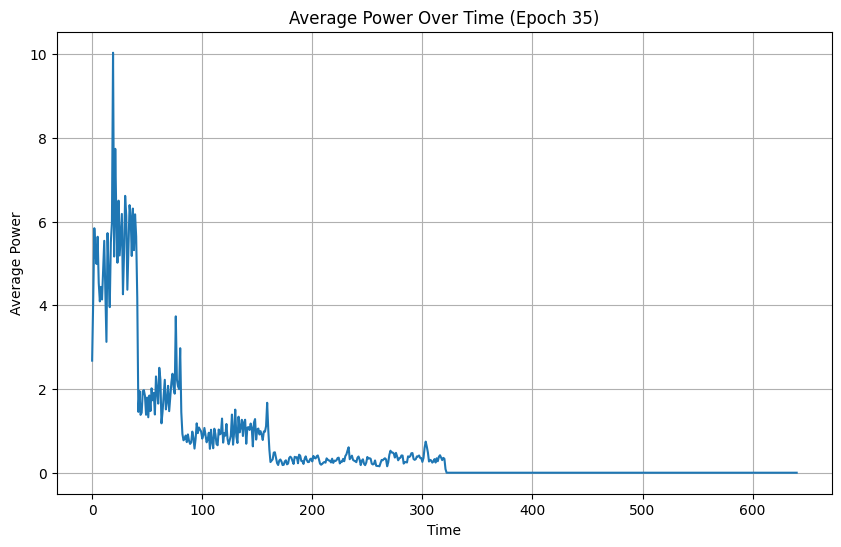

Epoch 36: Shape = (5, 14, 641)


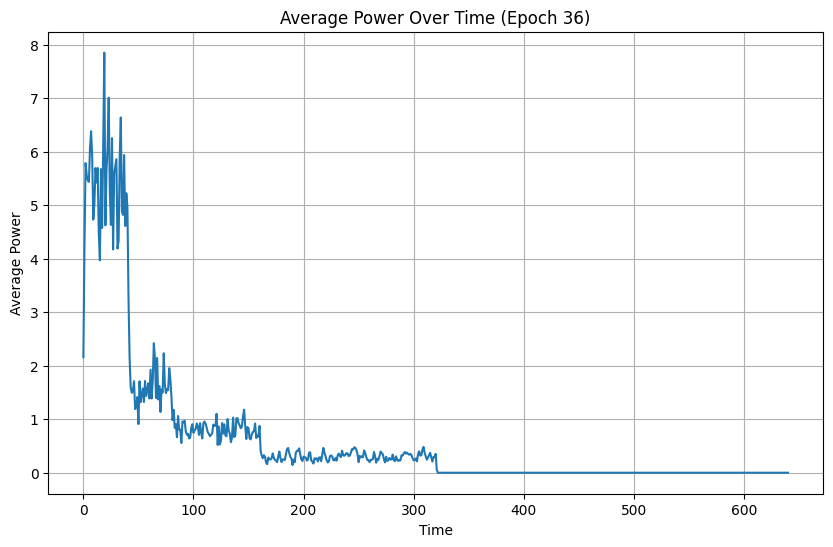

Epoch 37: Shape = (5, 14, 641)


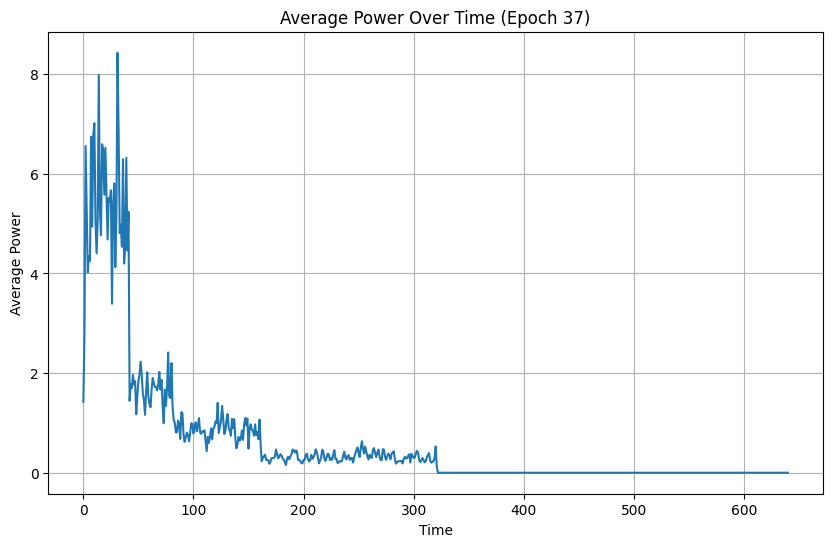

Epoch 38: Shape = (5, 14, 641)


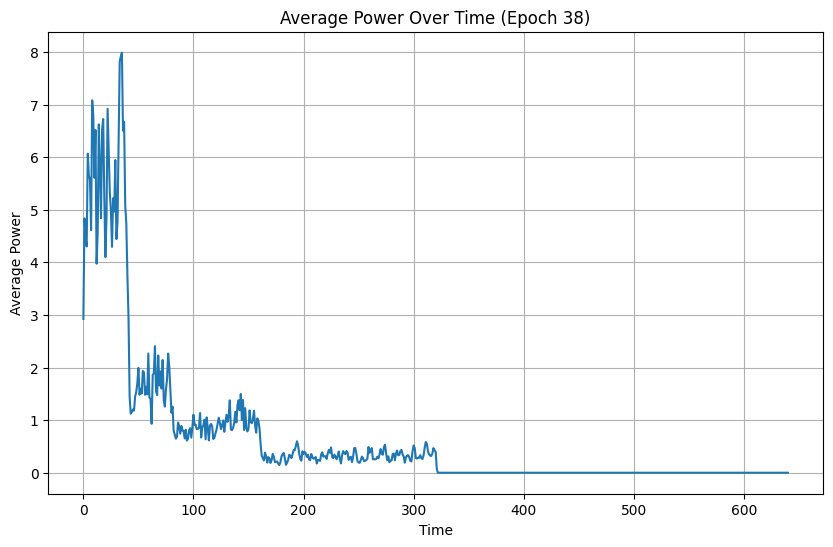

Epoch 39: Shape = (5, 14, 641)


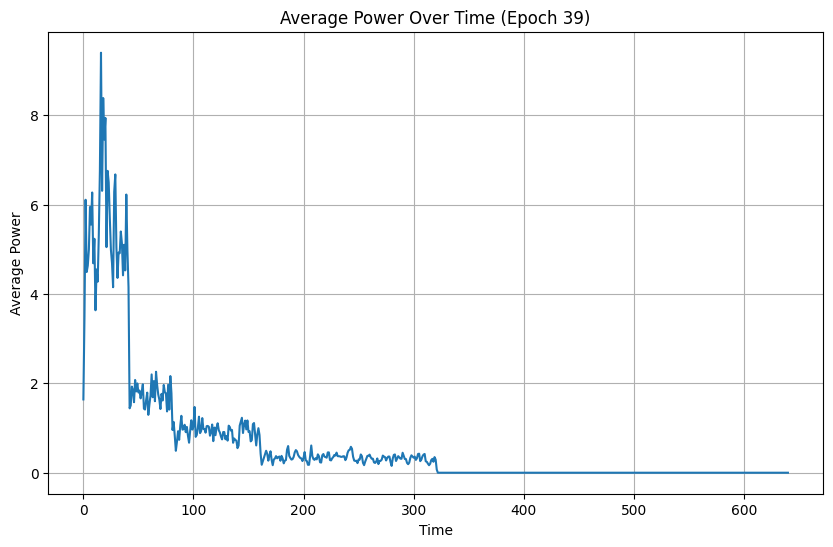

Epoch 40: Shape = (5, 14, 641)


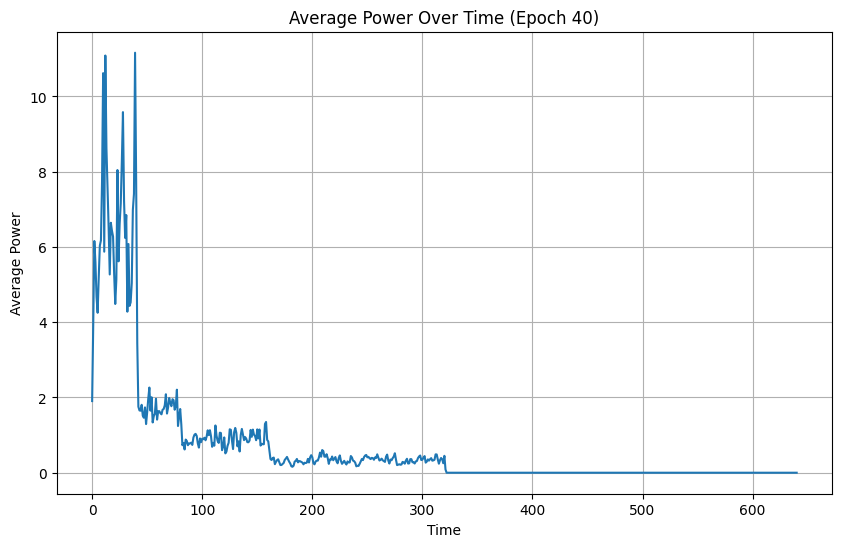

Epoch 41: Shape = (5, 14, 641)


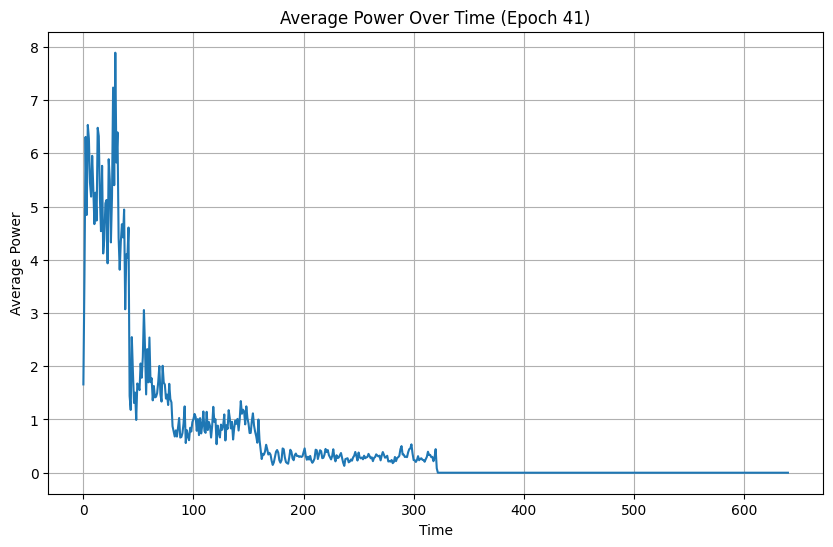

Epoch 42: Shape = (5, 14, 641)


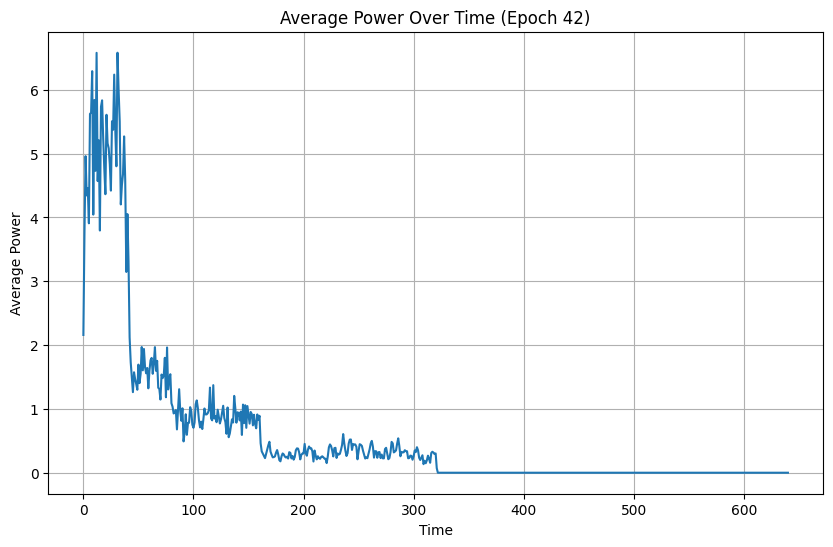

Epoch 43: Shape = (5, 14, 641)


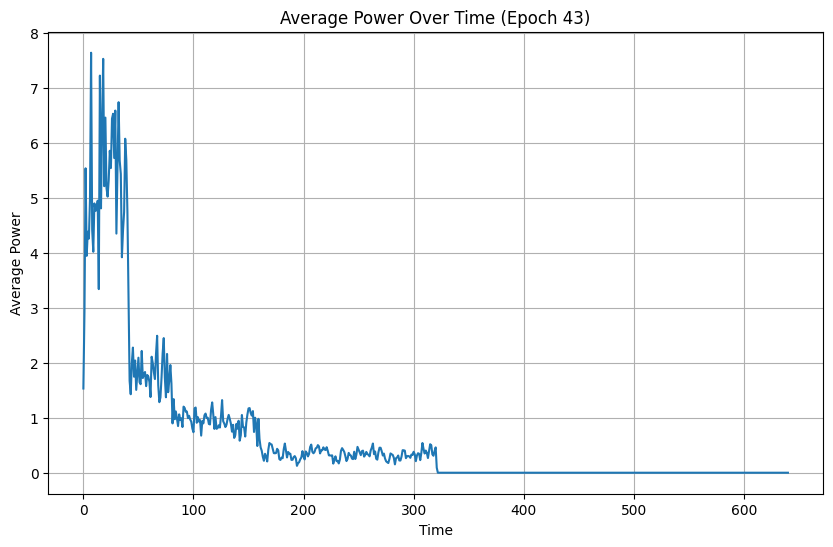

Epoch 44: Shape = (5, 14, 641)


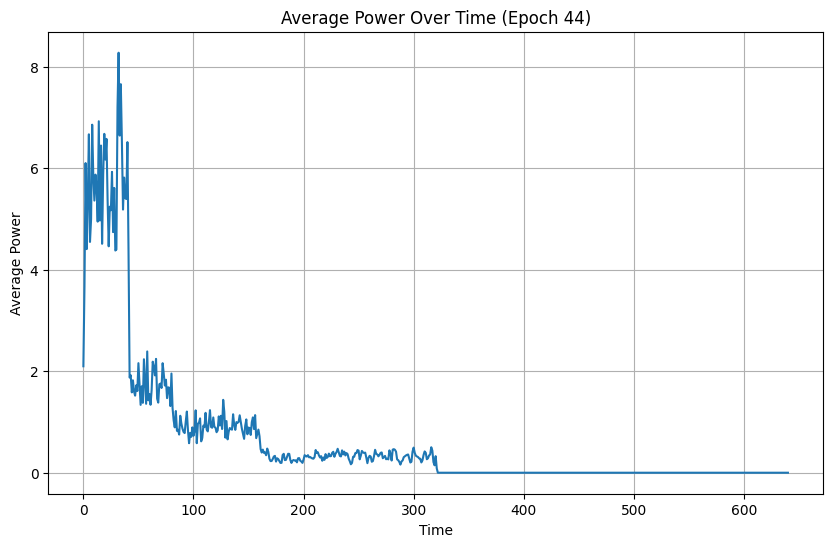

Epoch 45: Shape = (5, 14, 641)


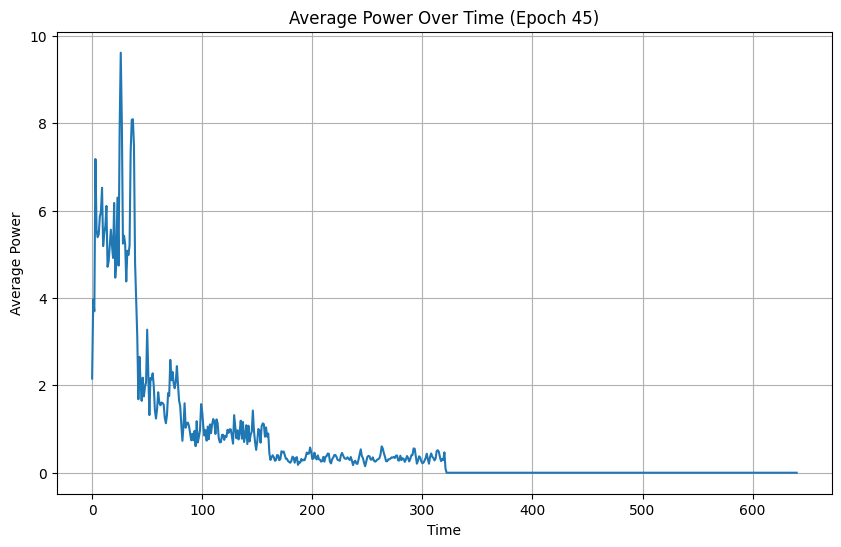

Epoch 46: Shape = (5, 14, 641)


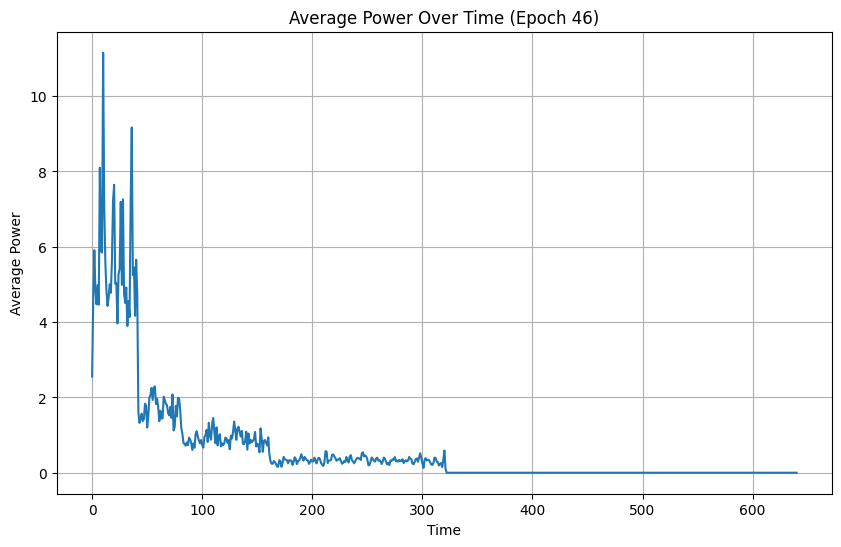

Epoch 47: Shape = (5, 14, 641)


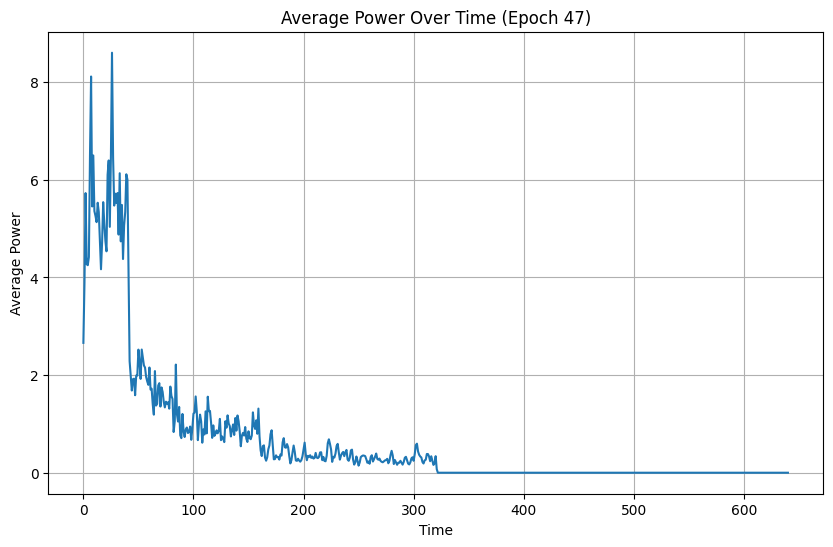

Epoch 48: Shape = (5, 14, 641)


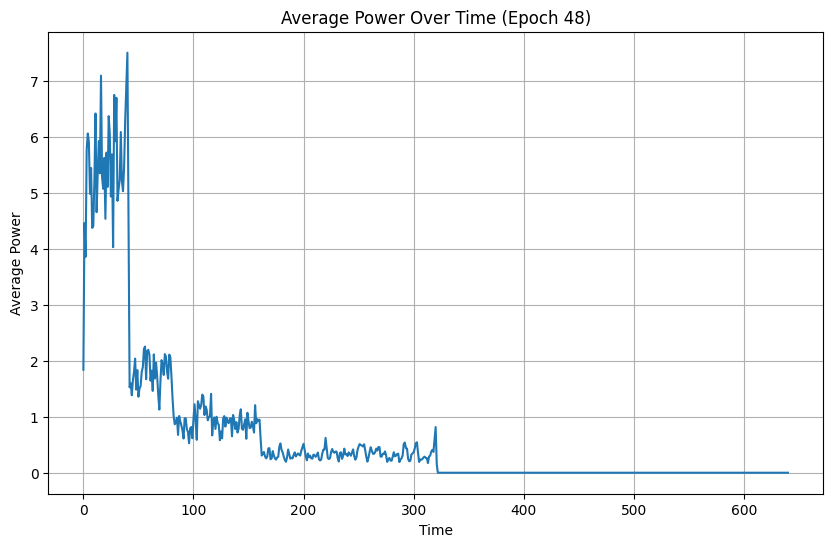

Epoch 49: Shape = (5, 14, 641)


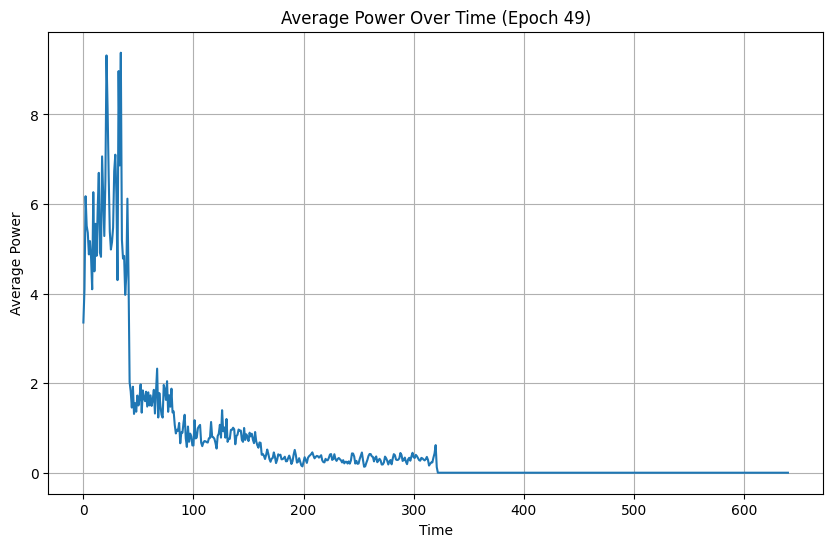

Epoch 50: Shape = (5, 14, 641)


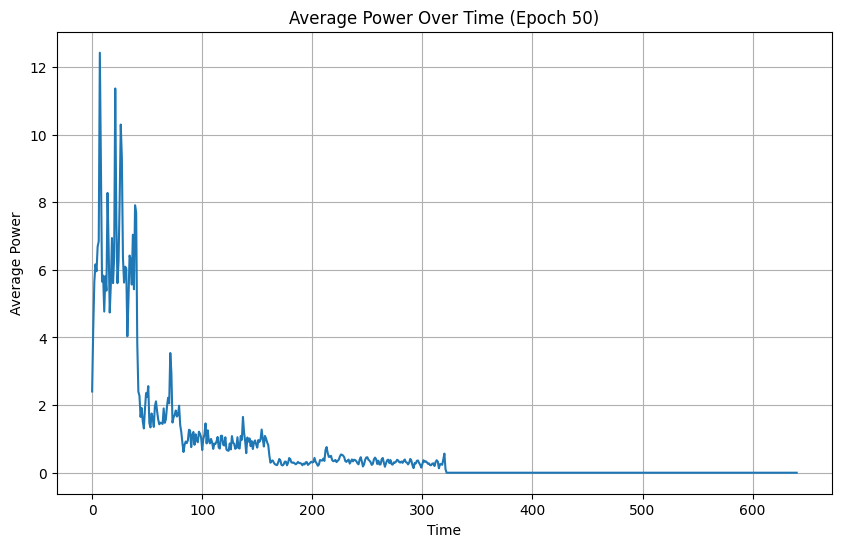

Epoch 51: Shape = (5, 14, 641)


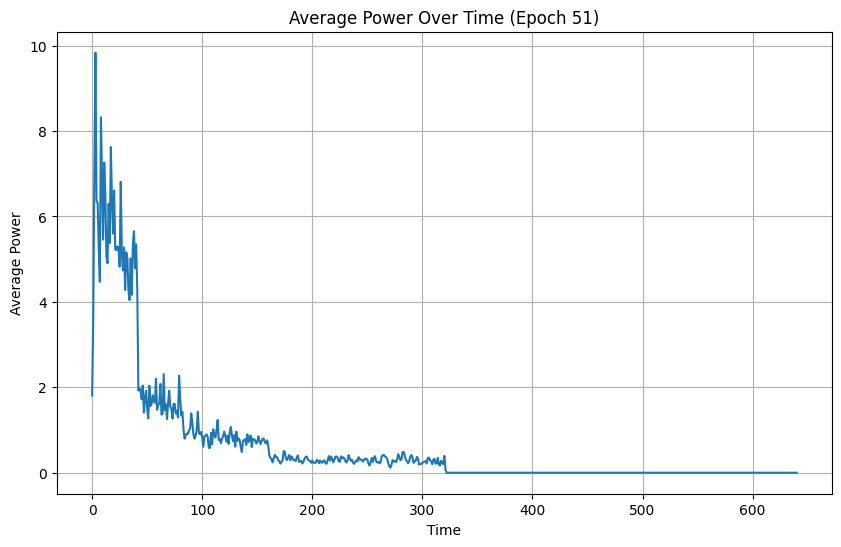

Epoch 52: Shape = (5, 14, 641)


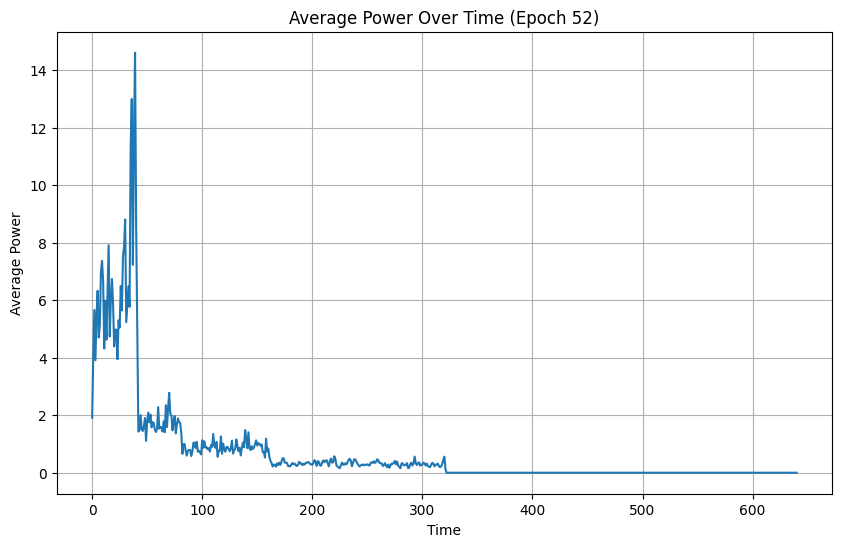

Epoch 53: Shape = (5, 14, 641)


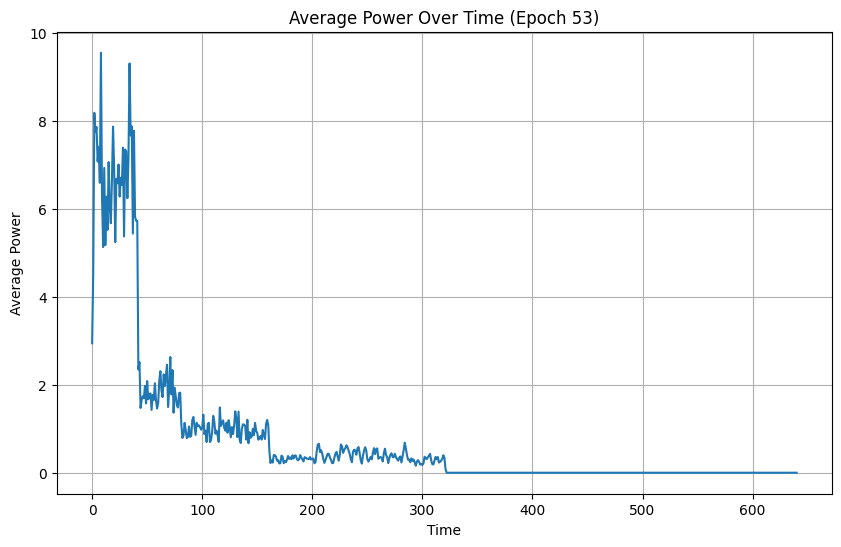

Epoch 54: Shape = (5, 14, 641)


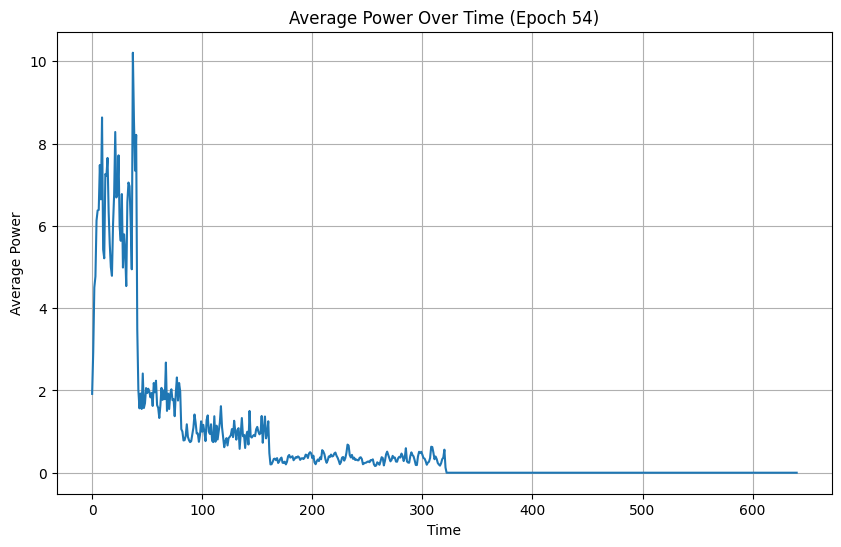

Epoch 55: Shape = (5, 14, 641)


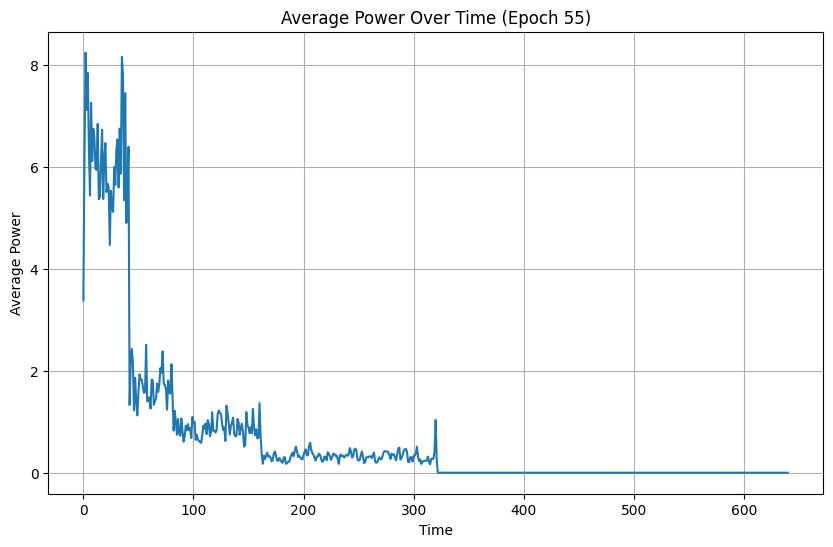

Epoch 56: Shape = (5, 14, 641)


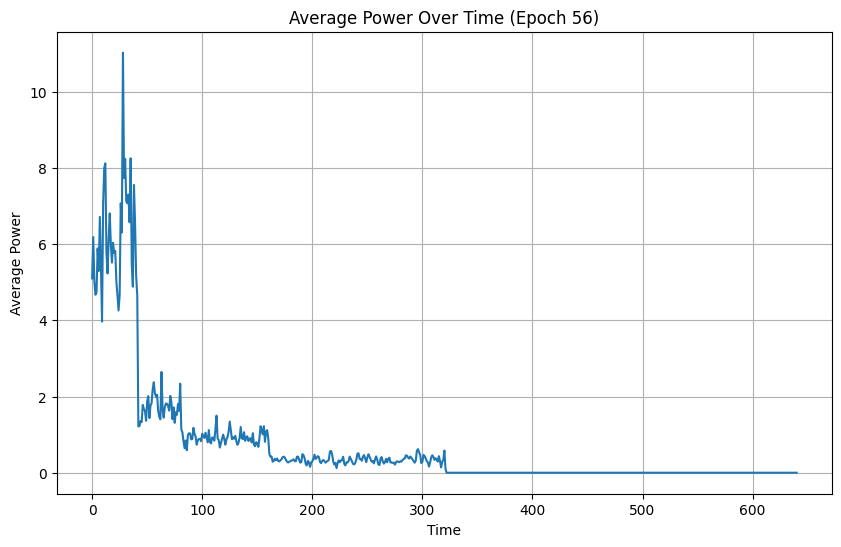

Epoch 57: Shape = (5, 14, 641)


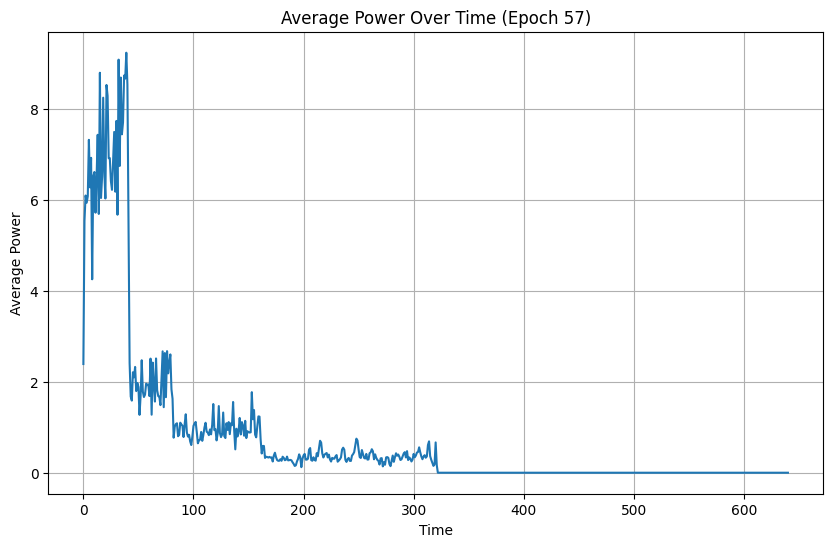

Epoch 58: Shape = (5, 14, 641)


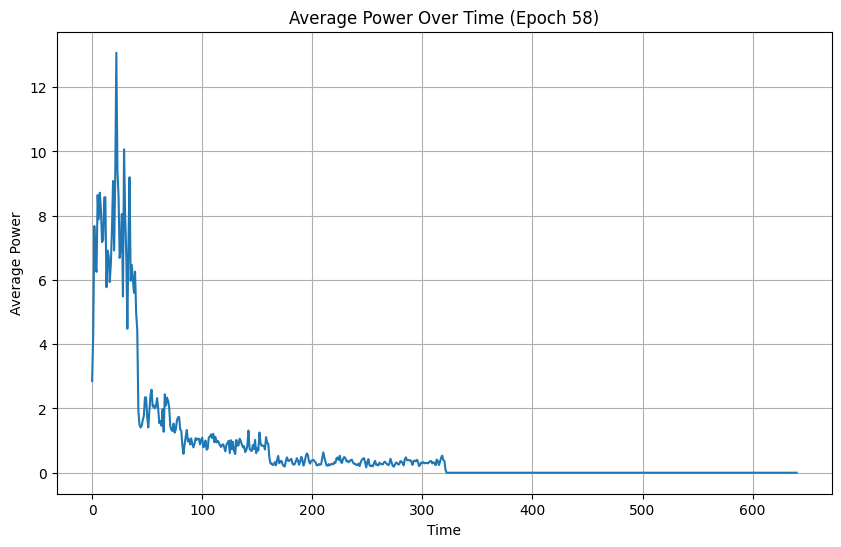

Epoch 59: Shape = (5, 14, 641)


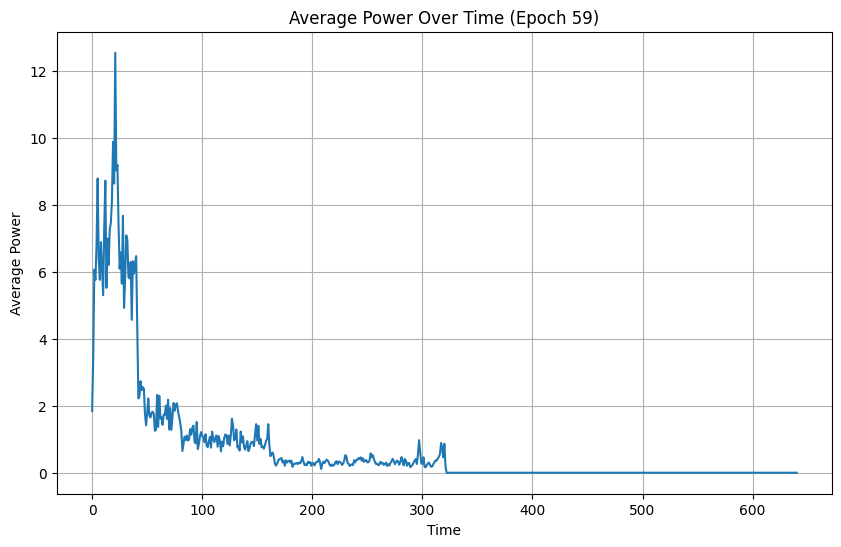

Epoch 60: Shape = (5, 14, 641)


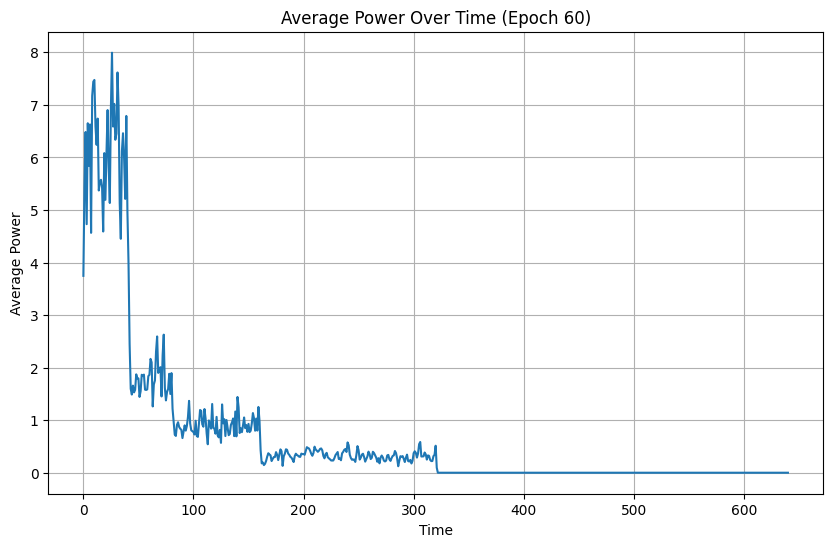

In [34]:
# Calculate average power across all frequency bands for each time point
for epoch_index, epoch_coefficients in enumerate(wavelet_coefficients_array_lh):
    print(f"Epoch {epoch_index + 1}: Shape = {epoch_coefficients.shape}")
    average_power = np.mean(np.abs(epoch_coefficients), axis=(0, 1))

    # Plot the average power over time
    plt.figure(figsize=(10, 6))
    plt.plot(average_power)
    plt.xlabel('Time')
    plt.ylabel('Average Power')
    plt.title(f'Average Power Over Time (Epoch {epoch_index + 1})')
    plt.grid(True)
    plt.show()


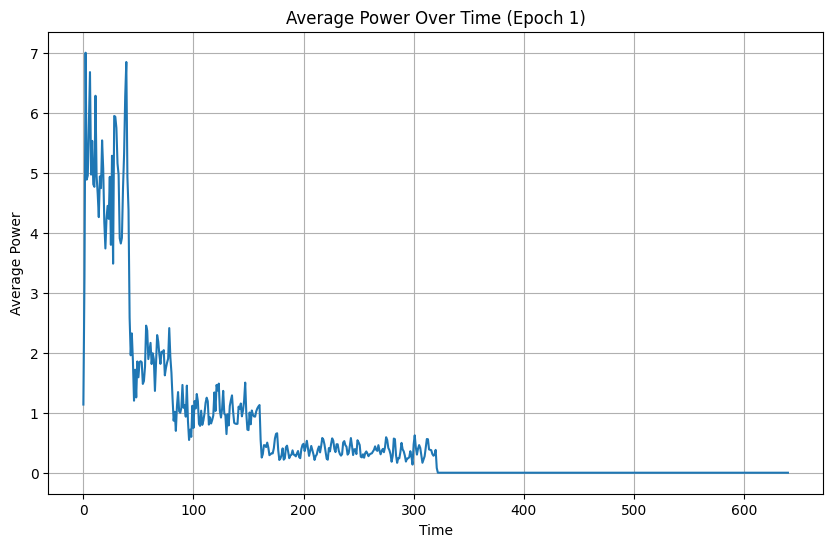

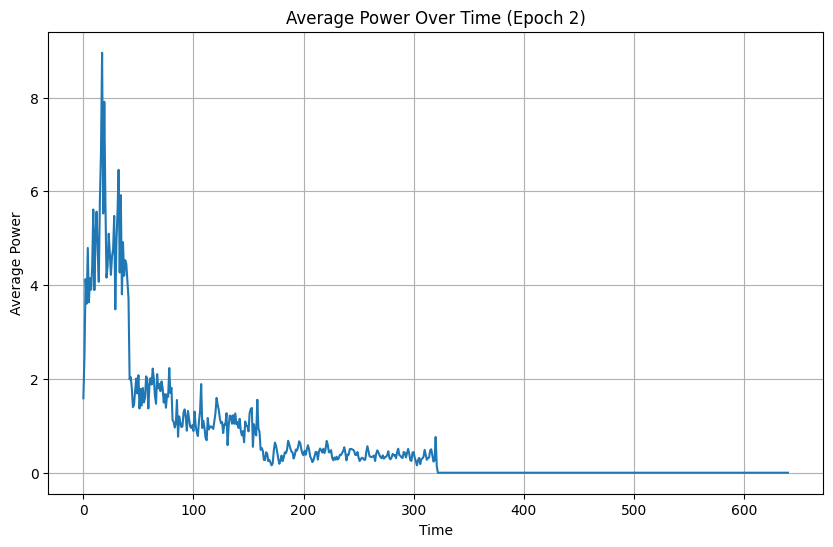

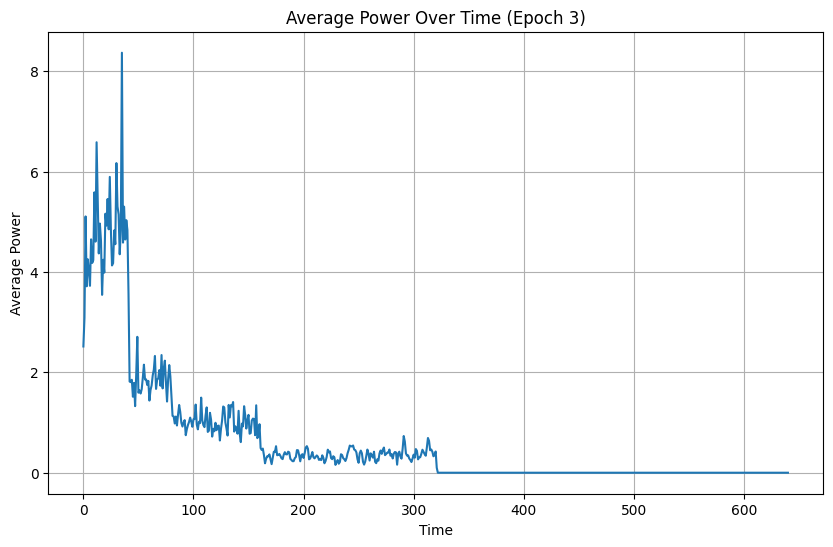

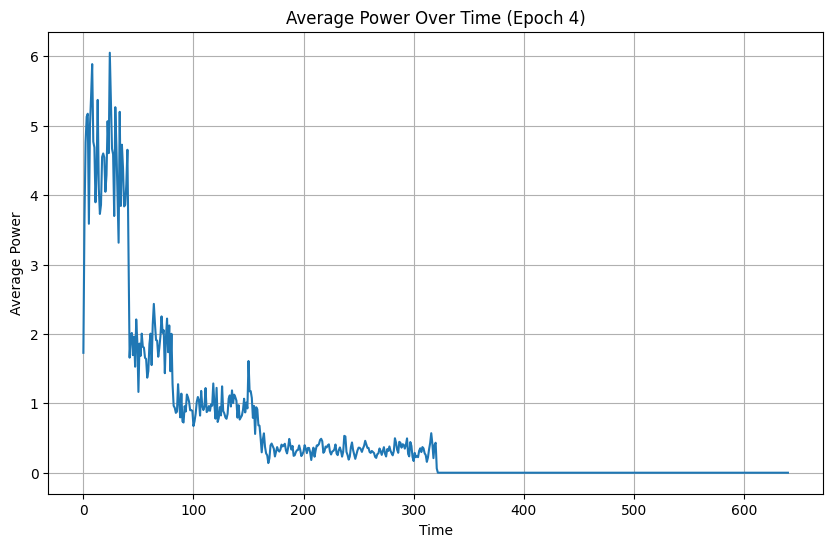

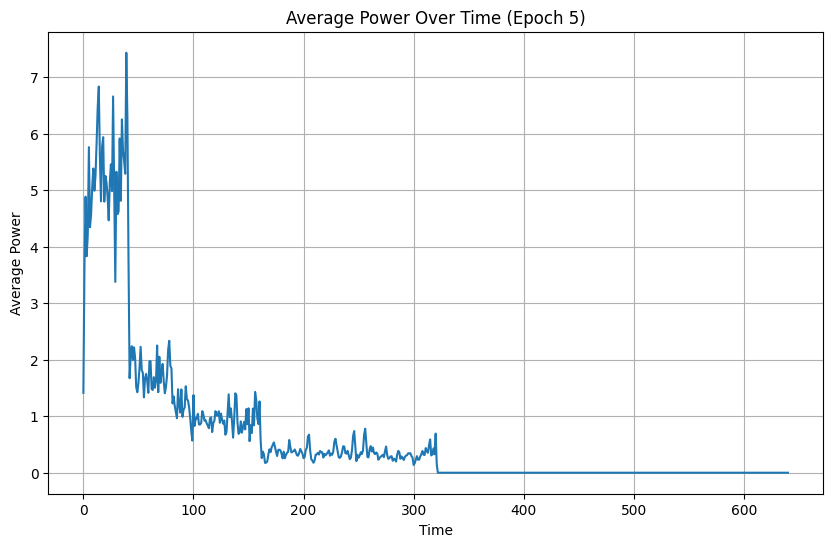

...

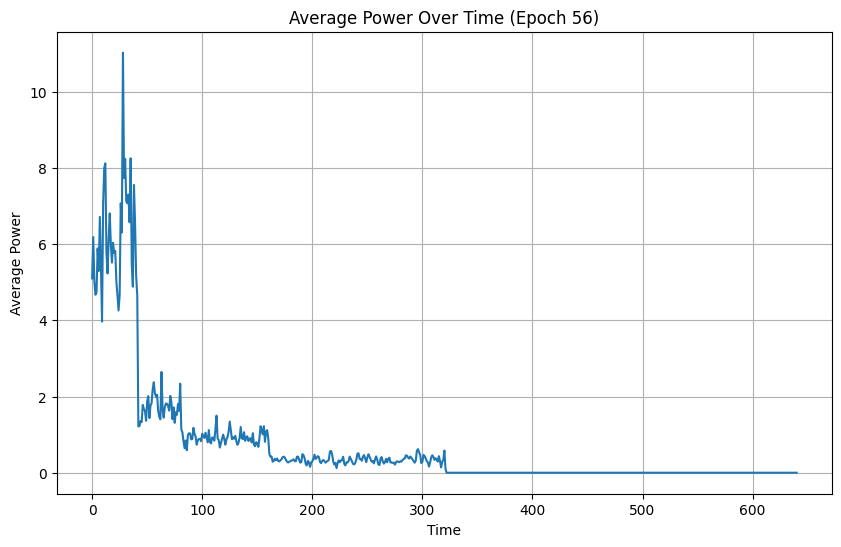

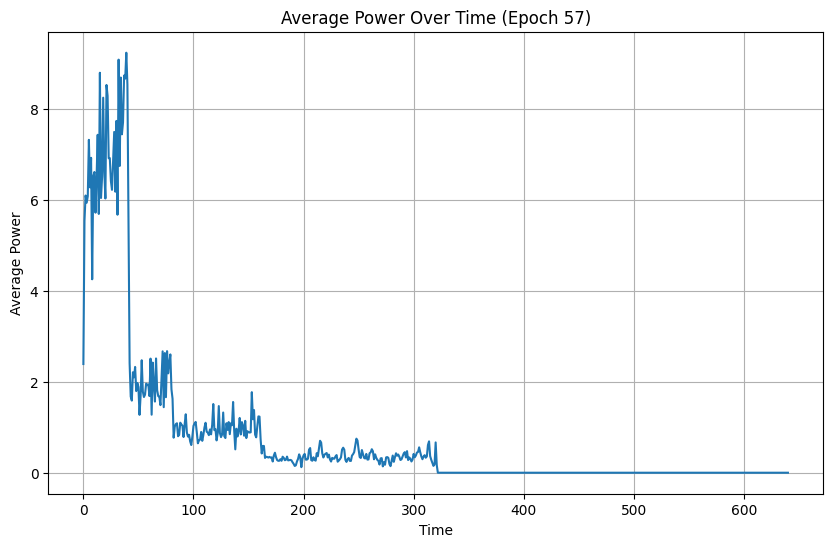

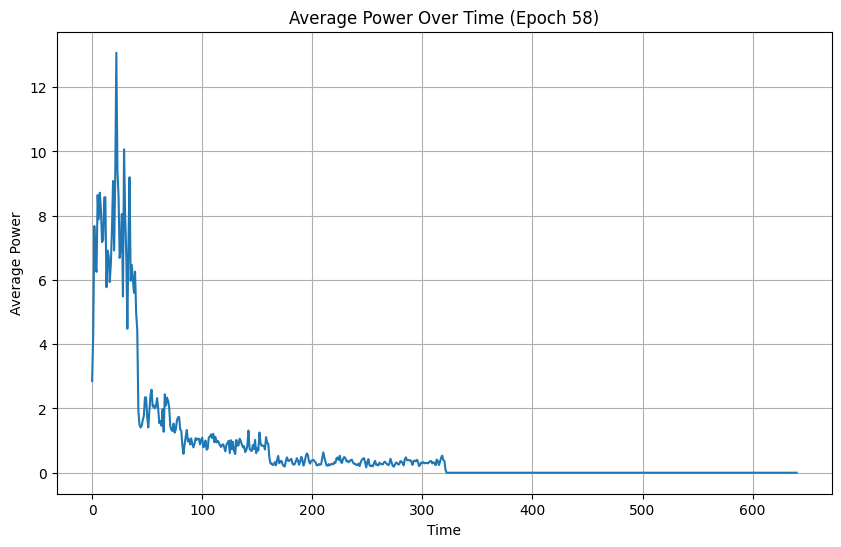

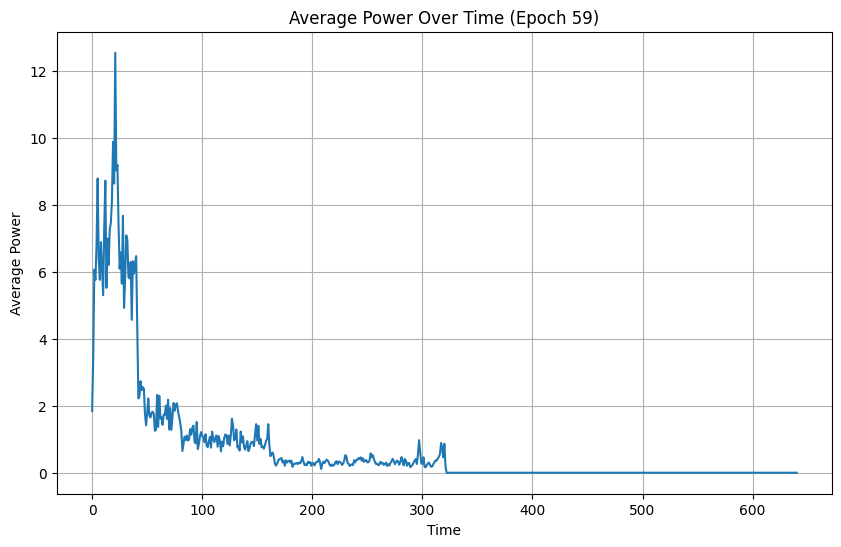

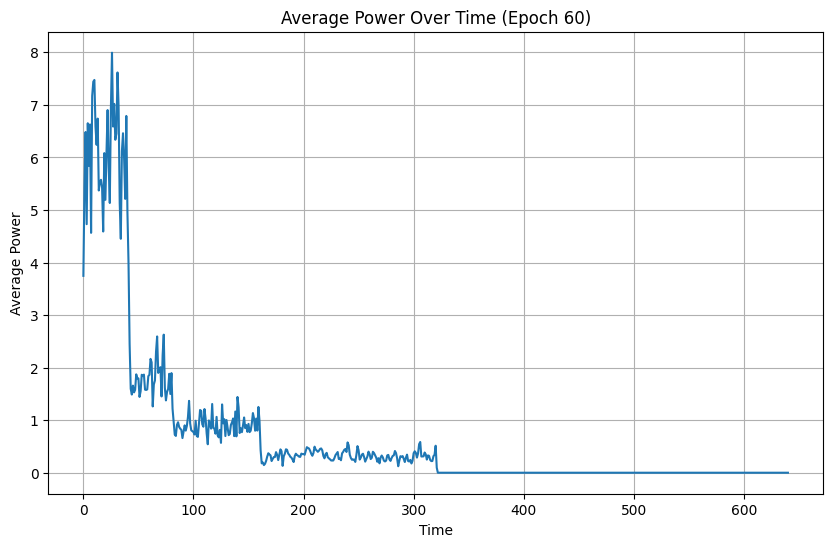

In [35]:
# Calculate average power across all frequency bands for each time point
for epoch_index, epoch_coefficients in enumerate(wavelet_coefficients_array_lh):
    average_power = np.mean(np.abs(epoch_coefficients), axis=(0, 1))

    # Plot the average power over time
    plt.figure(figsize=(10, 6))
    plt.plot(average_power)
    plt.xlabel('Time')
    plt.ylabel('Average Power')
    plt.title(f'Average Power Over Time (Epoch {epoch_index + 1})')
    plt.grid(True)
    plt.show()


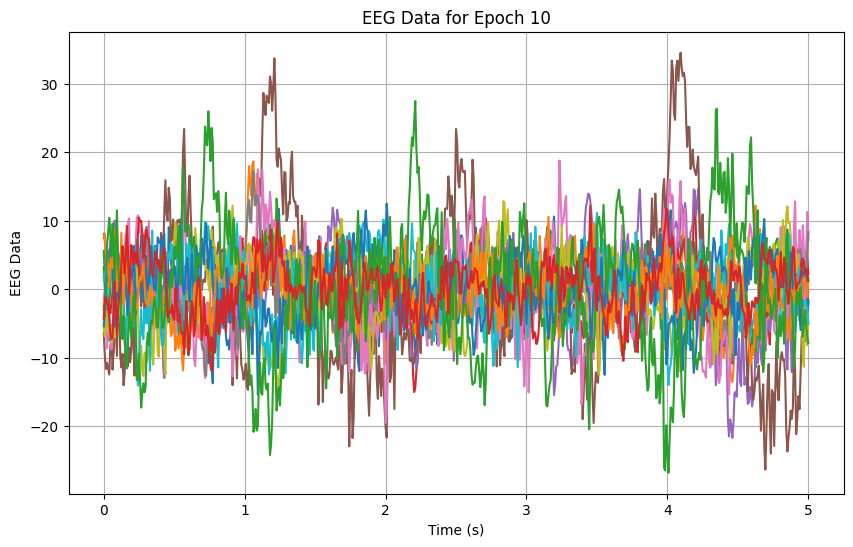

In [36]:


# Assuming 'epochs' is your list of epoch objects
epoch_index = 9  # Epoch 10 corresponds to index 9 (Python indexing starts from 0)

# Extract EEG data for Epoch 10
epoch_10_data = epochs_lh[epoch_index].get_data()

# Plot EEG data for Epoch 10
plt.figure(figsize=(10, 6))
plt.plot(epochs_lh[epoch_index].times, epoch_10_data.T)  # Transpose to plot each channel separately
plt.xlabel('Time (s)')
plt.ylabel('EEG Data')
plt.title(f'EEG Data for Epoch 10')
plt.grid(True)
plt.show()


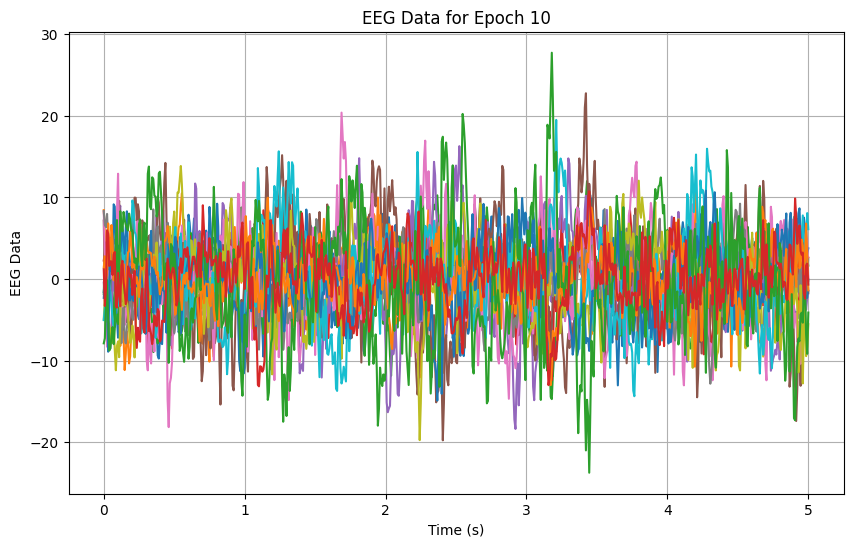

In [37]:
import matplotlib.pyplot as plt

# Assuming 'epochs' is your list of epoch objects
epoch_index = 10  # Epoch 10 corresponds to index 9 (Python indexing starts from 0)

# Extract EEG data for Epoch 10
epoch_10_data = epochs_lh[epoch_index].get_data()

# Plot EEG data for Epoch 10
plt.figure(figsize=(10, 6))
plt.plot(epochs_lh[epoch_index].times, epoch_10_data.T)  # Transpose to plot each channel separately
plt.xlabel('Time (s)')
plt.ylabel('EEG Data')
plt.title(f'EEG Data for Epoch 10')
plt.grid(True)
plt.show()


## Right Hand

In [38]:
data_rh.head()

,Timestamp,OriginalTimestamp,EEG.Counter,EEG.Interpolated,EEG.AF3,EEG.F7,EEG.F3,EEG.FC5,EEG.T7,EEG.P7,EEG.O1,EEG.O2,EEG.P8,EEG.T8,EEG.FC6,EEG.F4,EEG.F8,EEG.AF4
0,1.708122e+09,1.708122e+09,82.0,0.0,4301.025879,4282.563965,4322.179688,4325.000000,4310.641113,4307.307617,4307.436035,4305.641113,4291.410156,4293.846191,4507.436035,4489.871582,4383.077148,4440.641113
1,1.708122e+09,1.708122e+09,83.0,0.0,4296.153809,4286.025879,4321.922852,4324.871582,4312.179688,4308.205078,4307.563965,4303.974121,4291.666504,4296.666504,4502.436035,4488.974121,4389.358887,4441.794922
2,1.708122e+09,1.708122e+09,84.0,0.0,4295.769043,4289.743652,4323.077148,4327.051270,4313.589844,4312.692383,4309.102539,4307.051270,4294.487305,4296.666504,4498.846191,4491.282227,4391.538574,4445.897461
3,1.708122e+09,1.708122e+09,85.0,0.0,4296.410156,4282.307617,4321.666504,4325.897461,4313.205078,4313.077148,4305.384766,4303.846191,4294.358887,4293.205078,4497.692383,4485.128418,4384.487305,4443.077148
4,1.708122e+09,1.708122e+09,86.0,0.0,4299.871582,4280.641113,4322.820313,4324.230957,4311.794922,4310.512695,4301.153809,4294.871582,4291.538574,4290.128418,4497.948730,4483.461426,4377.563965,4441.410156


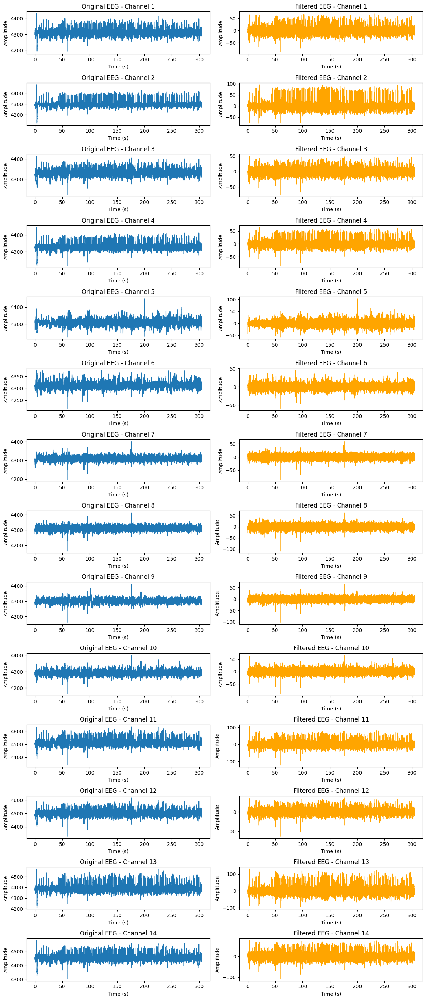

In [39]:
#RIGHT HAND
eeg_df = data_rh

# Extract EEG data from the DataFrame (assuming EEG channels start from column 'EEG.AF3' to 'POW.AF4.Gamma')
eeg_data = eeg_df.iloc[:, 4:18].values  # Assuming EEG data starts from column index 4

# Extract timestamps from the DataFrame
timestamps = eeg_df['Timestamp'].values

# Define band-pass filter parameters
low_freq = 1  # Low cutoff frequency (Hz)
high_freq = 30  # High cutoff frequency (Hz)
sample_rate = 128  # Sampling rate (Hz)
order = 4  # Filter order

# Function to apply band-pass filter to EEG data
def bandpass_filter(eeg_data, lowcut, highcut, fs, order=4):
    nyquist_freq = 0.5 * fs
    low = lowcut / nyquist_freq
    high = highcut / nyquist_freq
    b, a = butter(order, [low, high], btype='band')
    filtered_data = filtfilt(b, a, eeg_data, axis=0)
    return filtered_data

# Apply band-pass filter to EEG data
filtered_eeg_data = bandpass_filter(eeg_data, low_freq, high_freq, sample_rate, order)

# Plot original and filtered EEG data for inspection
def plot_filtered_eeg(original_data, filtered_data, timestamps, sample_rate=128):
    time_axis = (timestamps - timestamps[0])  # Convert timestamps to relative time in seconds

    num_channels = original_data.shape[1]
    fig, ax = plt.subplots(num_channels, 2, figsize=(12, 2*num_channels))
    for i in range(num_channels):
        ax[i, 0].plot(time_axis, original_data[:, i])
        ax[i, 0].set_title(f'Original EEG - Channel {i+1}')
        ax[i, 0].set_xlabel('Time (s)')
        ax[i, 0].set_ylabel('Amplitude')
        
        ax[i, 1].plot(time_axis, filtered_data[:, i], color='orange')
        ax[i, 1].set_title(f'Filtered EEG - Channel {i+1}')
        ax[i, 1].set_xlabel('Time (s)')
        ax[i, 1].set_ylabel('Amplitude')

    plt.tight_layout()
    plt.show()

# Call the function to plot original and filtered EEG data
plot_filtered_eeg(eeg_data, filtered_eeg_data, timestamps)


Creating RawArray with float64 data, n_channels=14, n_times=39004
    Range : 0 ... 39003 =      0.000 ...   304.711 secs
Ready.
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 423 samples (3.305 s)

Fitting ICA to data using 14 channels (please be patient, this may take a while)
Selecting by number: 2 components
Fitting ICA took 0.1s.
Applying ICA to Raw instance
    Transforming to ICA space (2 components)
    Zeroing out 2 ICA components
    Projecting back using 14 PCA components


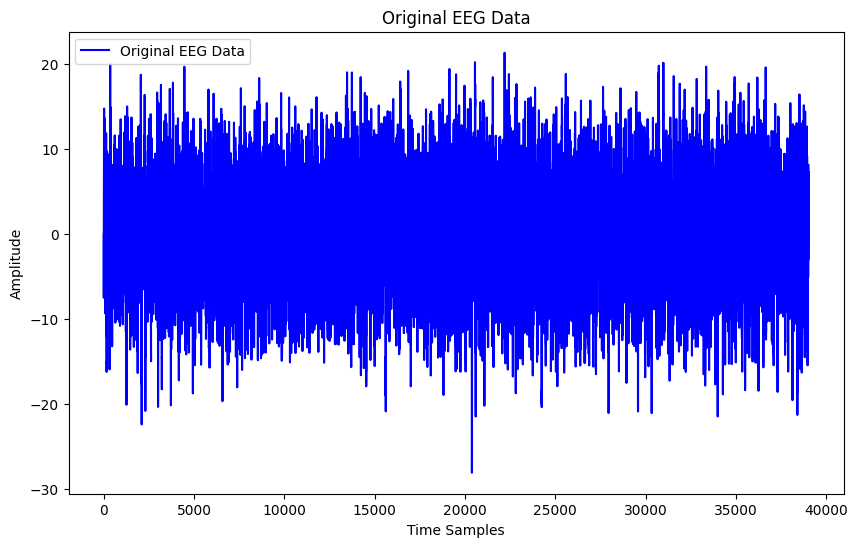

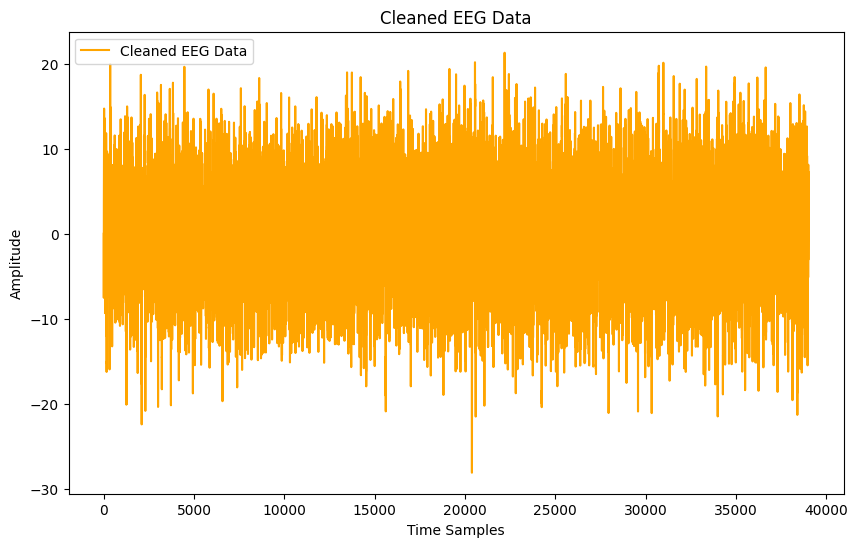

In [40]:
import pandas as pd
import numpy as np
import mne
from sklearn.decomposition import FastICA
import matplotlib.pyplot as plt

# Load EEG data from the CSV file
eeg_df = data_rh

# Extract EEG data columns (assuming EEG channels start from the 5th column)
eeg_data = eeg_df.iloc[:, 4:18].values

# Extract channel names
ch_names = eeg_df.columns[4:18].tolist()

# Create MNE Info object
info = mne.create_info(ch_names=ch_names, sfreq=128, ch_types='eeg')

# Transpose EEG data (rows as channels, columns as samples)
eeg_data = eeg_data.T

# Create MNE Raw object
raw_rh = mne.io.RawArray(eeg_data, info)

# Apply high-pass filter at 1 Hz
raw_rh.filter(l_freq=1, h_freq=None)

# Apply Independent Component Analysis (ICA) for artifact removal
n_components = 0.999999  # Set a threshold closer to 1
ica = mne.preprocessing.ICA(n_components=2, random_state=42)
ica.fit(raw_rh)

# ica = mne.preprocessing.ICA(n_components=5, random_state=42)
# ica.fit(raw)

# Identify components representing artifacts based on visual inspection
# Exclude artifact-related components from the data
ica.exclude = [0, 1, 2]  # Example: Exclude components 0, 1, and 2

# Apply ICA to Raw instance and obtain cleaned data
cleaned_eeg_data = ica.apply(raw_rh)

# Plot original and cleaned EEG data for inspection
# Plot original EEG data
plt.figure(figsize=(10, 6))
plt.plot(raw_rh._data[0, :],color='blue', label='Original EEG Data')
plt.xlabel('Time Samples')
plt.ylabel('Amplitude')
plt.title('Original EEG Data')
plt.legend()
plt.show()

# Plot cleaned EEG data
plt.figure(figsize=(10, 6))
plt.plot(cleaned_eeg_data._data[0, :],color='orange', label='Cleaned EEG Data')
plt.xlabel('Time Samples')
plt.ylabel('Amplitude')
plt.title('Cleaned EEG Data')
plt.legend()
plt.show()

# Save cleaned EEG data to CSV file
cleaned_eeg_df = pd.DataFrame(cleaned_eeg_data._data.T, columns=ch_names)
cleaned_eeg_df.to_csv('cleaned_data_rh.csv', index=False)


In [41]:
#EPOCHS GENEGRATING

In [42]:
duration = 5  # Duration of each epoch in seconds

# Define the start and end times for each epoch
start_times = np.arange(0, raw_rh.times[-1] - duration, duration)  # Adjusted to prevent exceeding max time
end_times = start_times + duration

# Create empty list to store epoch objects
epochs_rh = []

# Iterate over each epoch and extract the data
for start, end in zip(start_times, end_times):
    epoch = raw_rh.copy().crop(tmin=start, tmax=end)
    epochs_rh.append(epoch)

# Now 'epochs' is a list containing individual epoch objects
# You can further process or analyze each epoch as needed

In [43]:
print("Number of epochs:", len(epochs_rh))

Number of epochs: 60


In [44]:


# Define baseline start and end (in seconds)
baseline_start = -0.2
baseline_end = 0

# Get the sampling frequency from the first epoch
sfreq = epochs_rh[0].info['sfreq']
print("Sample Frequencies:",sfreq)

# Convert baseline start and end from seconds to samples
baseline_start_idx = int(baseline_start * sfreq)
baseline_end_idx = int(baseline_end * sfreq)

# Ensure baseline indices are within the range of epoch data
baseline_start_idx = max(0, baseline_start_idx)
baseline_end_idx = min(epochs_rh[0].get_data().shape[1], baseline_end_idx)

# Compute baseline correction for each epoch
baseline_corrected_epochs_rh = []
for epoch in epochs_rh:
    # Extract epoch data
    epoch_data = epoch.get_data()
    
    # Check if baseline indices are valid
    if baseline_start_idx < baseline_end_idx:
        # Compute baseline correction (mean or median) along the time dimension
        baseline_values = np.mean(epoch_data[:, baseline_start_idx:baseline_end_idx], axis=1)
        # Or, if you prefer median:
        # baseline_values = np.median(epoch_data[:, baseline_start_idx:baseline_end_idx], axis=1)
        
        # Apply baseline correction
        baseline_corrected_epoch = epoch_data - baseline_values[:, np.newaxis]
    else:
        # If baseline indices are invalid, set baseline-corrected epoch to original epoch data
        baseline_corrected_epoch = epoch_data
    
    baseline_corrected_epochs_rh.append(baseline_corrected_epoch)

Sample Frequencies: 128.0


In [45]:
for i, baseline_corrected_epoch in enumerate(baseline_corrected_epochs_rh):
    print(f"Epoch {i+1}: Shape = {baseline_corrected_epoch.shape}")


Epoch 1: Shape = (14, 641)
Epoch 2: Shape = (14, 641)
Epoch 3: Shape = (14, 641)
Epoch 4: Shape = (14, 641)
Epoch 5: Shape = (14, 641)
Epoch 6: Shape = (14, 641)
Epoch 7: Shape = (14, 641)
Epoch 8: Shape = (14, 641)
Epoch 9: Shape = (14, 641)
Epoch 10: Shape = (14, 641)
Epoch 11: Shape = (14, 641)
Epoch 12: Shape = (14, 641)
Epoch 13: Shape = (14, 641)
Epoch 14: Shape = (14, 641)
Epoch 15: Shape = (14, 641)
Epoch 16: Shape = (14, 641)
Epoch 17: Shape = (14, 641)
Epoch 18: Shape = (14, 641)
Epoch 19: Shape = (14, 641)
Epoch 20: Shape = (14, 641)
Epoch 21: Shape = (14, 641)
Epoch 22: Shape = (14, 641)
Epoch 23: Shape = (14, 641)
Epoch 24: Shape = (14, 641)
Epoch 25: Shape = (14, 641)
Epoch 26: Shape = (14, 641)
Epoch 27: Shape = (14, 641)
Epoch 28: Shape = (14, 641)
Epoch 29: Shape = (14, 641)
Epoch 30: Shape = (14, 641)
Epoch 31: Shape = (14, 641)
Epoch 32: Shape = (14, 641)
Epoch 33: Shape = (14, 641)
Epoch 34: Shape = (14, 641)
Epoch 35: Shape = (14, 641)
Epoch 36: Shape = (14, 641)
E

In [46]:

amplitude_threshold = 50  # Adjust according to your data
variance_threshold = 20   # Adjust according to your data

# Initialize an empty list to store clean epochs
clean_epochs = []

# Iterate over each epoch and apply threshold-based rejection
for epoch in baseline_corrected_epochs_rh:
    if np.max(np.abs(epoch)) < amplitude_threshold and np.var(epoch) < variance_threshold:
        clean_epochs.append(epoch)

# Convert the list of clean epochs to a numpy array
clean_epochs = np.array(clean_epochs)

# Print the number of remaining clean epochs
# print("Number of clean epochs after threshold-based rejection:", len(clean_epochs))




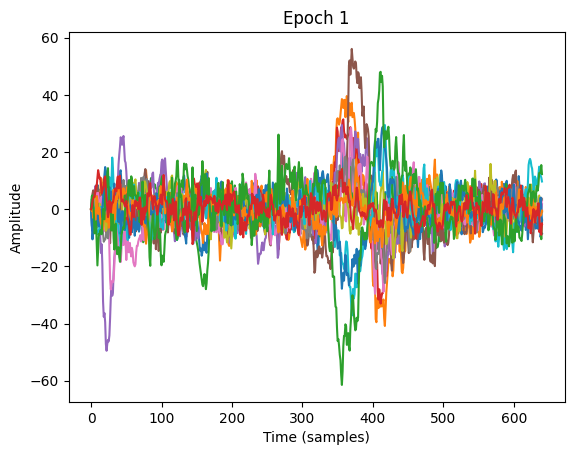

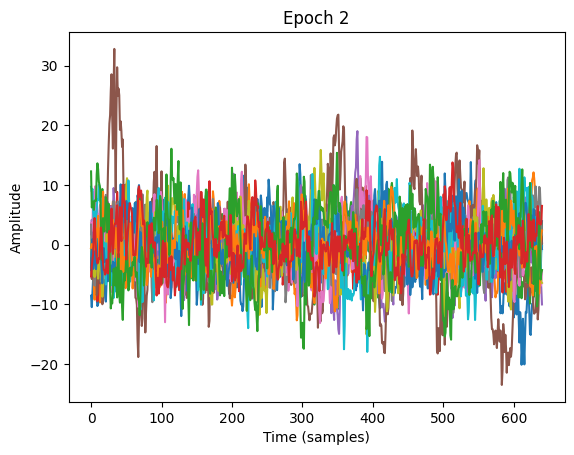

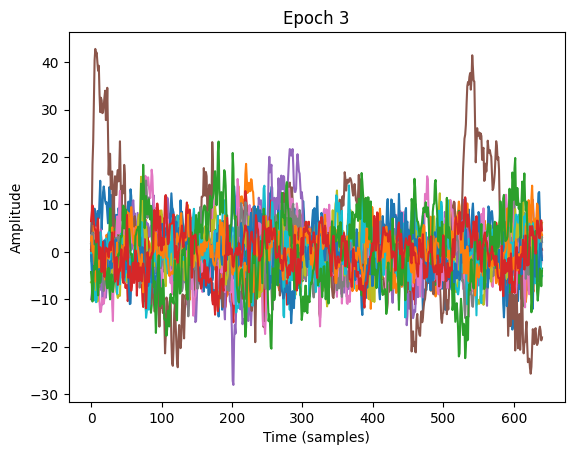

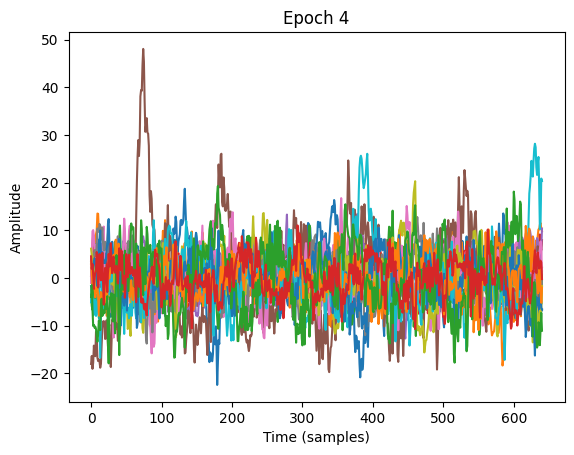

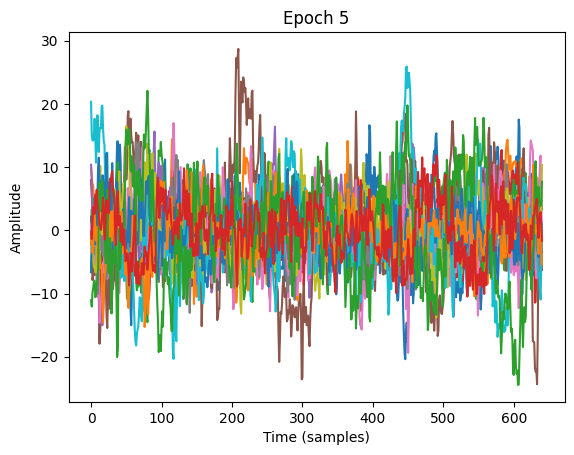

...

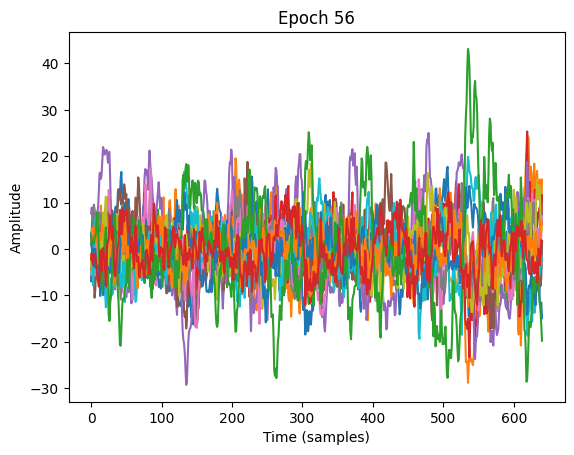

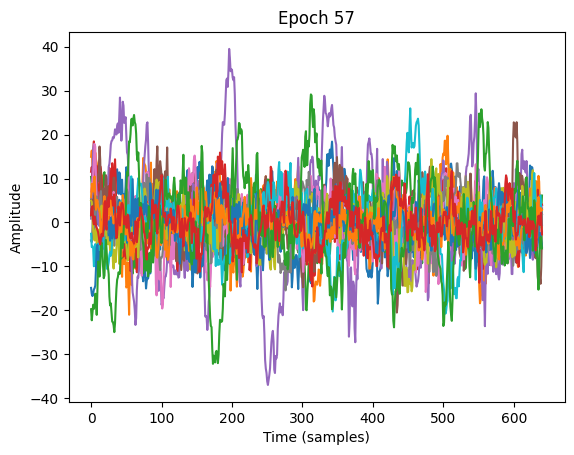

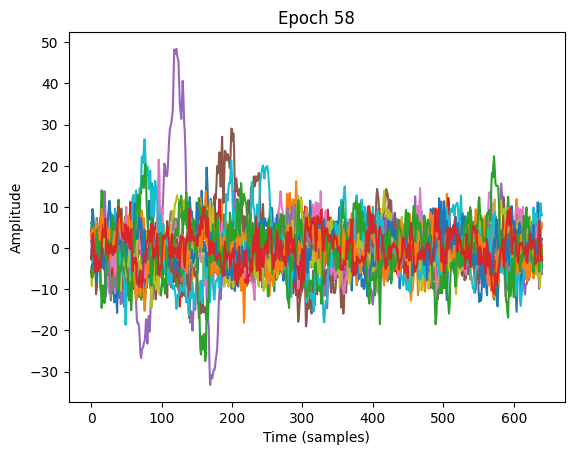

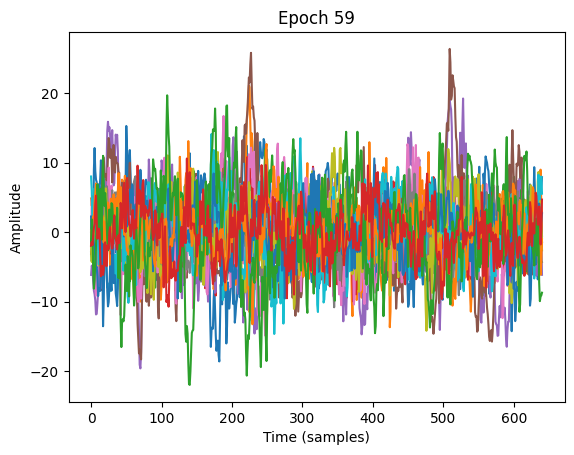

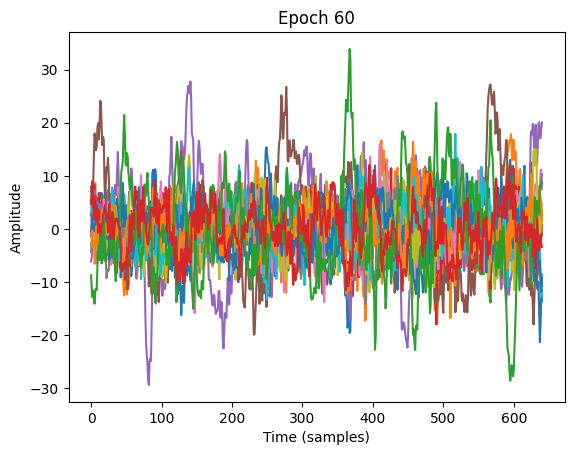

In [47]:
# Visualize individual epochs for manual inspection
for idx, epoch in enumerate(baseline_corrected_epochs_rh):
    plt.figure()
    plt.plot(epoch.T)
    plt.title(f"Epoch {idx+1}")
    plt.xlabel("Time (samples)")
    plt.ylabel("Amplitude")
    plt.show()


/Users/saiyarlagadda/.pyenv/versions/3.12.0/lib/python3.12/site-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'Series.swapaxes' is deprecated and will be removed in a future version. Please use 'Series.transpose' instead.
  return bound(*args, **kwds)


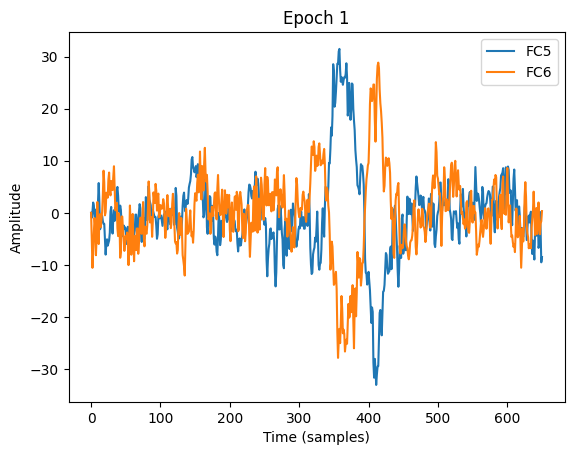

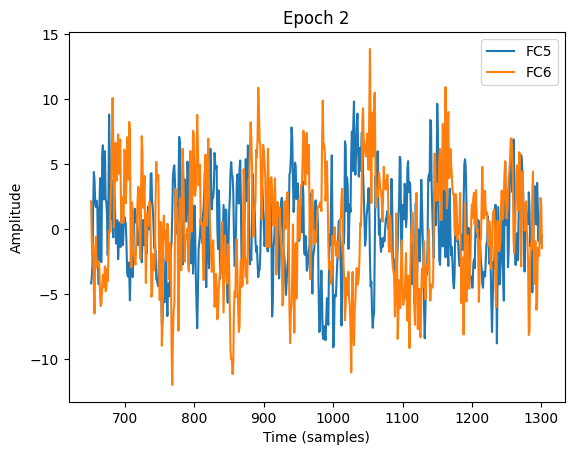

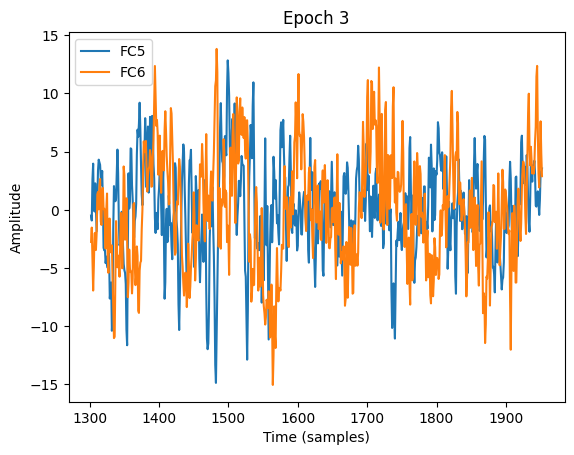

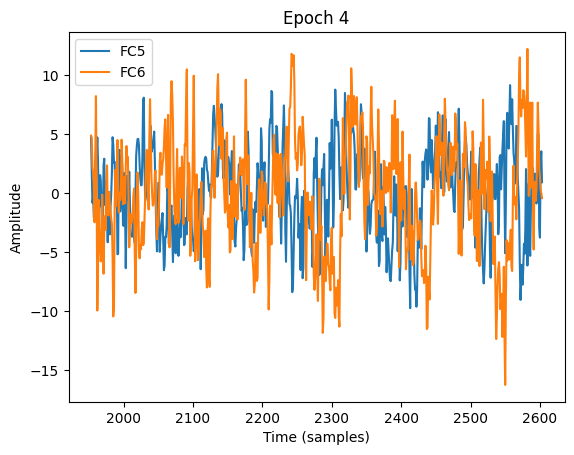

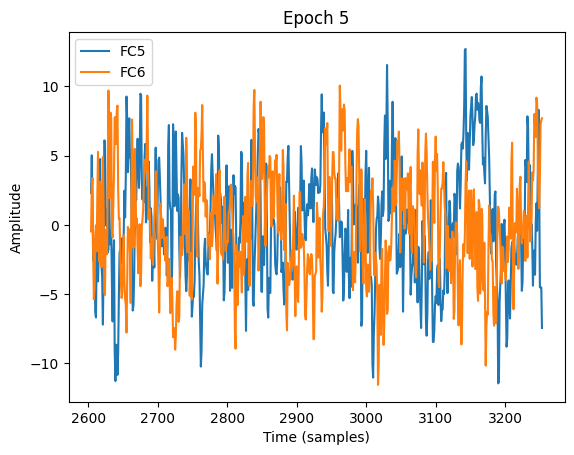

...

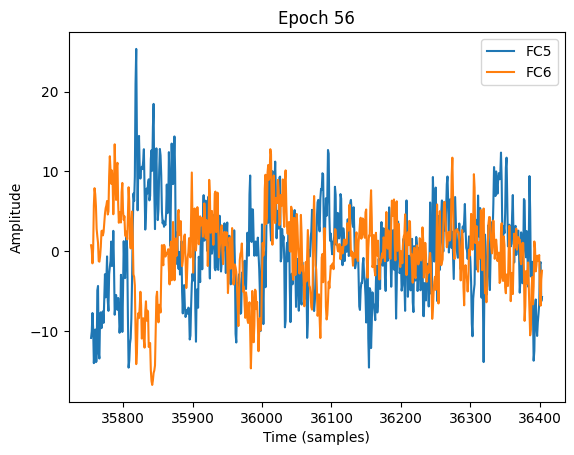

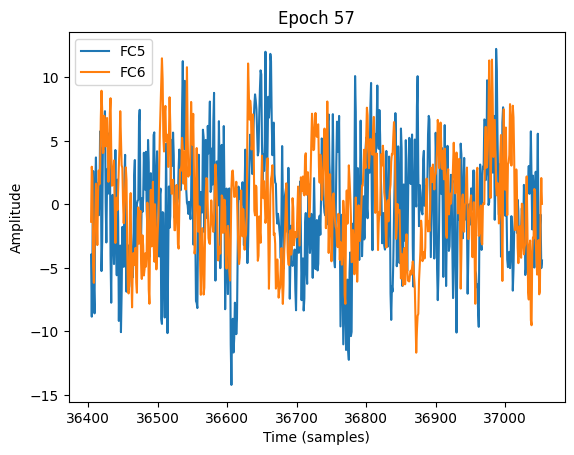

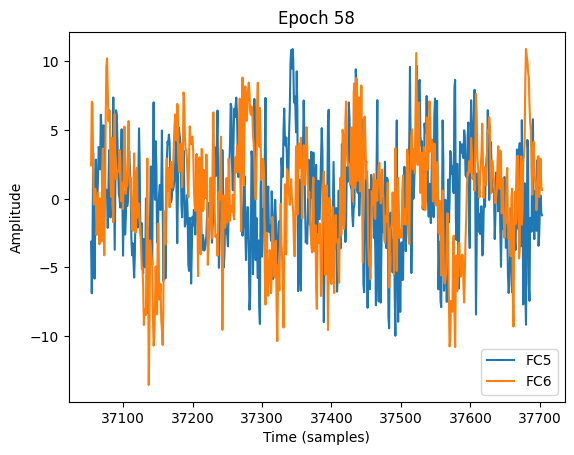

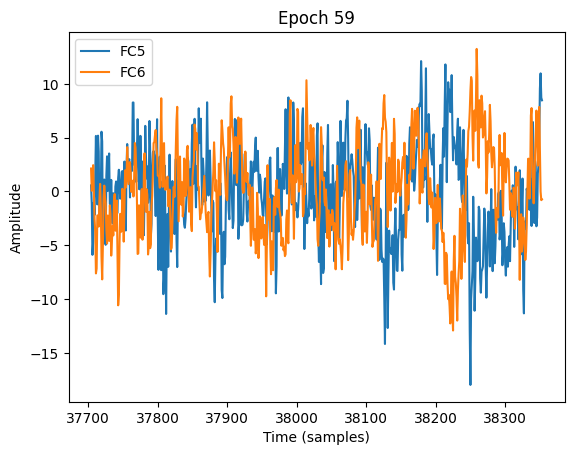

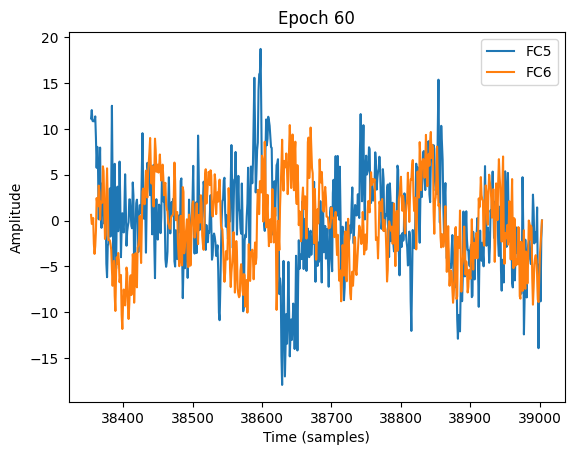

In [48]:

# Sample sampling rate (250 Hz)
sampling_rate = 128

# Function to epoch the data based on a specified duration (in seconds)
def epoch_data(data, duration_seconds):
    num_samples_per_epoch = int(duration_seconds * sampling_rate)
    num_epochs = len(data) // num_samples_per_epoch
    epochs = np.array_split(data, num_epochs)
    return epochs

# Specify the duration of each epoch in seconds
epoch_duration_seconds = 5

# Epoch the 'FC5' and 'FC6' data
epochs_fc5 = epoch_data(data_rh['EEG.FC5'], epoch_duration_seconds)
epochs_fc6 = epoch_data(data_rh['EEG.FC6'], epoch_duration_seconds)

# Visualize the epochs
for idx, (epoch_fc5, epoch_fc6) in enumerate(zip(epochs_fc5, epochs_fc6)):
    plt.figure()
    plt.plot(epoch_fc5, label='FC5')
    plt.plot(epoch_fc6, label='FC6')
    plt.title(f"Epoch {idx+1}")
    plt.xlabel("Time (samples)")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.show()


In [49]:
import pywt
import numpy as np

# Define parameters for wavelet transform
wavelet = 'db2'  # Choose a discrete wavelet, e.g., Daubechies 2
level = 4  # Choose the level of decomposition
mode = 'zero'  # Choose the extension mode for wavelet decomposition
axis = -1  # Choose the axis along which to apply wavelet transform

# Function to compute wavelet coefficients for each epoch
def compute_wavelet_coefficients(epoch_data, wavelet, level, mode, axis):
    coefficients = pywt.wavedec(epoch_data, wavelet, level=level, mode=mode, axis=axis)
    return coefficients

# Example EEG data (replace this with your actual EEG data)
# Assuming EEG data is stored in a pandas DataFrame named 'eeg_data'
# eeg_data = pd.read_csv(filepath, skiprows=1)

# Example DataFrame with random EEG-like data
num_epochs = 60  # Number of epochs
num_channels = 14  # Number of EEG channels per epoch
num_samples_per_epoch = 641  # Number of time points per epoch
# eeg_data_only = np.random.randn(num_epochs, num_channels, num_samples_per_epoch)

# Perform wavelet transform for each epoch
wavelet_coefficients = []
max_epoch_length = 0
for epoch_data in baseline_corrected_epochs_rh:
    epoch_coefficients = compute_wavelet_coefficients(epoch_data, wavelet, level, mode, axis)
    wavelet_coefficients.append(epoch_coefficients)
    # Update the maximum length of epochs
    max_epoch_length = max(max_epoch_length, epoch_data.shape[1])

# Pad or truncate each epoch to the length of the longest epoch
padded_wavelet_coefficients = []
for epoch_coeffs in wavelet_coefficients:
    padded_epoch_coeffs = [np.pad(coef, ((0, 0), (0, max_epoch_length - coef.shape[1])), mode='constant') for coef in epoch_coeffs]
    padded_wavelet_coefficients.append(padded_epoch_coeffs)

# Convert the list of padded wavelet coefficients to a numpy array
wavelet_coefficients_array_rh = np.array(padded_wavelet_coefficients)

# Now 'wavelet_coefficients_array' contains the wavelet coefficients for each epoch,
# with each epoch padded or truncated to the length of the longest epoch


In [50]:
print("Shape of wavelet coefficients array:", wavelet_coefficients_array_rh.shape)


Shape of wavelet coefficients array: (60, 5, 14, 641)


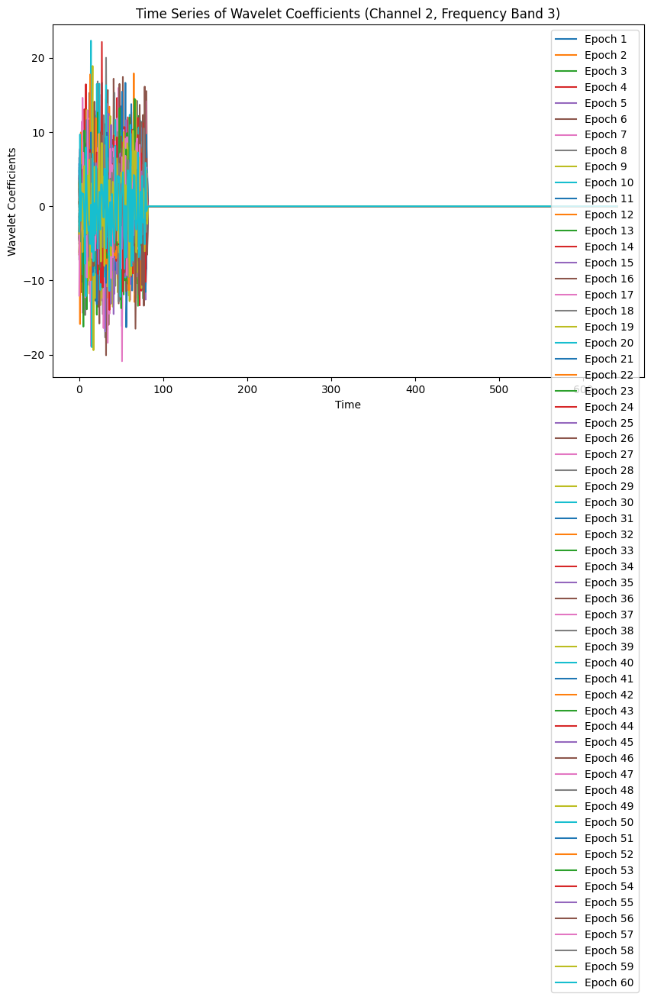

In [51]:
import matplotlib.pyplot as plt

# Select a specific channel and frequency band for analysis
channel_index = 1  # Index of the channel (e.g., 0 for the first channel)
frequency_band_index = 2  # Index of the frequency band (e.g., 0 for the first frequency band)

# Extract wavelet coefficients for the selected channel and frequency band
wavelet_coefficients_channel_band = wavelet_coefficients_array_rh[:, frequency_band_index, channel_index, :]

# Plot the time series of wavelet coefficients
plt.figure(figsize=(10, 6))
for epoch_index in range(wavelet_coefficients_channel_band.shape[0]):
    plt.plot(wavelet_coefficients_channel_band[epoch_index, :], label=f'Epoch {epoch_index + 1}')

plt.title(f'Time Series of Wavelet Coefficients (Channel {channel_index + 1}, Frequency Band {frequency_band_index + 1})')
plt.xlabel('Time')
plt.ylabel('Wavelet Coefficients')
plt.legend()
plt.show()


Epoch 1: Shape = (5, 14, 641)


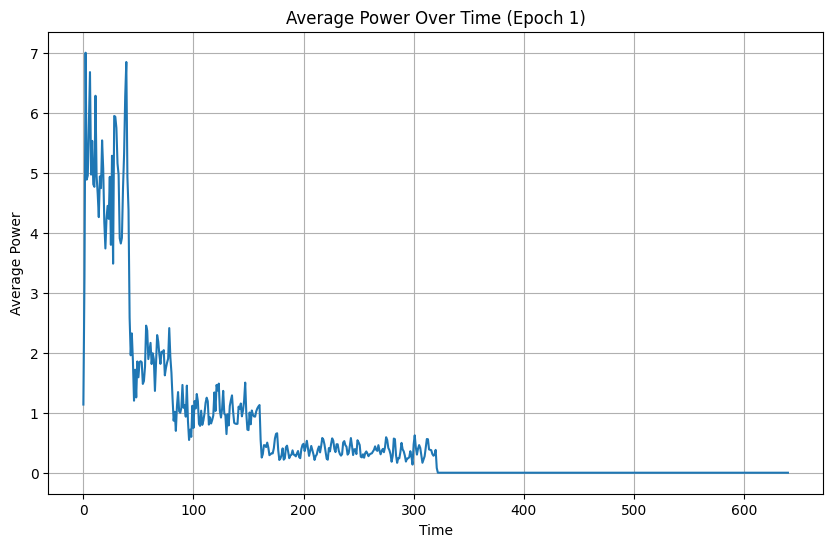

Epoch 2: Shape = (5, 14, 641)


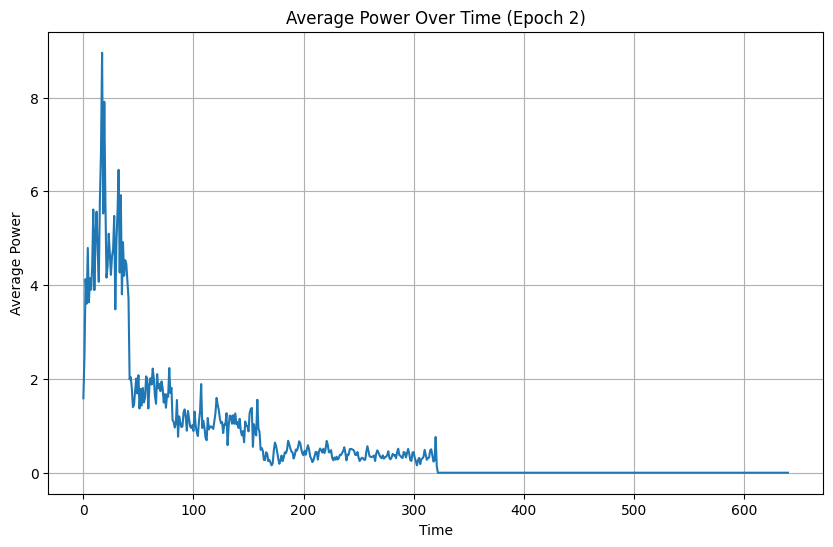

Epoch 3: Shape = (5, 14, 641)


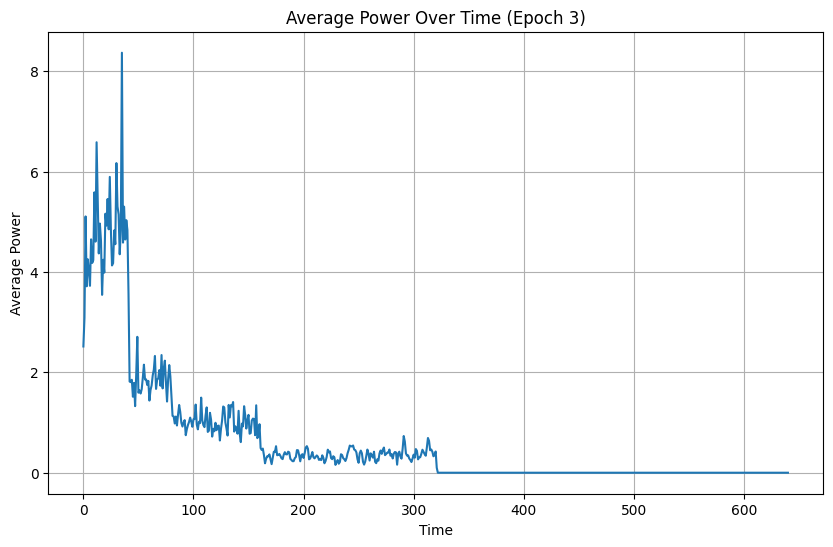

Epoch 4: Shape = (5, 14, 641)


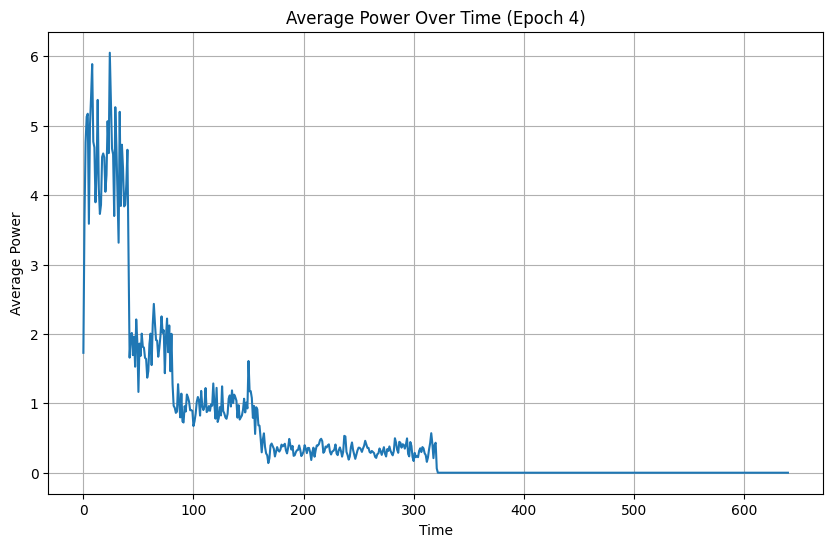

Epoch 5: Shape = (5, 14, 641)


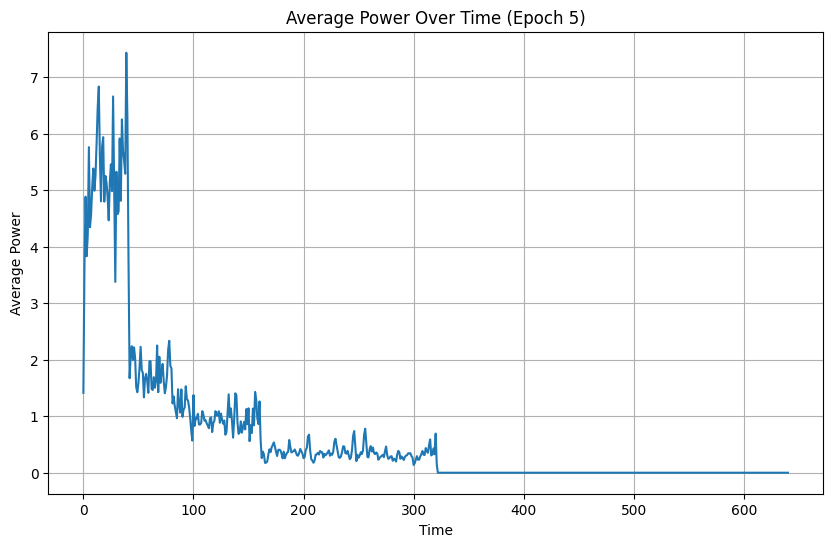

Epoch 6: Shape = (5, 14, 641)


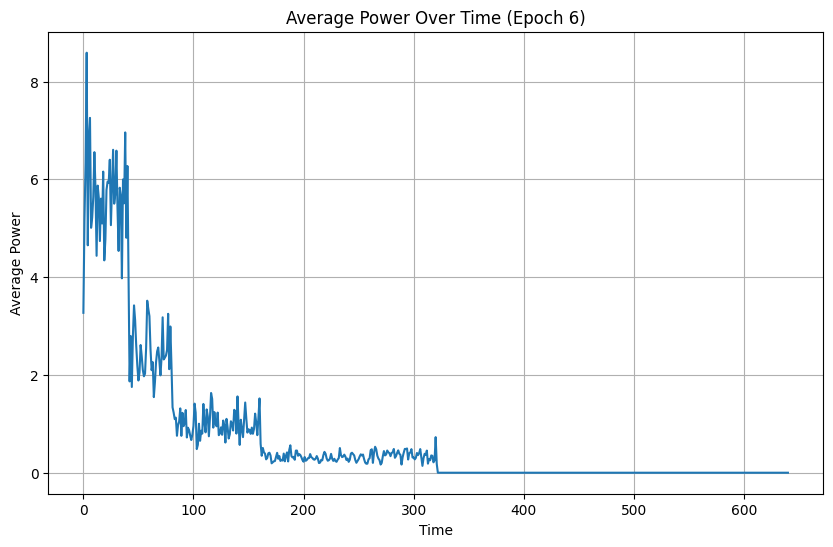

Epoch 7: Shape = (5, 14, 641)


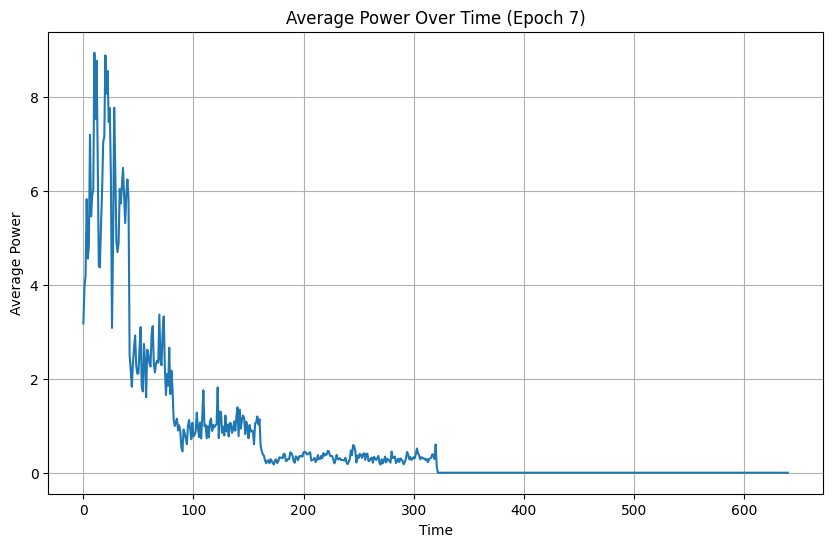

Epoch 8: Shape = (5, 14, 641)


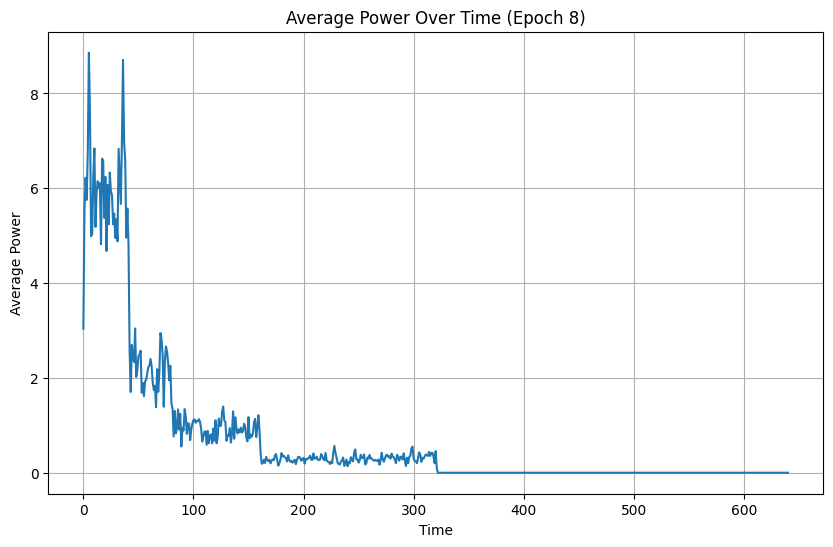

Epoch 9: Shape = (5, 14, 641)


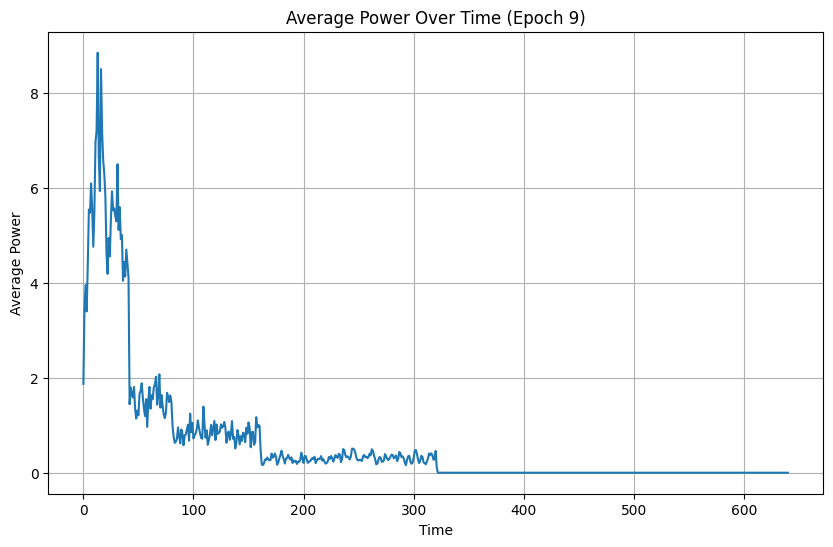

Epoch 10: Shape = (5, 14, 641)


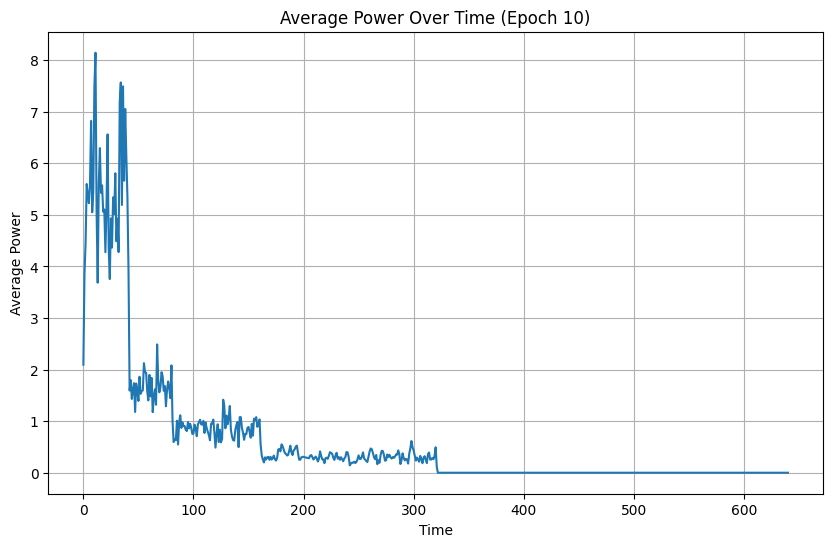

Epoch 11: Shape = (5, 14, 641)


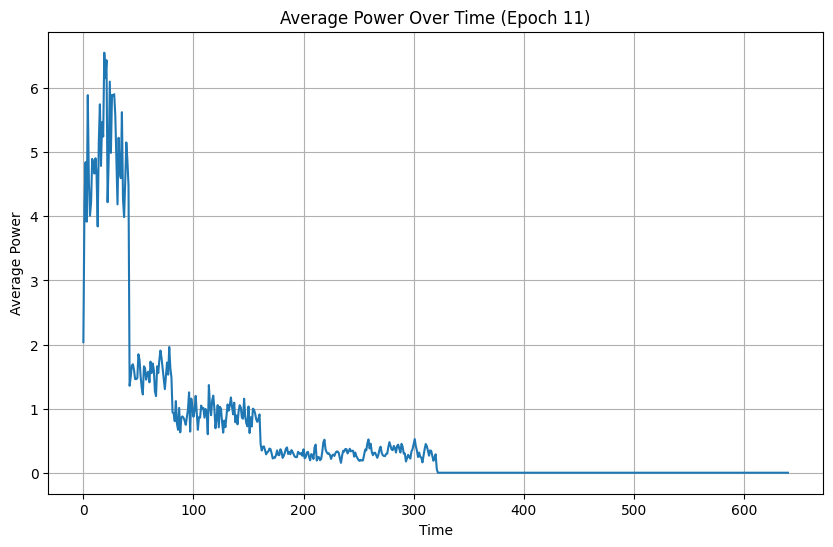

Epoch 12: Shape = (5, 14, 641)


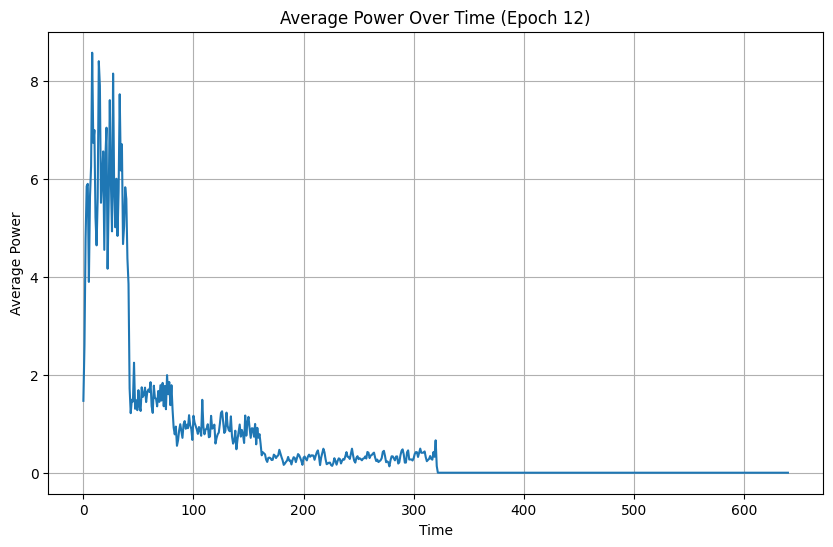

Epoch 13: Shape = (5, 14, 641)


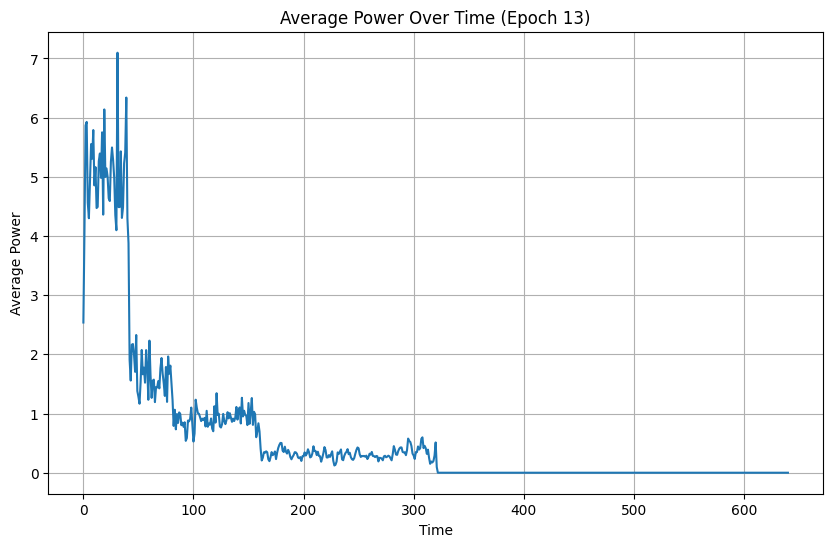

Epoch 14: Shape = (5, 14, 641)


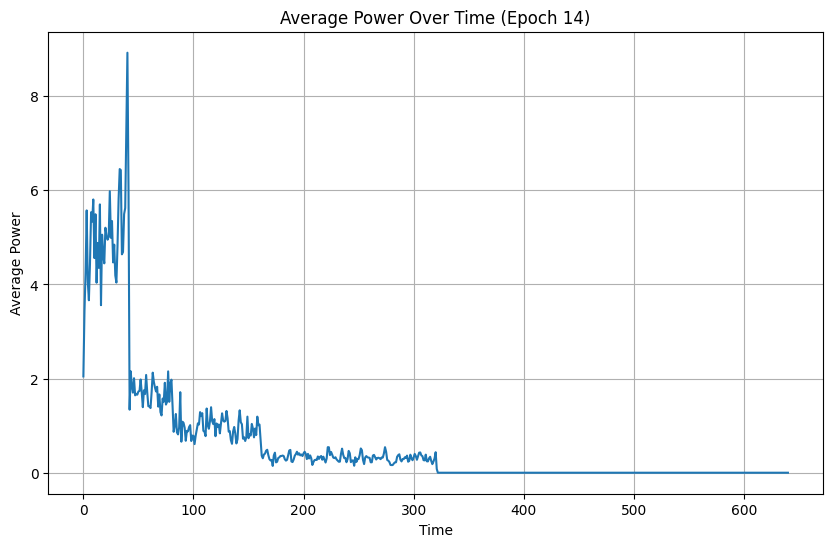

Epoch 15: Shape = (5, 14, 641)


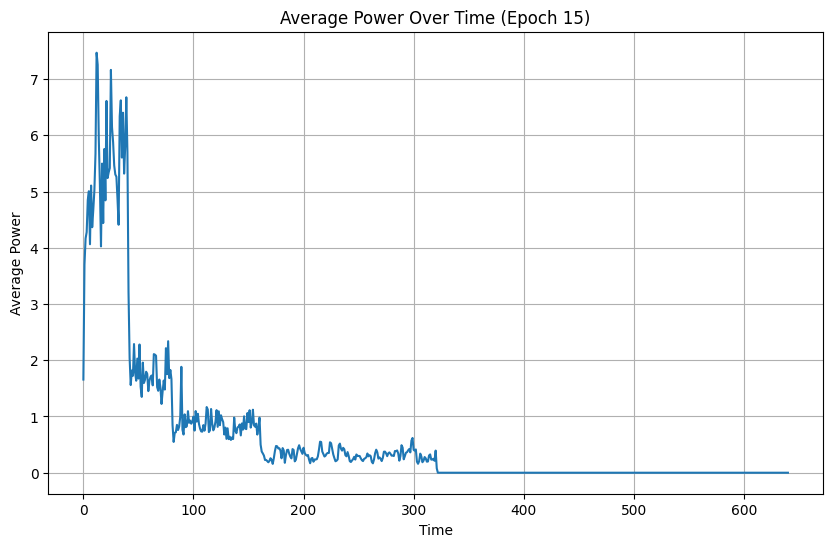

Epoch 16: Shape = (5, 14, 641)


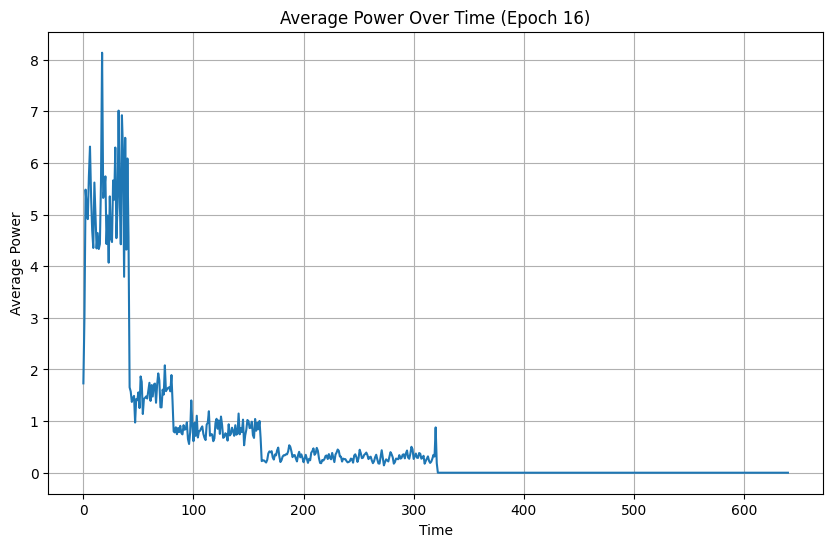

Epoch 17: Shape = (5, 14, 641)


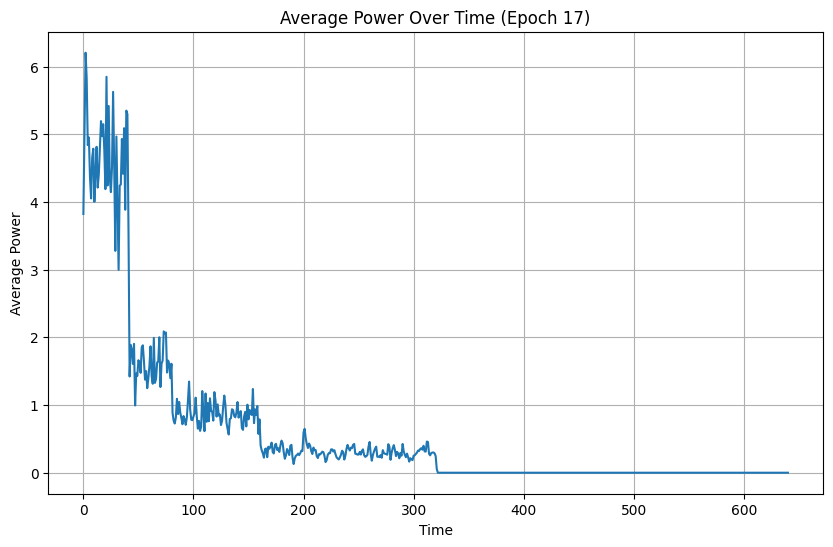

Epoch 18: Shape = (5, 14, 641)


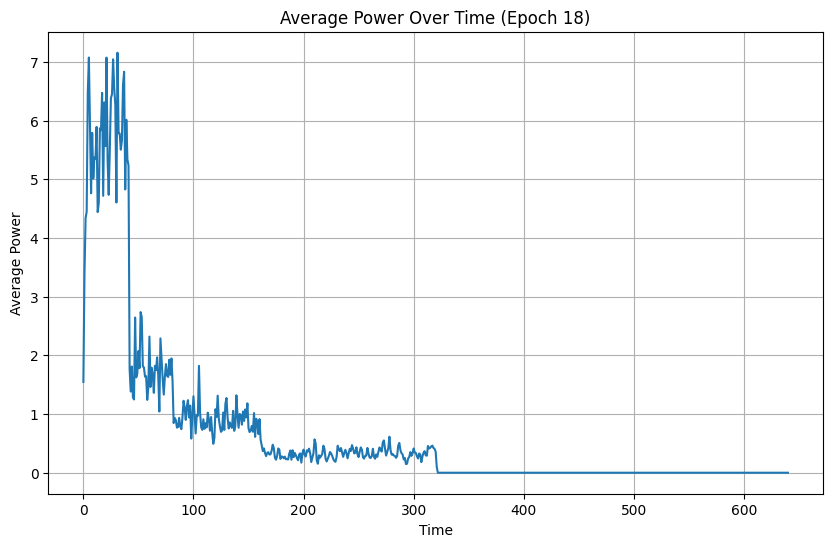

Epoch 19: Shape = (5, 14, 641)


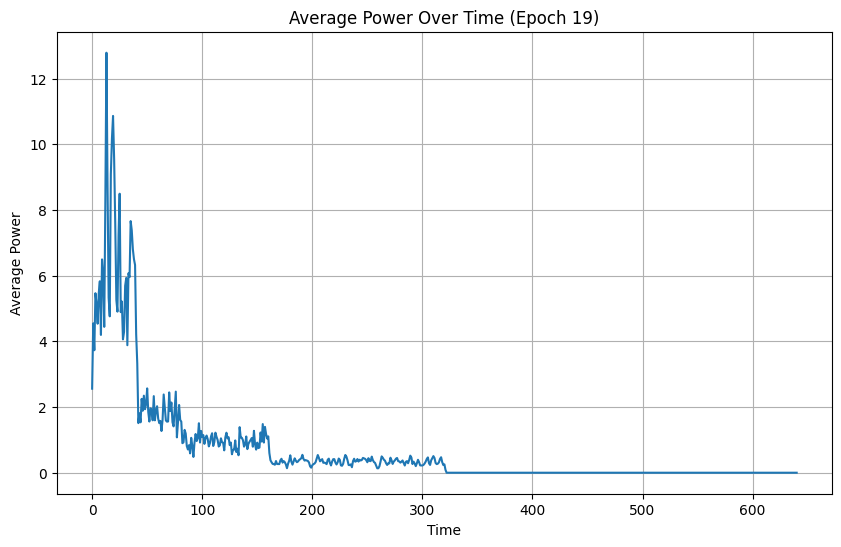

Epoch 20: Shape = (5, 14, 641)


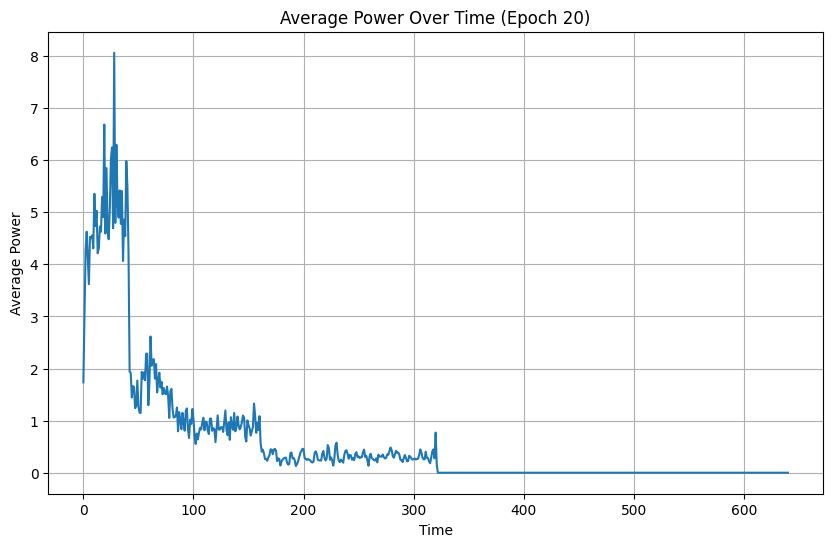

Epoch 21: Shape = (5, 14, 641)


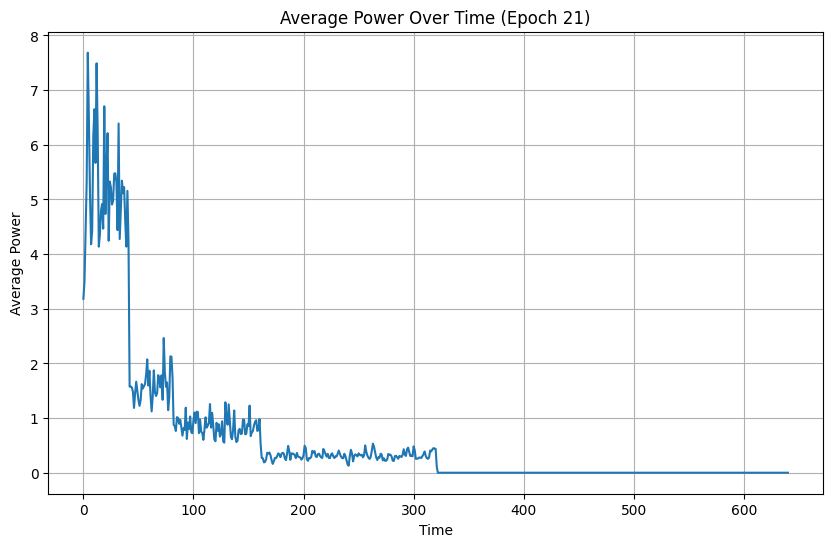

Epoch 22: Shape = (5, 14, 641)


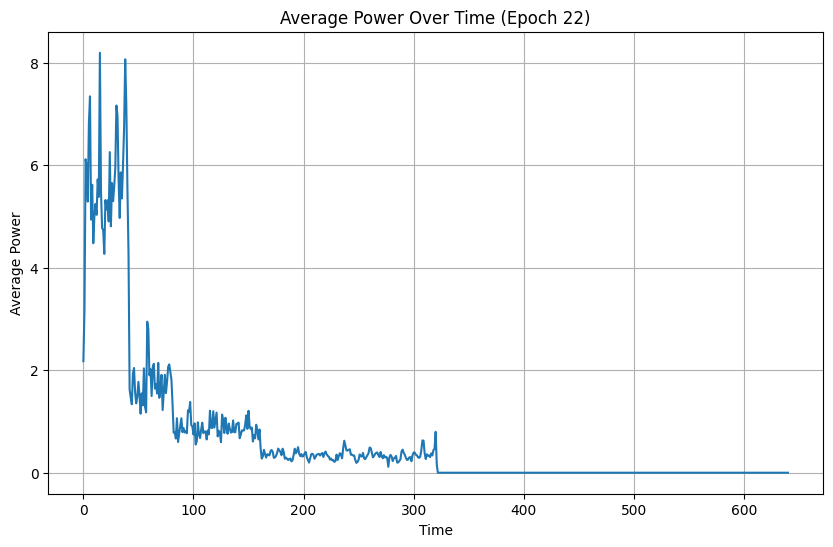

Epoch 23: Shape = (5, 14, 641)


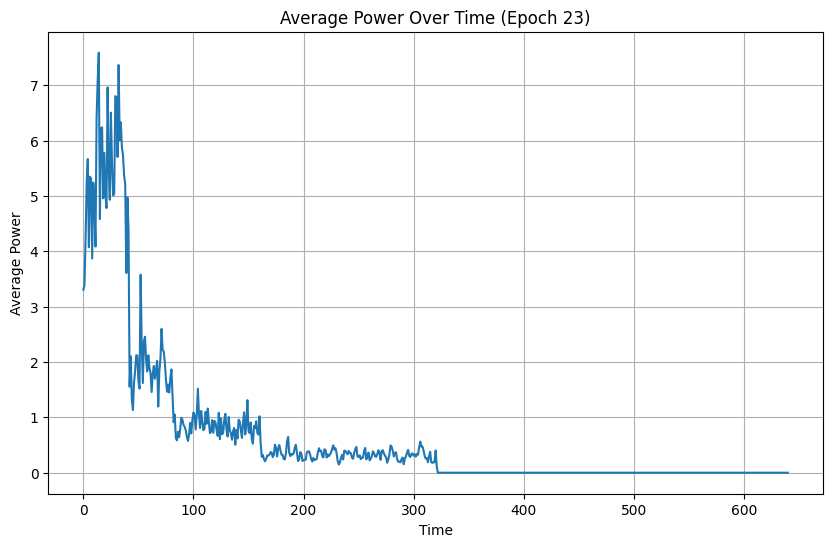

Epoch 24: Shape = (5, 14, 641)


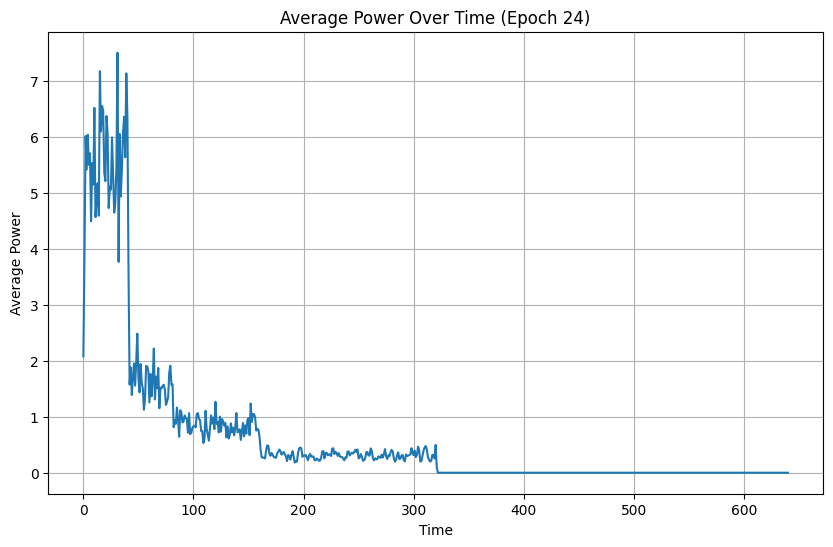

Epoch 25: Shape = (5, 14, 641)


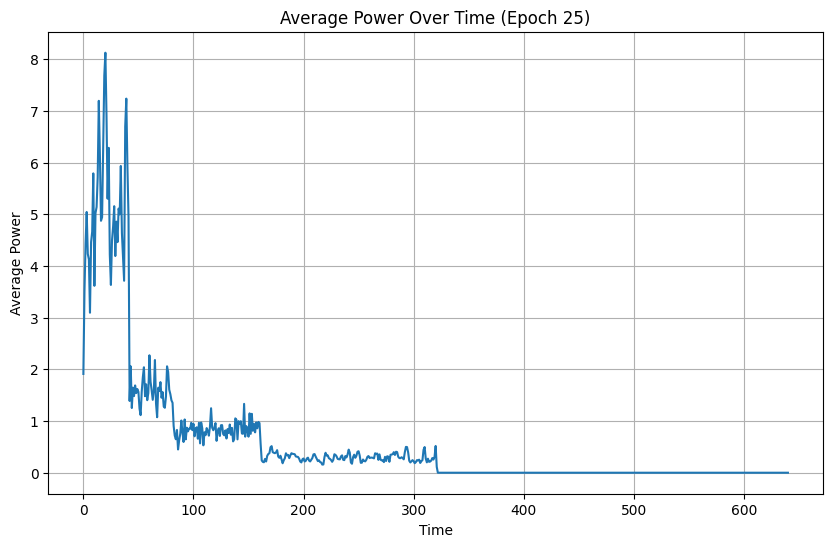

Epoch 26: Shape = (5, 14, 641)


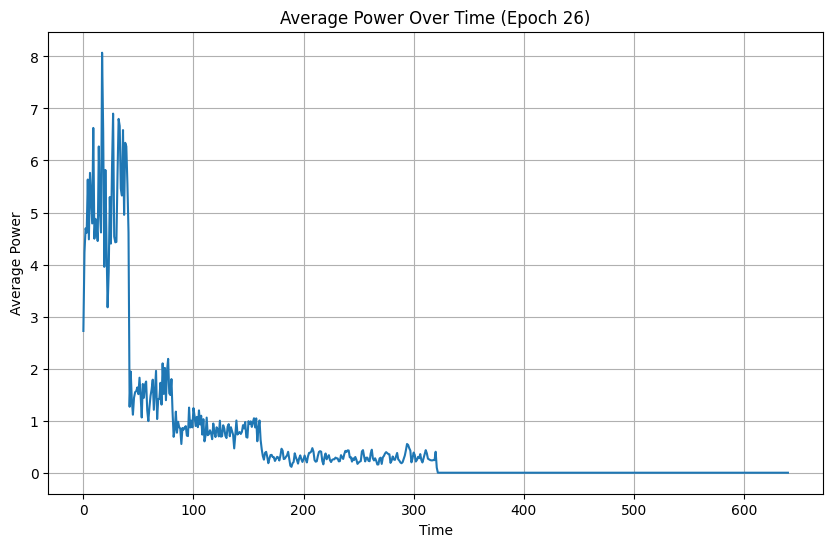

Epoch 27: Shape = (5, 14, 641)


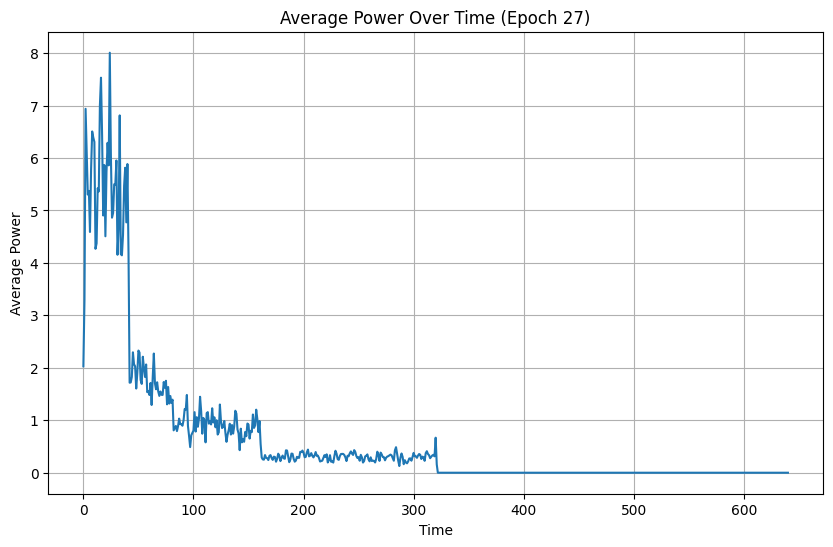

Epoch 28: Shape = (5, 14, 641)


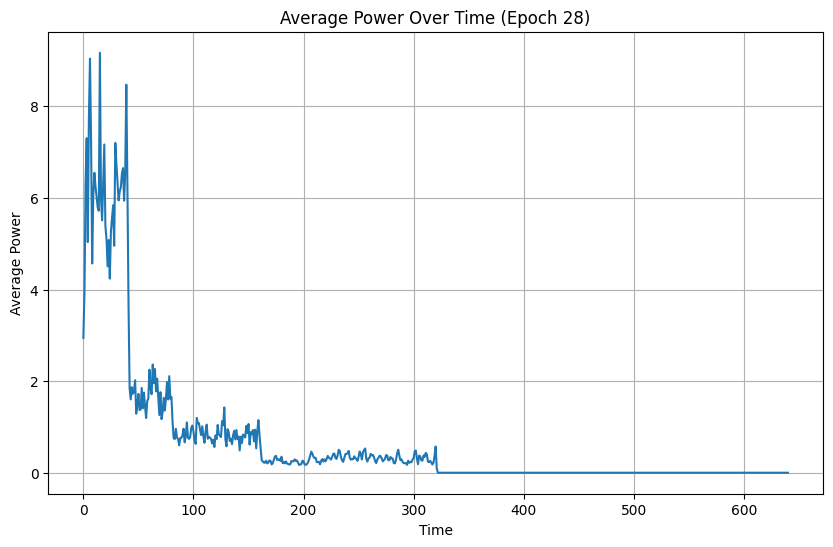

Epoch 29: Shape = (5, 14, 641)


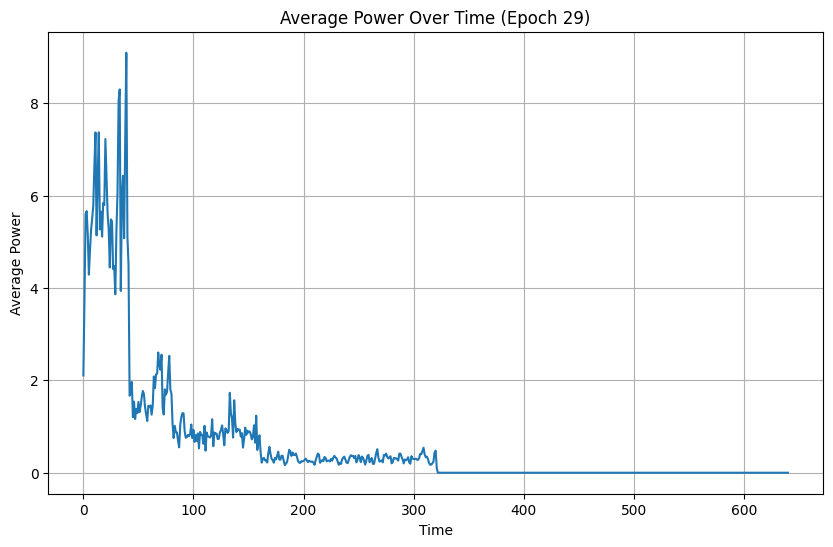

Epoch 30: Shape = (5, 14, 641)


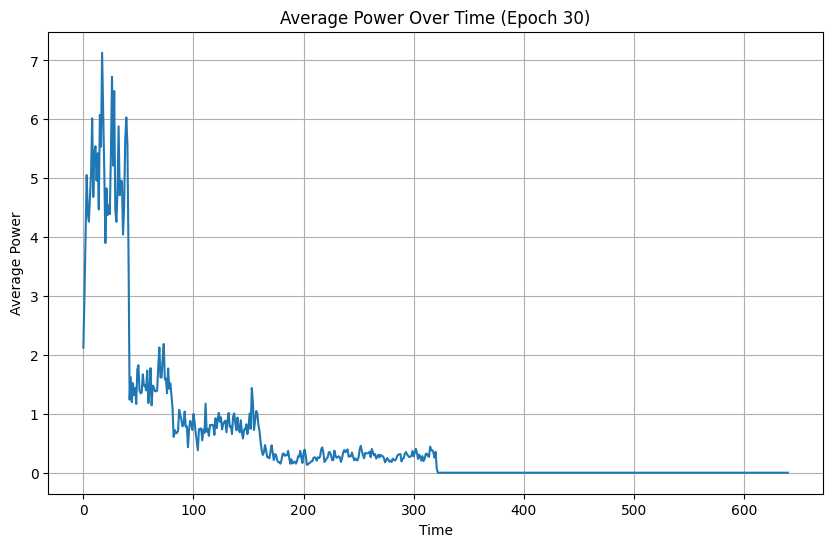

Epoch 31: Shape = (5, 14, 641)


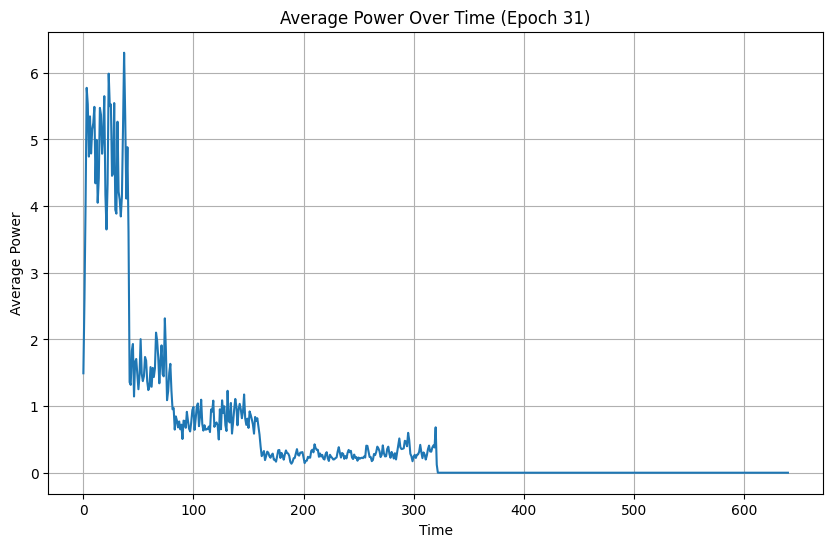

Epoch 32: Shape = (5, 14, 641)


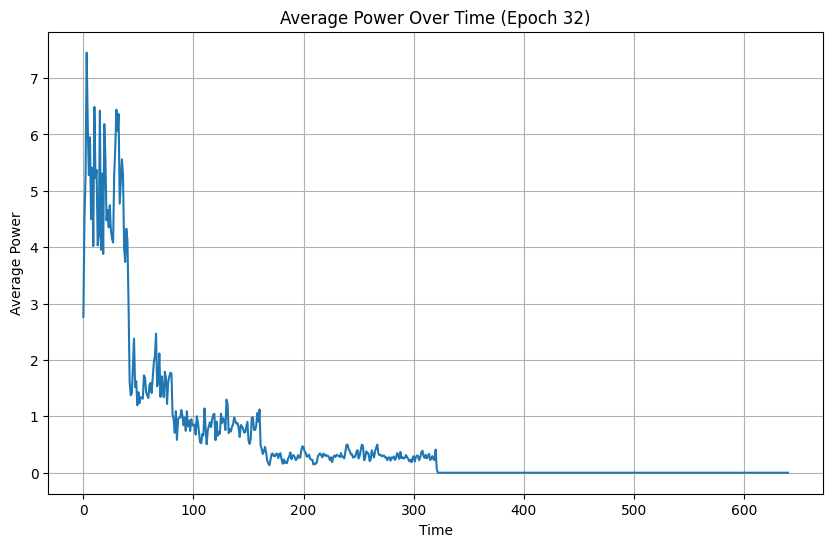

Epoch 33: Shape = (5, 14, 641)


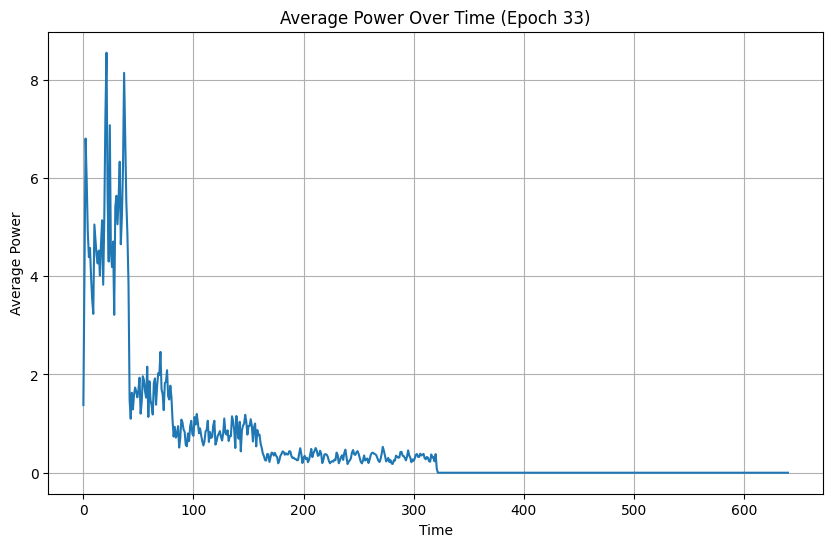

Epoch 34: Shape = (5, 14, 641)


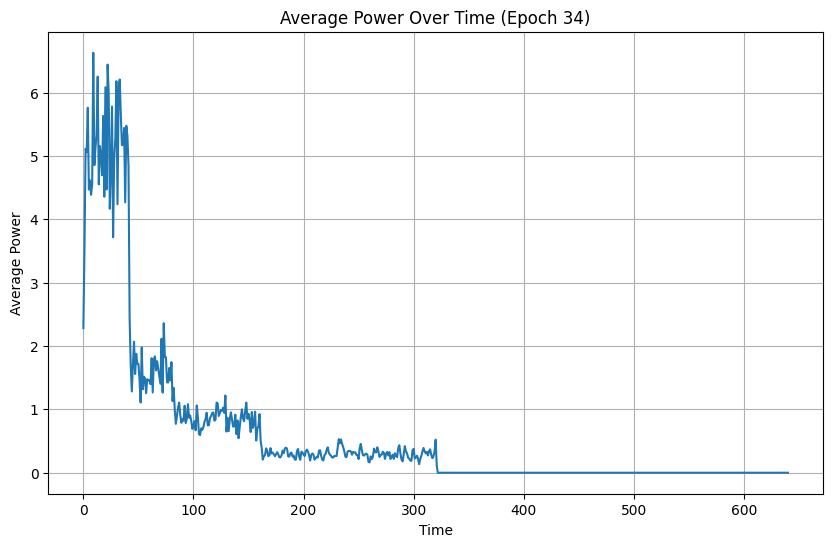

Epoch 35: Shape = (5, 14, 641)


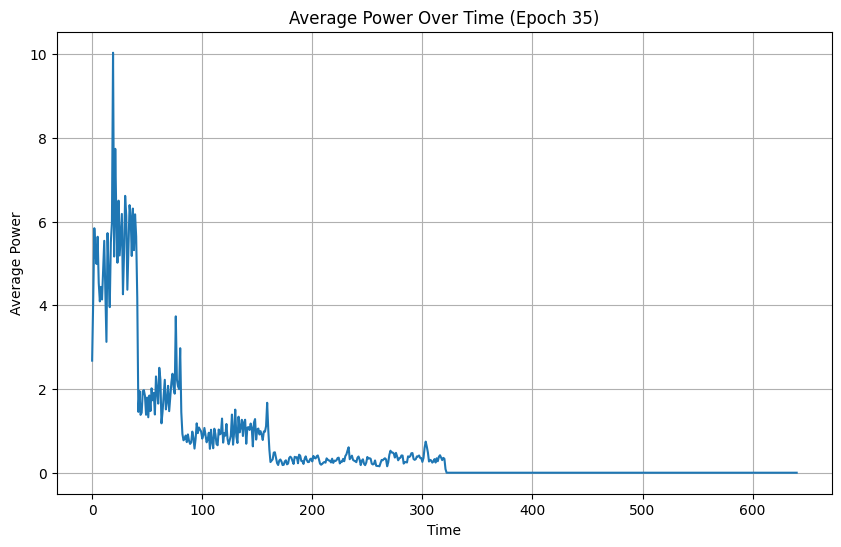

Epoch 36: Shape = (5, 14, 641)


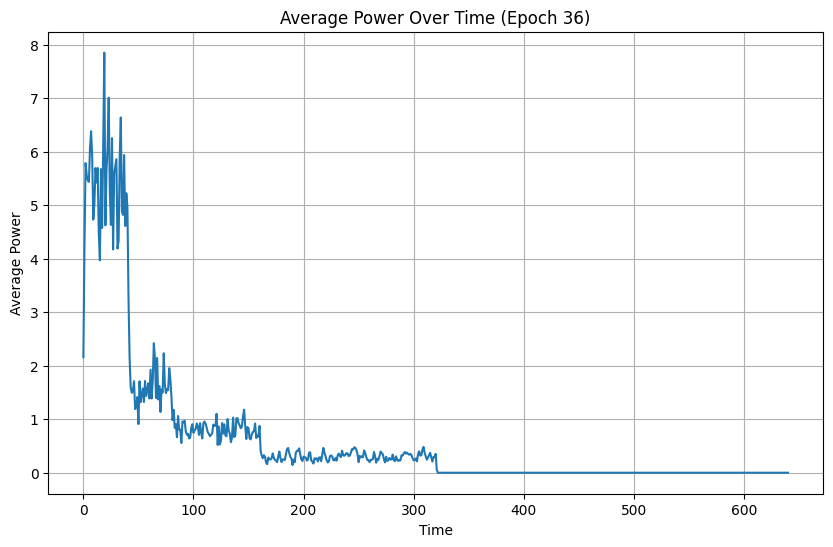

Epoch 37: Shape = (5, 14, 641)


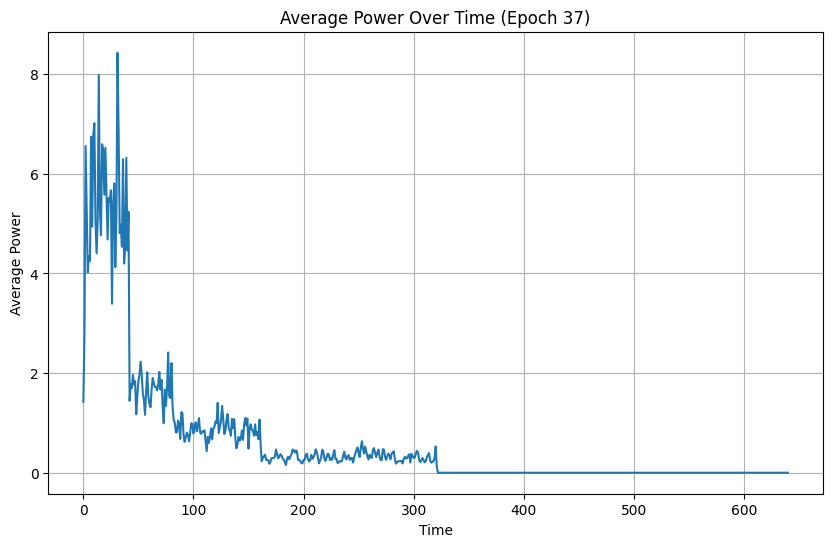

Epoch 38: Shape = (5, 14, 641)


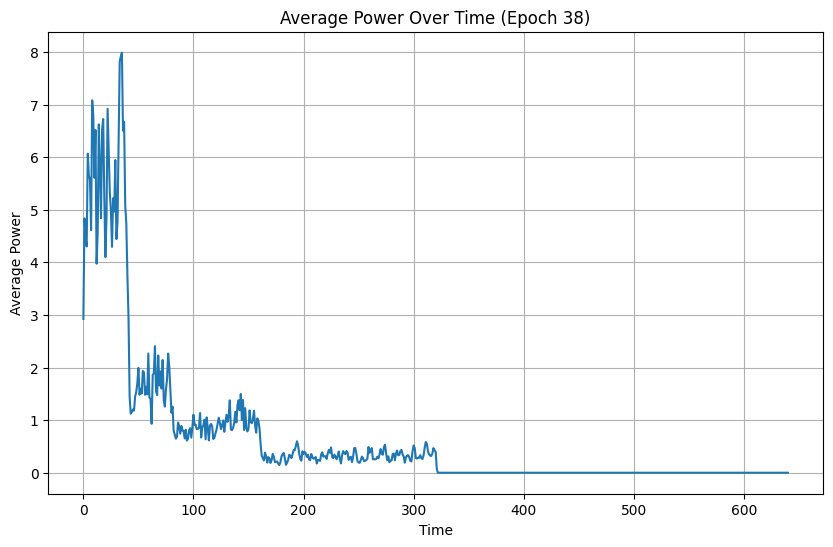

Epoch 39: Shape = (5, 14, 641)


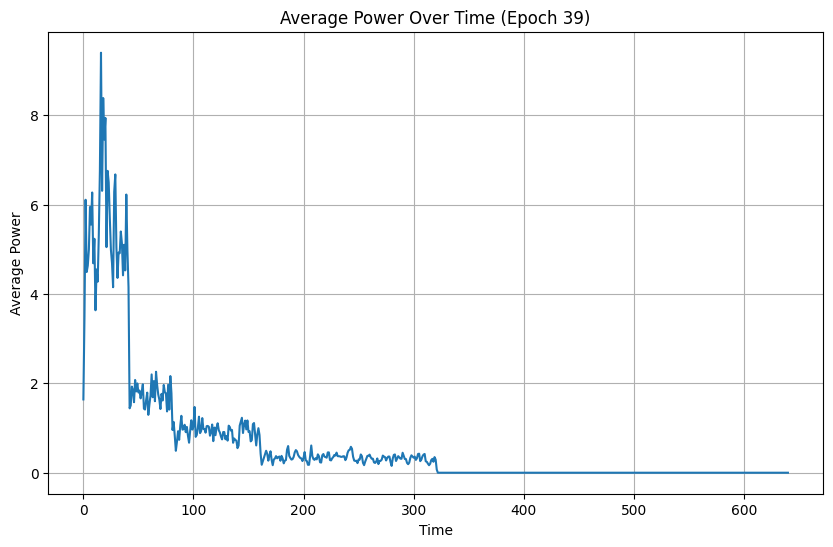

Epoch 40: Shape = (5, 14, 641)


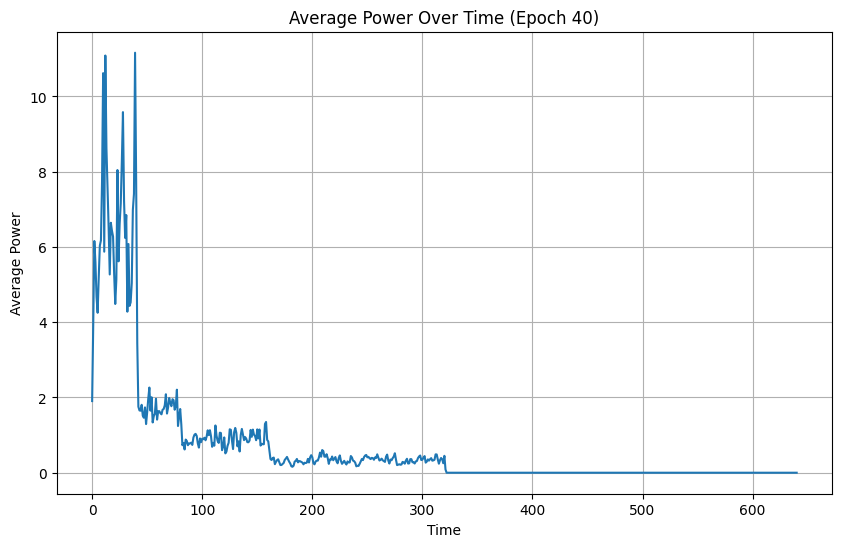

Epoch 41: Shape = (5, 14, 641)


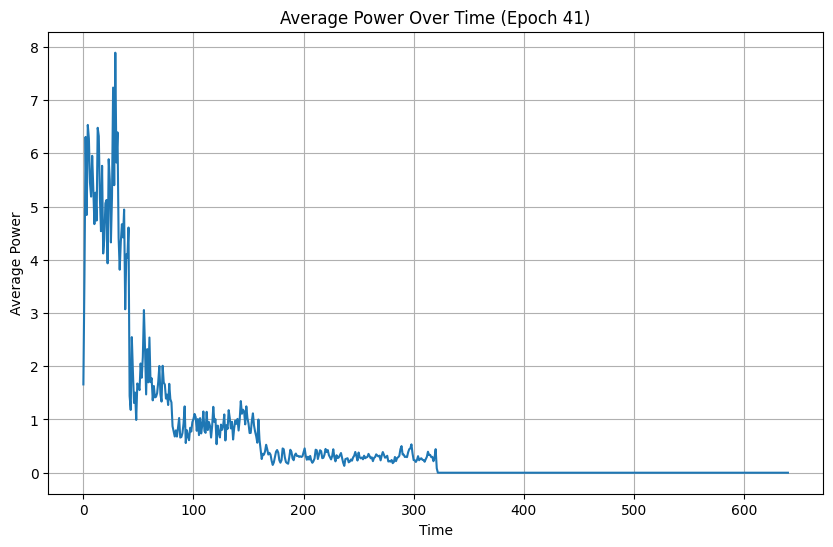

Epoch 42: Shape = (5, 14, 641)


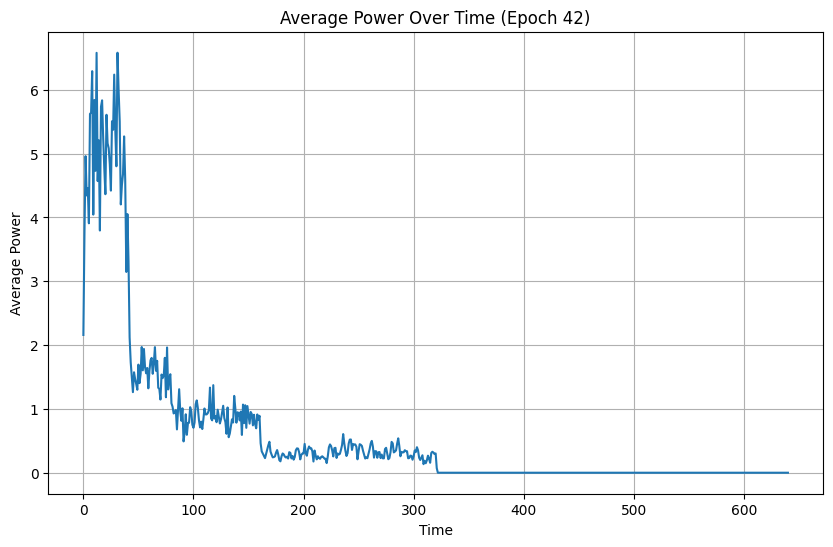

Epoch 43: Shape = (5, 14, 641)


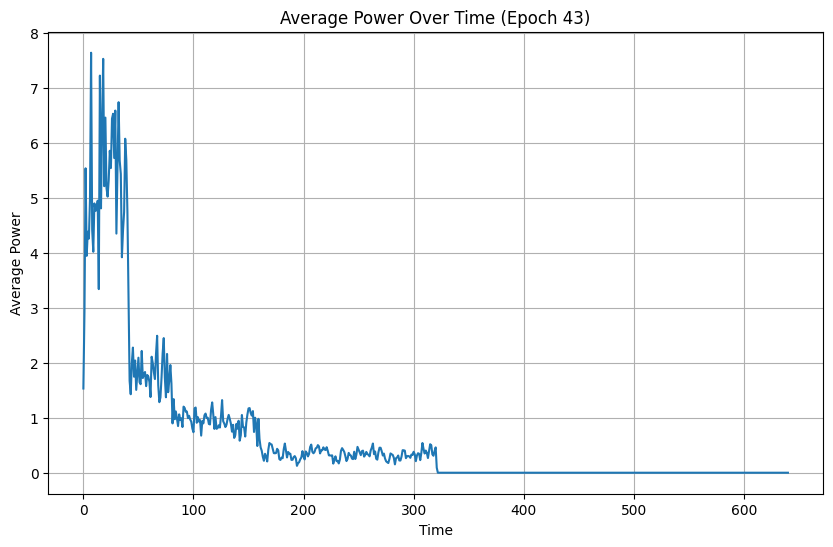

Epoch 44: Shape = (5, 14, 641)


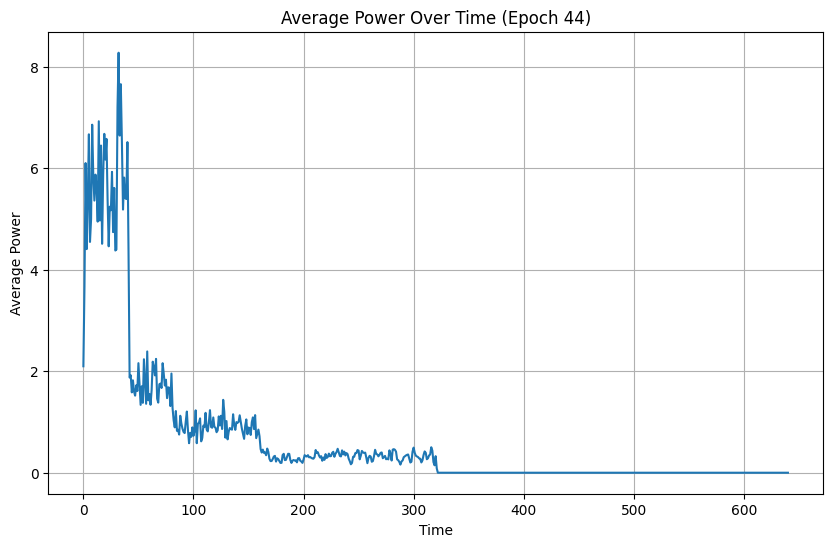

Epoch 45: Shape = (5, 14, 641)


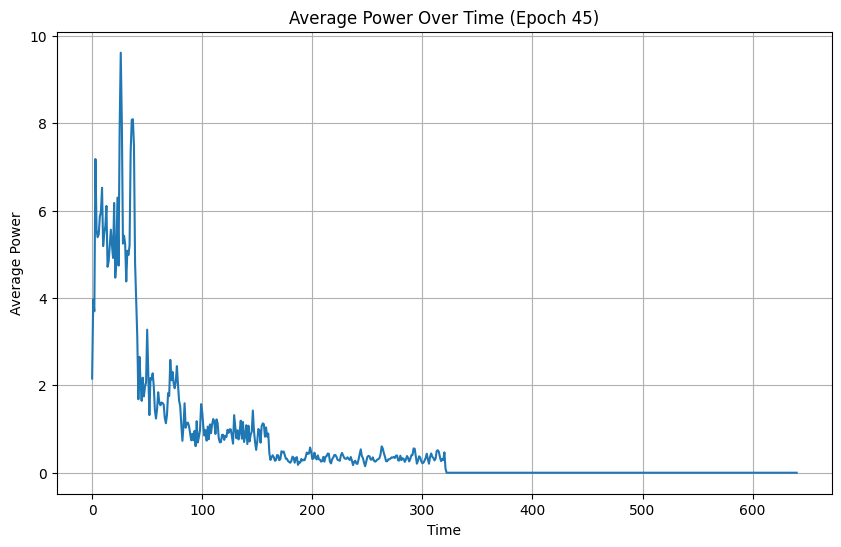

Epoch 46: Shape = (5, 14, 641)


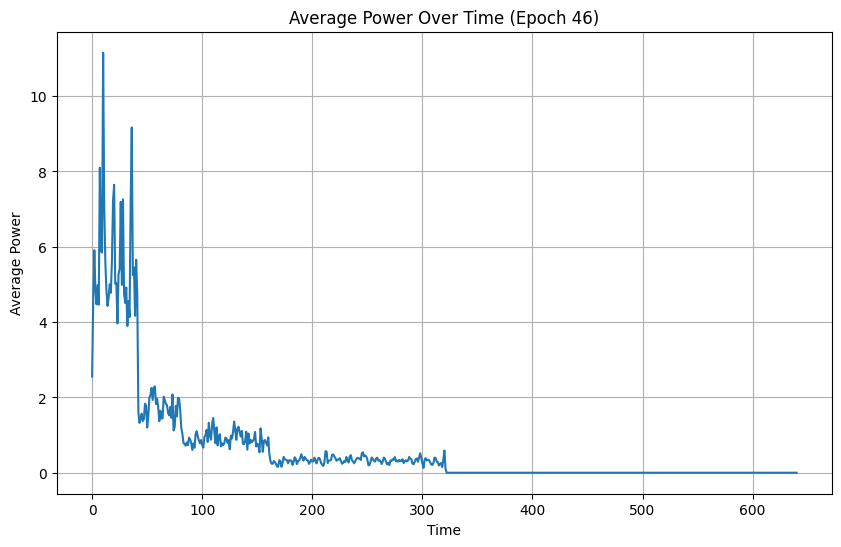

Epoch 47: Shape = (5, 14, 641)


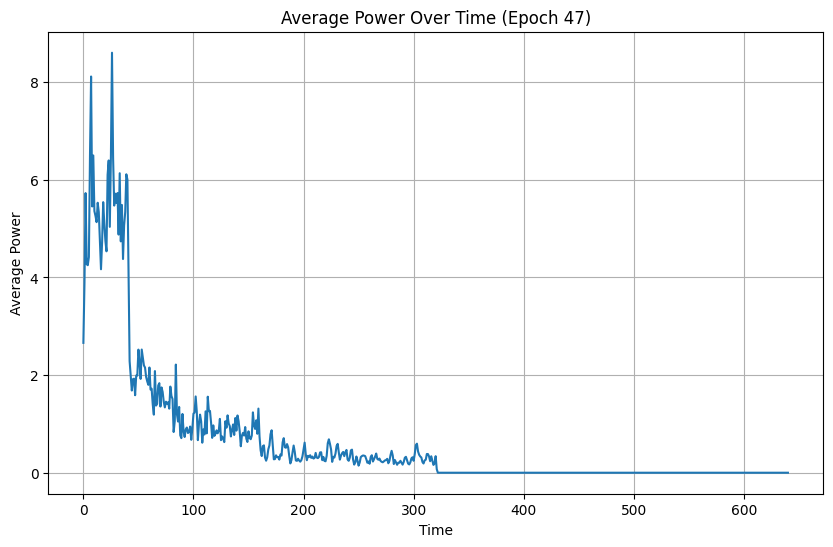

Epoch 48: Shape = (5, 14, 641)


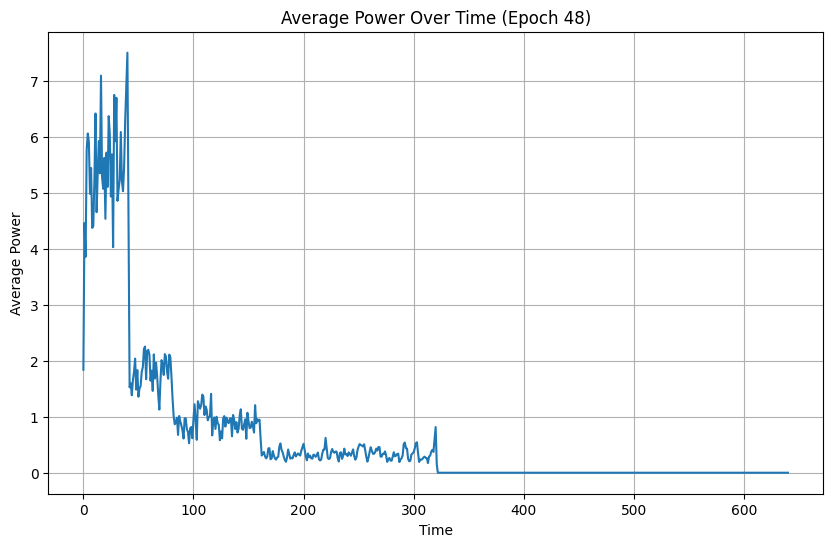

Epoch 49: Shape = (5, 14, 641)


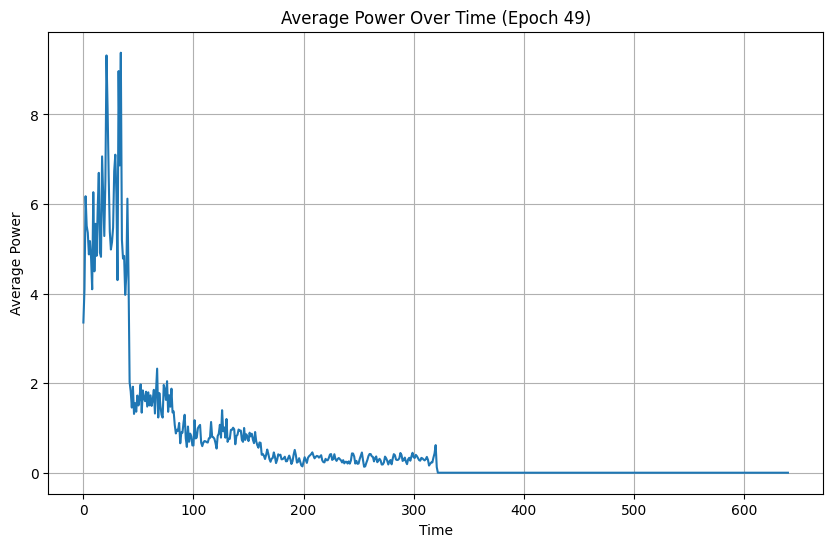

Epoch 50: Shape = (5, 14, 641)


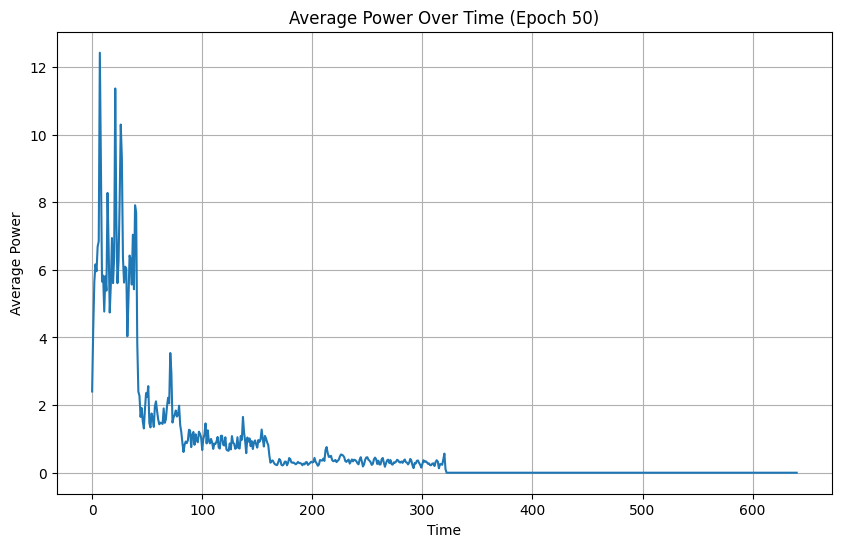

Epoch 51: Shape = (5, 14, 641)


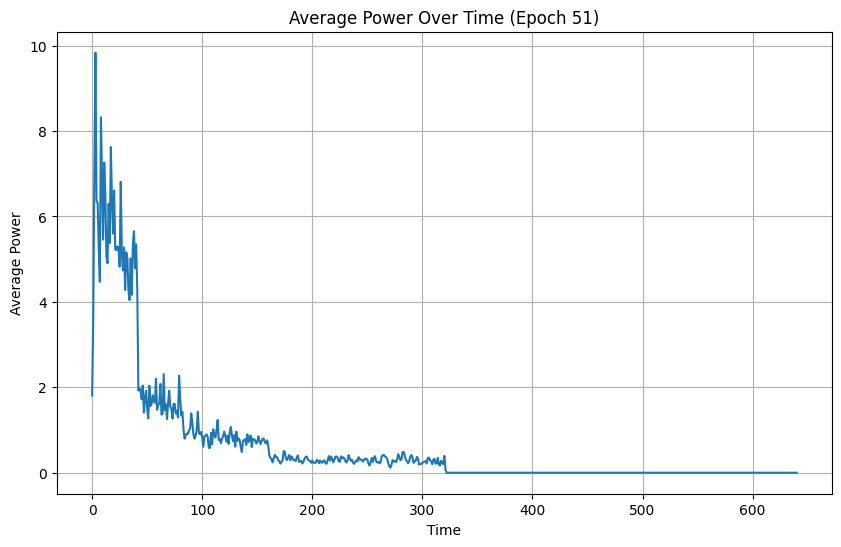

Epoch 52: Shape = (5, 14, 641)


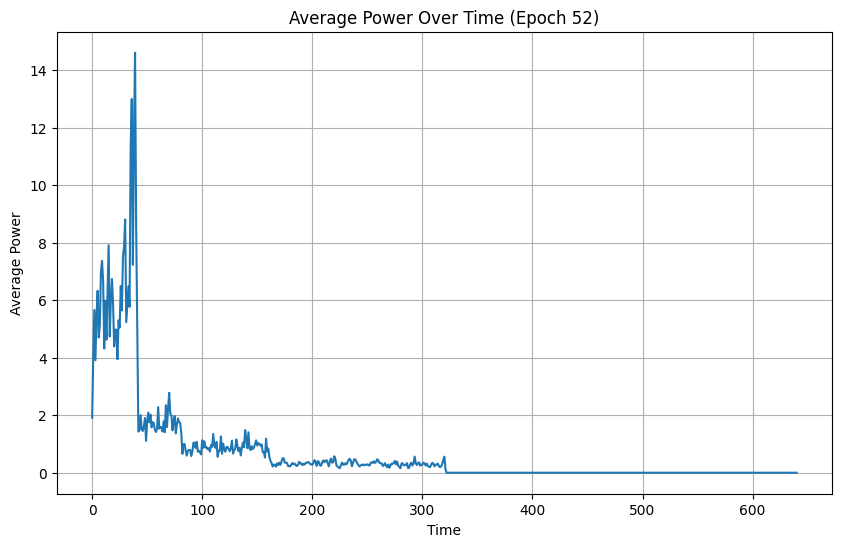

Epoch 53: Shape = (5, 14, 641)


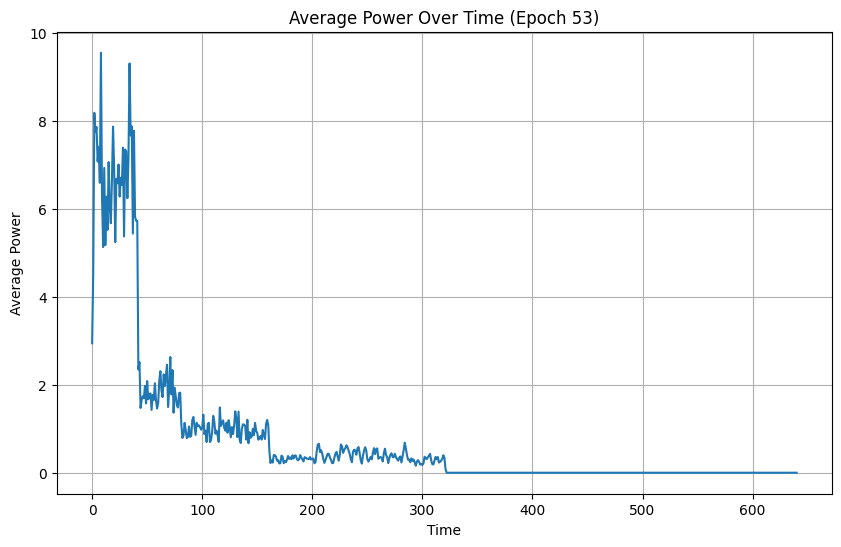

Epoch 54: Shape = (5, 14, 641)


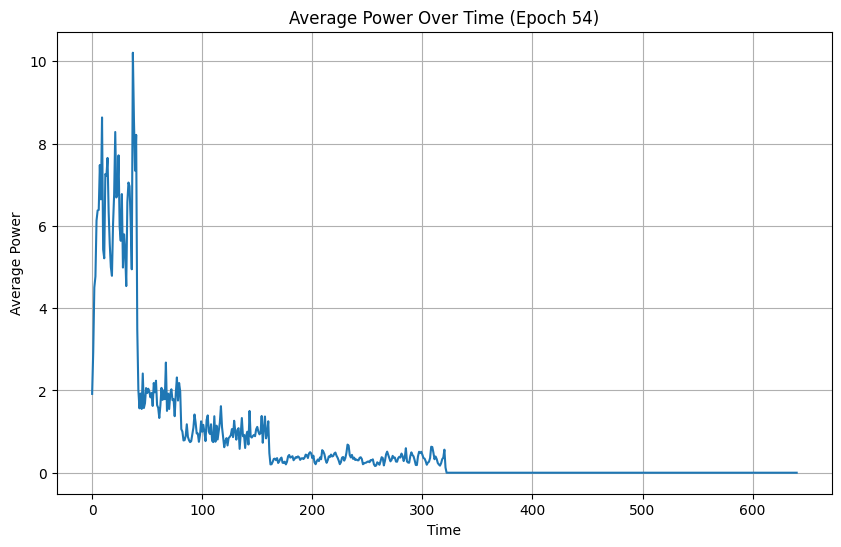

Epoch 55: Shape = (5, 14, 641)


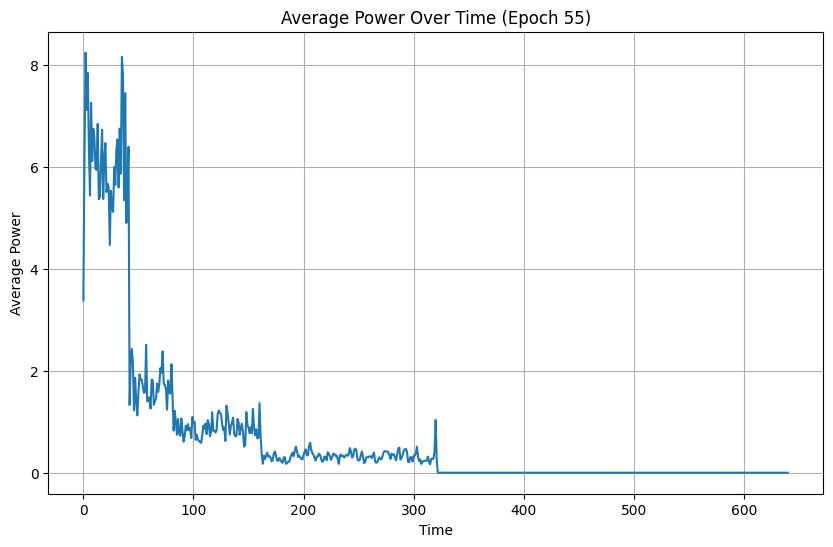

Epoch 56: Shape = (5, 14, 641)


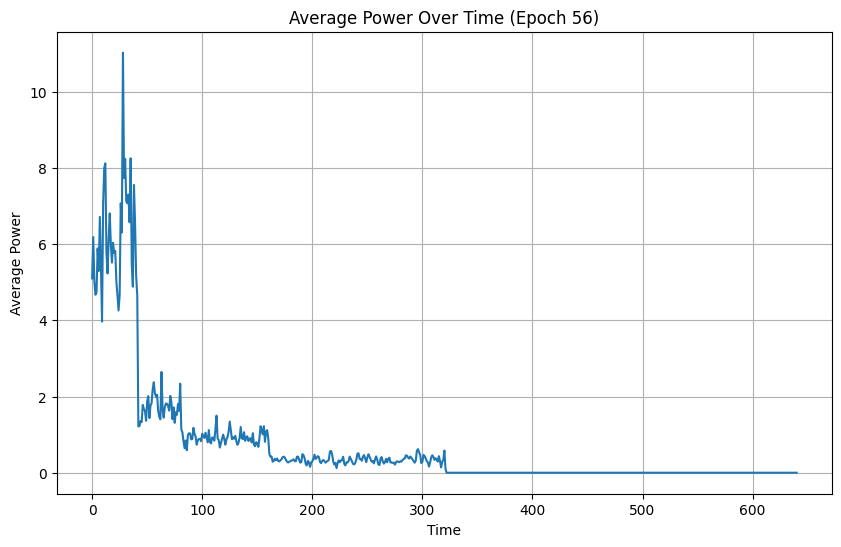

Epoch 57: Shape = (5, 14, 641)


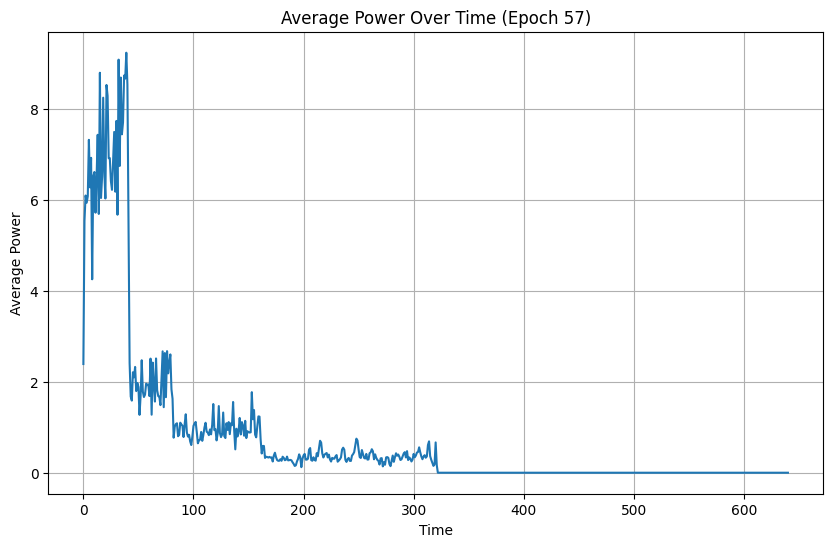

Epoch 58: Shape = (5, 14, 641)


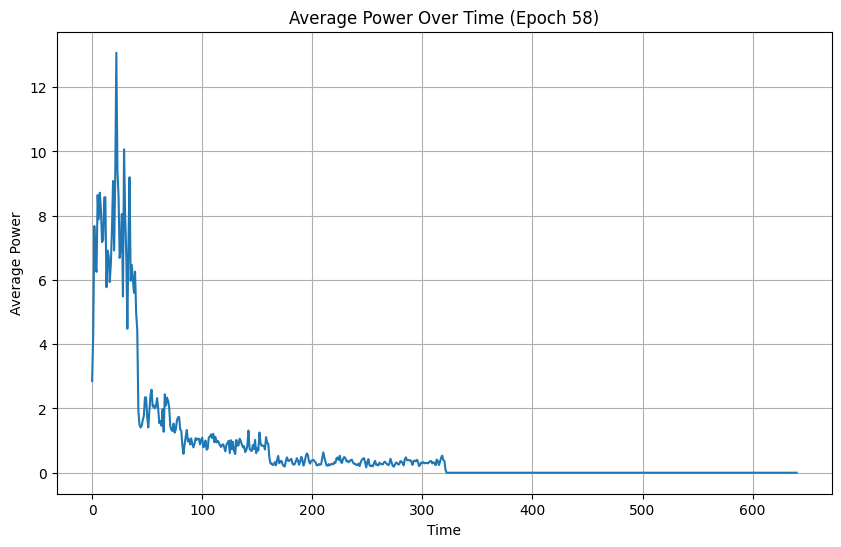

Epoch 59: Shape = (5, 14, 641)


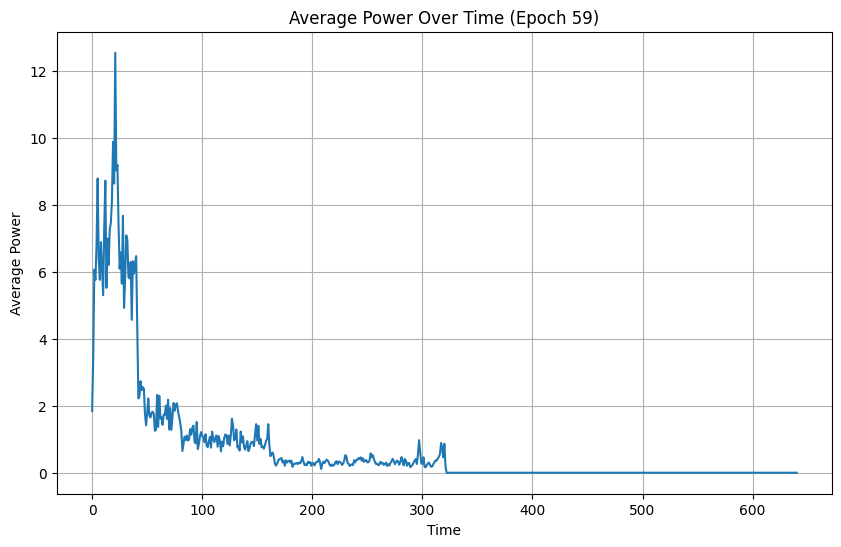

Epoch 60: Shape = (5, 14, 641)


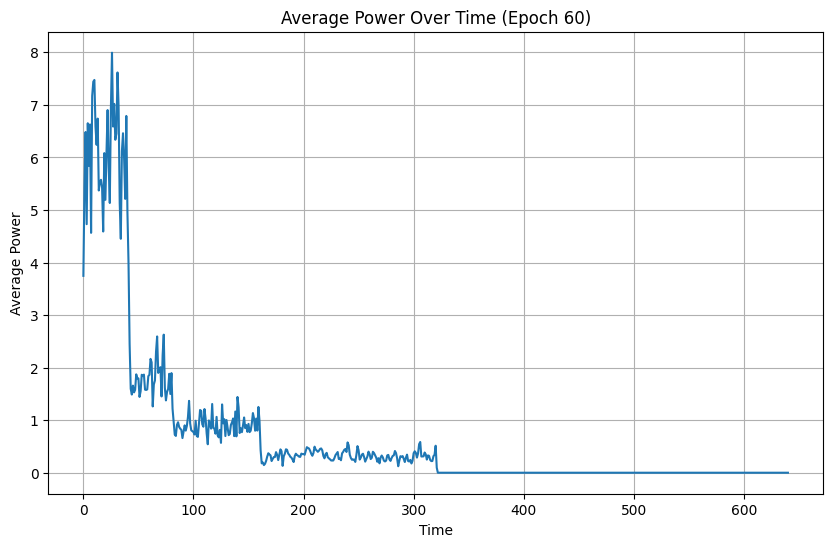

In [52]:
# Calculate average power across all frequency bands for each time point
for epoch_index, epoch_coefficients in enumerate(wavelet_coefficients_array_lh):
    print(f"Epoch {epoch_index + 1}: Shape = {epoch_coefficients.shape}")
    average_power = np.mean(np.abs(epoch_coefficients), axis=(0, 1))

    # Plot the average power over time
    plt.figure(figsize=(10, 6))
    plt.plot(average_power)
    plt.xlabel('Time')
    plt.ylabel('Average Power')
    plt.title(f'Average Power Over Time (Epoch {epoch_index + 1})')
    plt.grid(True)
    plt.show()


In [53]:
# # ISSUE WITH THE OVERFITTING.

# # Assuming baseline_corrected_epochs_rh and baseline_corrected_epochs_lh are lists of epochs

# # Concatenate epochs for right hand and left hand movements
# all_epochs = baseline_corrected_epochs_rh + baseline_corrected_epochs_lh

# # Create labels for each epoch (1 for right hand, 0 for left hand)
# labels_rh = np.ones(len(baseline_corrected_epochs_rh))
# labels_lh = np.zeros(len(baseline_corrected_epochs_lh))
# all_labels = np.concatenate([labels_rh, labels_lh])

# # Convert epochs and labels to numpy arrays
# all_epochs_array = np.array(all_epochs)
# all_labels_array = np.array(all_labels)

# # Shuffle data and labels to ensure randomness
# shuffle_indices = np.random.permutation(len(all_epochs_array))
# all_epochs_array_shuffled = all_epochs_array[shuffle_indices]
# all_labels_array_shuffled = all_labels_array[shuffle_indices]

# # Split data into training and testing sets (adjust the ratio as needed)
# train_ratio = 0.8
# num_train_samples = int(train_ratio * len(all_epochs_array))
# X_train = all_epochs_array_shuffled[:num_train_samples]
# y_train = all_labels_array_shuffled[:num_train_samples]
# X_test = all_epochs_array_shuffled[num_train_samples:]
# y_test = all_labels_array_shuffled[num_train_samples:]

# # Now you have X_train, y_train, X_test, and y_test ready for model training and evaluation


In [54]:
from sklearn.model_selection import train_test_split

# Combine the baseline-corrected epochs for left and right hand movements
X_lh = np.concatenate(baseline_corrected_epochs_lh, axis=0)
X_rh = np.concatenate(baseline_corrected_epochs_rh, axis=0)

# Create labels for the data (0 for left hand, 1 for right hand)
y_lh = np.zeros(X_lh.shape[0])  # Number of samples in X_lh
y_rh = np.ones(X_rh.shape[0])   # Number of samples in X_rh

# Split the data into training and testing sets for left hand
X_train_lh, X_test_lh, y_train_lh, y_test_lh = train_test_split(X_lh, y_lh, test_size=0.2, random_state=42)

# Split the data into training and testing sets for right hand
X_train_rh, X_test_rh, y_train_rh, y_test_rh = train_test_split(X_rh, y_rh, test_size=0.2, random_state=42)

# Split the training set into training and validation sets for left hand
X_train_lh, X_val_lh, y_train_lh, y_val_lh = train_test_split(X_train_lh, y_train_lh, test_size=0.25, random_state=42)

# Split the training set into training and validation sets for right hand
X_train_rh, X_val_rh, y_train_rh, y_val_rh = train_test_split(X_train_rh, y_train_rh, test_size=0.25, random_state=42)

# Combine the training and validation sets
X_train = np.concatenate((X_train_lh, X_train_rh), axis=0)
y_train = np.concatenate((y_train_lh, y_train_rh))
X_val = np.concatenate((X_val_lh, X_val_rh), axis=0)
y_val = np.concatenate((y_val_lh, y_val_rh))

# Combine the testing sets for left and right hand
X_test = np.concatenate((X_test_lh, X_test_rh), axis=0)
y_test = np.concatenate((y_test_lh, y_test_rh))


In [55]:
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import numpy as np

# Combine the baseline-corrected epochs for left and right hand movements
X_lh = np.concatenate(baseline_corrected_epochs_lh, axis=0)
X_rh = np.concatenate(baseline_corrected_epochs_rh, axis=0)

# Create labels for the data (0 for left hand, 1 for right hand)
y_lh = np.zeros(X_lh.shape[0])  # Create an array of zeros for left hand
y_rh = np.ones(X_rh.shape[0])   # Create an array of ones for right hand

# Combine the features and labels for left and right hand movements
X = np.concatenate((X_lh, X_rh), axis=0)
y = np.concatenate((y_lh, y_rh))

# # Split the data into training, validation, and testing sets
# X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
# X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# # Initialize the SVM classifier
# svm_classifier = SVC(kernel='linear', C=1.0, random_state=42)

# # Train the SVM classifier using the training set
# svm_classifier.fit(X_train, y_train)

# # Predict labels for the validation set
# y_val_pred = svm_classifier.predict(X_val)

# # Evaluate the classifier on the validation set
# print("Validation Set Classification Report:")
# print(classification_report(y_val, y_val_pred))

# # Predict labels for the test set
# y_test_pred = svm_classifier.predict(X_test)

# # Evaluate the classifier on the test set
# print("\nTest Set Classification Report:")
# print(classification_report(y_test, y_test_pred))


In [57]:
# # Visualizing SVM

# # Combine the baseline-corrected epochs for left and right hand movements
# X_lh = np.concatenate(baseline_corrected_epochs_lh, axis=0)
# X_rh = np.concatenate(baseline_corrected_epochs_rh, axis=0)

# # Create labels for the data (0 for left hand, 1 for right hand)
# y_lh = np.zeros(X_lh.shape[0])  # Number of samples in X_lh
# y_rh = np.ones(X_rh.shape[0])   # Number of samples in X_rh

# # Combine the features and labels for left and right hand movements
# X = np.concatenate((X_lh, X_rh), axis=0)
# y = np.concatenate((y_lh, y_rh))

# # Split the data into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# # Initialize the SVM classifier
# svm_classifier = SVC(kernel='linear', C=1.0, random_state=42)

# # Train the SVM classifier
# svm_classifier.fit(X_train, y_train)

# # Plot decision boundary and margins
# plt.figure(figsize=(10, 6))
# ax = plt.gca()
# xx, yy = np.meshgrid(np.linspace(X[:, 0].min(), X[:, 0].max(), 100),
#                      np.linspace(X[:, 1].min(), X[:, 1].max(), 100))
# xy = np.vstack([xx.ravel(), yy.ravel()]).T
# Z = svm_classifier.decision_function(xy).reshape(xx.shape)
# ax.contour(xx, yy, Z, colors='k', levels=[-1, 0, 1], alpha=0.5, linestyles=['--', '-', '--'])
# ax.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap=plt.cm.Paired, edgecolors='k', label='Training data')
# ax.scatter(X_test[:, 0], X_test[:, 1], c=y_test, cmap=plt.cm.Paired, edgecolors='k', marker='x', label='Test data')
# ax.legend()
# ax.set_title('SVM Decision Boundary')
# ax.set_xlabel('Feature 1')
# ax.set_ylabel('Feature 2')
# plt.show()


In [279]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.svm import SVC
from sklearn.metrics import classification_report

# Split the data into training and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Split the training set further into training and validation sets (75% train, 25% validation)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=42)

# Initialize the SVM classifier
svm_classifier = SVC(kernel='linear', C=1.0, random_state=42)

# Train the model on the training set
svm_classifier.fit(X_train, y_train)

# Predict labels for the validation set
y_pred_val = svm_classifier.predict(X_val)

# Evaluate the model on the validation set
print("Validation Set Classification Report:")
print(classification_report(y_val, y_pred_val))

# Perform cross-validation on the training set
cross_val_scores = cross_val_score(svm_classifier, X_train, y_train, cv=5)

# Print cross-validation scores
print("\nCross-validation scores:", cross_val_scores)
print("Mean cross-validation score:", cross_val_scores.mean())

# Finally, test the model on the test set
y_pred_test = svm_classifier.predict(X_test)

# Evaluate the model on the test set
print("\nTest Set Classification Report:")
print(classification_report(y_test, y_pred_test))


Validation Set Classification Report:
              precision    recall  f1-score   support

         0.0       0.33      0.38      0.35       156
         1.0       0.39      0.34      0.36       180

    accuracy                           0.36       336
   macro avg       0.36      0.36      0.36       336
weighted avg       0.36      0.36      0.36       336


Cross-validation scores: [0.43069307 0.43564356 0.45049505 0.43283582 0.4278607 ]
Mean cross-validation score: 0.4355056401162504

Test Set Classification Report:
              precision    recall  f1-score   support

         0.0       0.42      0.44      0.43       176
         1.0       0.35      0.33      0.34       160

    accuracy                           0.39       336
   macro avg       0.38      0.38      0.38       336
weighted avg       0.38      0.39      0.39       336



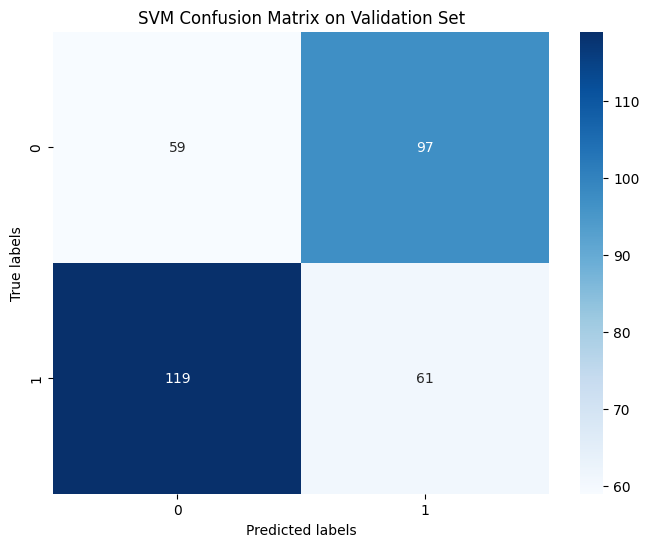

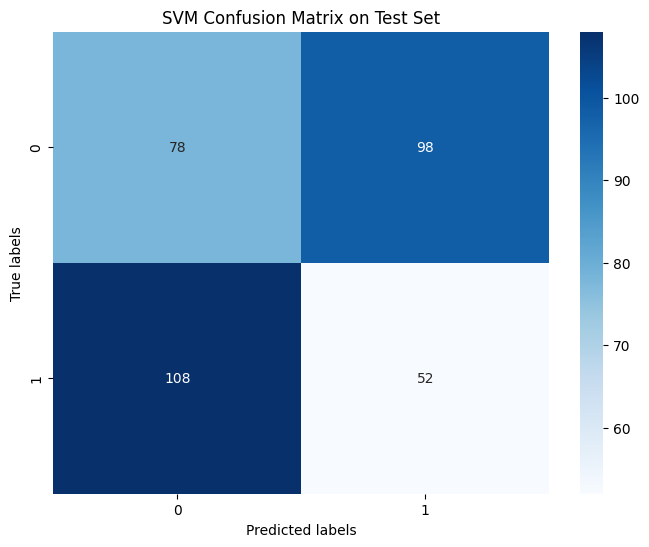

In [280]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming you have true labels y_val and predicted labels y_pred_val for the validation set

# Calculate confusion matrix for validation set
cm_svm_val = confusion_matrix(y_val, y_pred_val)

# Plot confusion matrix for SVM on validation set
plt.figure(figsize=(8, 6))
sns.heatmap(cm_svm_val, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('SVM Confusion Matrix on Validation Set')
plt.show()

# Assuming you have true labels y_test and predicted labels y_pred_test for the test set

# Calculate confusion matrix for test set
cm_svm_test = confusion_matrix(y_test, y_pred_test)

# Plot confusion matrix for SVM on test set
plt.figure(figsize=(8, 6))
sns.heatmap(cm_svm_test, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('SVM Confusion Matrix on Test Set')
plt.show()


In [281]:
# #CROSS VALIDATION
# # ISSUE WITH OVERFITTING
# from sklearn.model_selection import cross_val_score

# # Initialize the SVM classifier
# svm_classifier = SVC(kernel='linear', C=1.0, random_state=42)

# # Perform cross-validation
# cv_scores = cross_val_score(svm_classifier, X_train, y_train, cv=5)  # Use 5-fold cross-validation

# # Print the cross-validation scores
# print("Cross-validation scores:", cv_scores)
# print("Mean cross-validation score:", np.mean(cv_scores))


In [282]:
# print(X.shape)
# print(y)

In [283]:
# from sklearn.model_selection import cross_val_score
# import numpy as np

# # Define X and y based on your dataset

# # Flatten the epochs into 2D arrays if necessary
# X_flattened = np.reshape(X, (X.shape[0], -1))

# # Perform cross-validation
# cross_val_scores = cross_val_score(svm_classifier, X_flattened, y, cv=5)

# # Print cross-validation scores
# print("Cross-validation scores:", cross_val_scores)
# print("Mean cross-validation score:", cross_val_scores.mean())


In [284]:
#LSTM DATA PREPARATION

In [285]:
# import numpy as np
# from sklearn.model_selection import train_test_split
# from sklearn.preprocessing import LabelEncoder, StandardScaler

# # Concatenate the baseline-corrected epochs for left and right hand movements
# X_lh = np.concatenate(baseline_corrected_epochs_lh, axis=0)
# X_rh = np.concatenate(baseline_corrected_epochs_rh, axis=0)

# # Create labels for the data (0 for left hand, 1 for right hand)
# y_lh = np.zeros(len(baseline_corrected_epochs_lh))
# y_rh = np.ones(len(baseline_corrected_epochs_rh))

# # Concatenate the data and labels
# X = np.concatenate((X_lh, X_rh), axis=0)
# y = np.concatenate((y_lh, y_rh))

# # Encode labels
# label_encoder = LabelEncoder()
# y = label_encoder.fit_transform(y)

# # Split the data into training, validation, and test sets
# X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.2, random_state=42)
# X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# # Scale the features
# scaler = StandardScaler()
# X_train_scaled = scaler.fit_transform(X_train)
# X_val_scaled = scaler.transform(X_val)
# X_test_scaled = scaler.transform(X_test)

# # Reshape the data for LSTM input (assuming 3D input)
# # Adjust the input shape according to your data dimensions
# # For example, if each epoch is a 2D matrix, use (num_epochs, num_rows, num_cols)
# # If each epoch is already a 2D matrix, you can skip this step
# # X_train_scaled = X_train_scaled.reshape(X_train_scaled.shape[0], X_train_scaled.shape[1], 1)
# # X_val_scaled = X_val_scaled.reshape(X_val_scaled.shape[0], X_val_scaled.shape[1], 1)
# # X_test_scaled = X_test_scaled.reshape(X_test_scaled.shape[0], X_test_scaled.shape[1], 1)

# # Print shapes for verification
# print("Train data shape:", X_train_scaled.shape)
# print("Validation data shape:", X_val_scaled.shape)
# print("Test data shape:", X_test_scaled.shape)
# print("Train labels shape:", y_train.shape)
# print("Validation labels shape:", y_val.shape)
# print("Test labels shape:", y_test.shape)


In [286]:
import numpy as np

# Reshape input data for LSTM
X_lstm = X.reshape(X.shape[0], 1, X.shape[1])

# Split data into training, validation, and testing sets
X_train_lstm, X_test_lstm, y_train_lstm, y_test_lstm = train_test_split(X_lstm, y, test_size=0.2, random_state=42)


In [287]:
!pip install tensorflow

In [288]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Define the LSTM model
model = Sequential([
    LSTM(units=64, input_shape=(X_train_lstm.shape[1], X_train_lstm.shape[2])),
    Dense(units=1, activation='sigmoid')
])

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(X_train_lstm, y_train_lstm, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate the model on the test set
test_loss, test_accuracy = model.evaluate(X_test_lstm, y_test_lstm)
print(f'Test Loss: {test_loss}, Test Accuracy: {test_accuracy}')


Epoch 1/10


/Users/saiyarlagadda/.pyenv/versions/3.12.0/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


34/34 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.4965 - loss: 0.7128 - val_accuracy: 0.5465 - val_loss: 0.6687
Epoch 2/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9275 - loss: 0.4617 - val_accuracy: 0.5874 - val_loss: 0.6617
Epoch 3/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9924 - loss: 0.3341 - val_accuracy: 0.5836 - val_loss: 0.6469
Epoch 4/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9983 - loss: 0.2384 - val_accuracy: 0.5725 - val_loss: 0.6355
Epoch 5/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9992 - loss: 0.1726 - val_accuracy: 0.6059 - val_loss: 0.6324
Epoch 6/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1191 - val_accuracy: 0.6134 - val_loss: 0.6240
Epoch 7/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0858 - val_accuracy: 0.6468 - val_loss: 0.6112
Epoch 8/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0667 - val_accuracy: 0.6357 - val_loss: 0.6095
Epo

In [289]:
X_train_lstm.shape

(1344, 1, 641)

In [290]:
# Evaluation Matrix
# Make predictions on the test set
test_predictions = model.predict(X_test_lstm)

# Convert probabilities to class labels
test_predictions_classes = (test_predictions > 0.5).astype(int)

# Now you can use the evaluation matrix
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

# Calculate precision, recall, and F1-score
precision = precision_score(y_test_lstm, test_predictions_classes, average=None)
recall = recall_score(y_test_lstm, test_predictions_classes, average=None)
f1 = f1_score(y_test_lstm, test_predictions_classes, average=None)

# Print evaluation metrics for each class
for i in range(len(precision)):
    print(f"Class {i}: Precision={precision[i]}, Recall={recall[i]}, F1-score={f1[i]}")

# Calculate and print overall metrics
print("\nOverall Metrics:")
print("Precision:", precision_score(y_test_lstm, test_predictions_classes, average='weighted'))
print("Recall:", recall_score(y_test_lstm, test_predictions_classes, average='weighted'))
print("F1-score:", f1_score(y_test_lstm, test_predictions_classes, average='weighted'))

# You can also print the confusion matrix
print("\nConfusion Matrix:")
print(confusion_matrix(y_test_lstm, test_predictions_classes))


11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Class 0: Precision=0.6309523809523809, Recall=0.6022727272727273, F1-score=0.6162790697674418
Class 1: Precision=0.5833333333333334, Recall=0.6125, F1-score=0.5975609756097561

Overall Metrics:
Precision: 0.6082766439909297
Recall: 0.6071428571428571
F1-score: 0.6073656915971153

Confusion Matrix:
[[106  70]
 [ 62  98]]


11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 424us/step


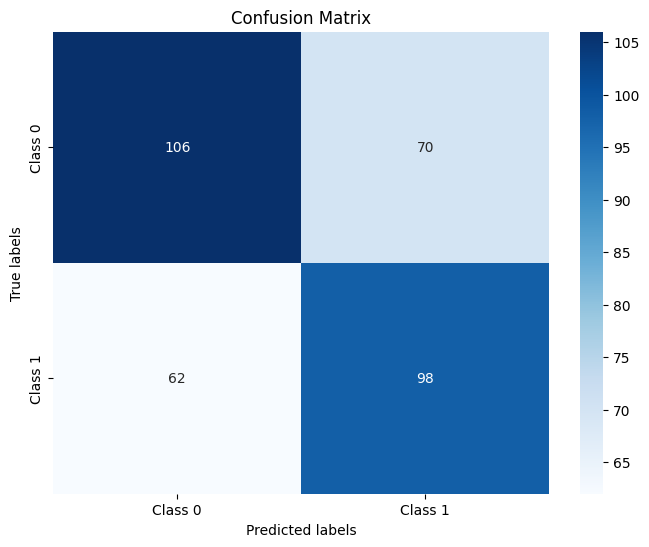

In [291]:
import numpy as np
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Make predictions on the test set
test_predictions = model.predict(X_test_lstm)

# Convert probabilities to class labels
test_predictions_classes = (test_predictions > 0.5).astype(int)

# Calculate confusion matrix
cm = confusion_matrix(y_test_lstm, test_predictions_classes)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()


In [292]:
from sklearn.model_selection import StratifiedKFold
import numpy as np

# Define the number of folds for cross-validation
num_folds = 5
kfold = StratifiedKFold(n_splits=num_folds, shuffle=True, random_state=42)

# Initialize lists to store evaluation metrics for each fold
accuracy_scores = []
loss_scores = []

# Loop over each fold
for fold, (train_index, test_index) in enumerate(kfold.split(X_lstm, y)):
    print(f"Fold {fold + 1}/{num_folds}")

    # Split data into training and testing sets for the current fold
    X_train, X_test = X_lstm[train_index], X_lstm[test_index]
    y_train, y_test = y[train_index], y[test_index]

    # Train the model on the training data for this fold
    history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2, verbose=1)

    # Evaluate the model on the testing data for this fold
    test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=1)

    # Store the evaluation metrics for this fold
    loss_scores.append(test_loss)
    accuracy_scores.append(test_accuracy)

# Calculate the mean and standard deviation of the evaluation metrics across all folds
mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)
mean_loss = np.mean(loss_scores)
std_loss = np.std(loss_scores)

print(f"\nMean Accuracy: {mean_accuracy:.4f} ± {std_accuracy:.4f}")
print(f"Mean Loss: {mean_loss:.4f} ± {std_loss:.4f}")


Fold 1/5
Epoch 1/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8590 - loss: 0.2636 - val_accuracy: 0.7658 - val_loss: 0.4642
Epoch 2/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9864 - loss: 0.1466 - val_accuracy: 0.7584 - val_loss: 0.4837
Epoch 3/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9990 - loss: 0.0846 - val_accuracy: 0.7361 - val_loss: 0.5074
Epoch 4/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0502 - val_accuracy: 0.7100 - val_loss: 0.5289
Epoch 5/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0352 - val_accuracy: 0.6952 - val_loss: 0.5479
Epoch 6/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0279 - val_accuracy: 0.6989 - val_loss: 0.5593
Epoch 7/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0206 - val_accuracy: 0.6877 - val_loss: 0.5689
Epoch 8/10
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0197 - val_accuracy: 0.6989 - 

# Conclusion:

## The SVM classifier achieves a hand movement detection accuracy of 46%, with a cross-validation score of 43%. In contrast, the LSTM model demonstrates an accuracy of 62% and a cross-validation score of 94%.

 #                                    THE END

## Test Model

### Test_Model_LL

In [202]:
filepath_ll=all_filepath[1]

data_ll=pd.read_csv(filepath_ll,skiprows=1)

In [203]:

af4_index = data_ll.columns.get_loc('EEG.AF4')
data_ll = data_ll.iloc[:, :af4_index + 1]
data_ll.head()

,Timestamp,OriginalTimestamp,EEG.Counter,EEG.Interpolated,EEG.AF3,EEG.F7,EEG.F3,EEG.FC5,EEG.T7,EEG.P7,EEG.O1,EEG.O2,EEG.P8,EEG.T8,EEG.FC6,EEG.F4,EEG.F8,EEG.AF4
0,1.708123e+09,1.708123e+09,29.0,0.0,4311.025879,4298.461426,4326.922852,4340.897461,4311.025879,4330.128418,4326.922852,4336.025879,4345.384766,4310.769043,4550.256348,4525.641113,4458.333496,4477.692383
1,1.708123e+09,1.708123e+09,30.0,0.0,4310.128418,4298.589844,4317.820313,4335.256348,4309.871582,4328.461426,4321.153809,4328.077148,4334.102539,4311.410156,4541.794922,4517.051270,4450.128418,4471.794922
2,1.708123e+09,1.708123e+09,31.0,0.0,4311.410156,4296.025879,4312.692383,4334.487305,4311.794922,4328.205078,4316.538574,4325.641113,4325.641113,4306.410156,4539.743652,4510.641113,4441.538574,4464.487305
3,1.708123e+09,1.708123e+09,32.0,0.0,4305.641113,4292.179688,4308.589844,4330.000000,4309.358887,4325.256348,4311.025879,4311.922852,4319.102539,4295.000000,4529.615234,4502.692383,4430.256348,4459.102539
4,1.708123e+09,1.708123e+09,33.0,0.0,4305.641113,4293.717773,4307.820313,4324.871582,4306.282227,4323.333496,4307.820313,4308.077148,4323.077148,4298.333496,4526.410156,4501.794922,4427.179688,4458.589844


In [204]:
data_ll.head()

,Timestamp,OriginalTimestamp,EEG.Counter,EEG.Interpolated,EEG.AF3,EEG.F7,EEG.F3,EEG.FC5,EEG.T7,EEG.P7,EEG.O1,EEG.O2,EEG.P8,EEG.T8,EEG.FC6,EEG.F4,EEG.F8,EEG.AF4
0,1.708123e+09,1.708123e+09,29.0,0.0,4311.025879,4298.461426,4326.922852,4340.897461,4311.025879,4330.128418,4326.922852,4336.025879,4345.384766,4310.769043,4550.256348,4525.641113,4458.333496,4477.692383
1,1.708123e+09,1.708123e+09,30.0,0.0,4310.128418,4298.589844,4317.820313,4335.256348,4309.871582,4328.461426,4321.153809,4328.077148,4334.102539,4311.410156,4541.794922,4517.051270,4450.128418,4471.794922
2,1.708123e+09,1.708123e+09,31.0,0.0,4311.410156,4296.025879,4312.692383,4334.487305,4311.794922,4328.205078,4316.538574,4325.641113,4325.641113,4306.410156,4539.743652,4510.641113,4441.538574,4464.487305
3,1.708123e+09,1.708123e+09,32.0,0.0,4305.641113,4292.179688,4308.589844,4330.000000,4309.358887,4325.256348,4311.025879,4311.922852,4319.102539,4295.000000,4529.615234,4502.692383,4430.256348,4459.102539
4,1.708123e+09,1.708123e+09,33.0,0.0,4305.641113,4293.717773,4307.820313,4324.871582,4306.282227,4323.333496,4307.820313,4308.077148,4323.077148,4298.333496,4526.410156,4501.794922,4427.179688,4458.589844


Creating RawArray with float64 data, n_channels=14, n_times=16763
    Range : 0 ... 16762 =      0.000 ...   130.953 secs
Ready.
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 423 samples (3.305 s)

Fitting ICA to data using 14 channels (please be patient, this may take a while)
Selecting by number: 2 components
Fitting ICA took 0.1s.
Applying ICA to Raw instance
    Transforming to ICA space (2 components)
    Zeroing out 2 ICA components
    Projecting back using 14 PCA components


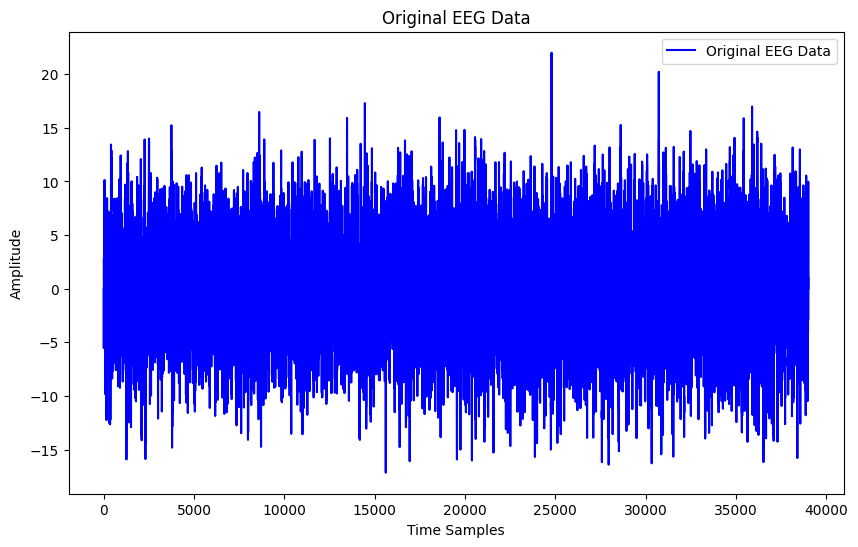

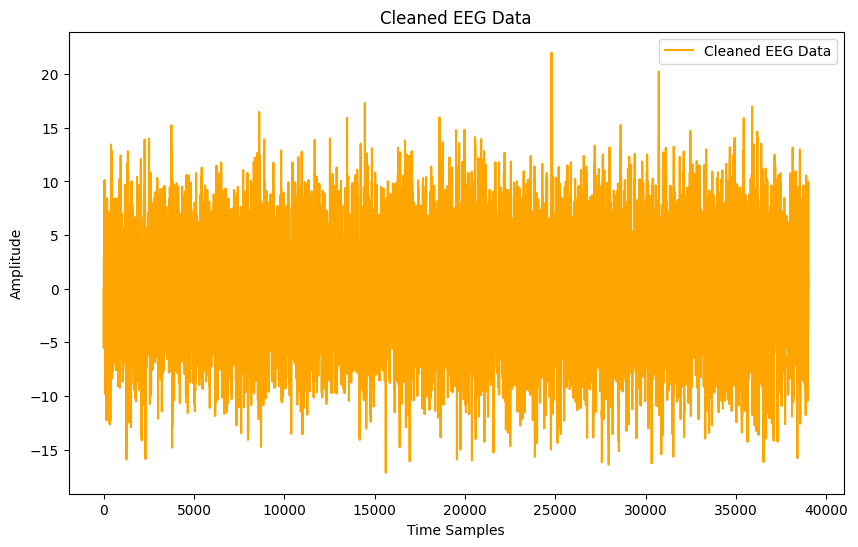

In [205]:
import pandas as pd
import numpy as np
import mne
from sklearn.decomposition import FastICA
import matplotlib.pyplot as plt

# Load EEG data from the CSV file
eeg_df = data_ll

# Extract EEG data columns (assuming EEG channels start from the 5th column)
eeg_data = eeg_df.iloc[:, 4:18].values

# Extract channel names
ch_names = eeg_df.columns[4:18].tolist()

# Create MNE Info object
info = mne.create_info(ch_names=ch_names, sfreq=128, ch_types='eeg')

# Transpose EEG data (rows as channels, columns as samples)
eeg_data = eeg_data.T

# Create MNE Raw object
raw_ll = mne.io.RawArray(eeg_data, info)

# Apply high-pass filter at 1 Hz
raw_ll.filter(l_freq=1, h_freq=None)

# Apply Independent Component Analysis (ICA) for artifact removal
n_components = 0.999999  # Set a threshold closer to 1
ica = mne.preprocessing.ICA(n_components=2, random_state=42)
ica.fit(raw_rh)

# ica = mne.preprocessing.ICA(n_components=5, random_state=42)
# ica.fit(raw)

# Identify components representing artifacts based on visual inspection
# Exclude artifact-related components from the data
ica.exclude = [0, 1, 2]  # Example: Exclude components 0, 1, and 2

# Apply ICA to Raw instance and obtain cleaned data
cleaned_eeg_data = ica.apply(raw_rh)

# Plot original and cleaned EEG data for inspection
# Plot original EEG data
plt.figure(figsize=(10, 6))
plt.plot(raw_rh._data[0, :],color='blue', label='Original EEG Data')
plt.xlabel('Time Samples')
plt.ylabel('Amplitude')
plt.title('Original EEG Data')
plt.legend()
plt.show()

# Plot cleaned EEG data
plt.figure(figsize=(10, 6))
plt.plot(cleaned_eeg_data._data[0, :],color='orange', label='Cleaned EEG Data')
plt.xlabel('Time Samples')
plt.ylabel('Amplitude')
plt.title('Cleaned EEG Data')
plt.legend()
plt.show()

# Save cleaned EEG data to CSV file
cleaned_eeg_df = pd.DataFrame(cleaned_eeg_data._data.T, columns=ch_names)
cleaned_eeg_df.to_csv('cleaned_data_rh.csv', index=False)


In [206]:
# import numpy as np

# # Function to segment EEG data into epochs
# def segment_epochs(eeg_data, epoch_length, sampling_frequency):
#     num_samples = len(eeg_data)
#     num_time_points_per_epoch = int(epoch_length * sampling_frequency)
#     num_epochs = num_samples // num_time_points_per_epoch
#     segmented_epochs = np.array_split(eeg_data[:num_epochs*num_time_points_per_epoch], num_epochs)
#     return segmented_epochs

# # Example usage
# eeg_data = data_ll 
# epoch_length = 5  # Length of each epoch in seconds
# sampling_frequency = 128  # Sampling frequency of the EEG data in Hz
# epochs_ll = segment_epochs(eeg_data, epoch_length, sampling_frequency)
duration = 5  # Duration of each epoch in seconds

# Define the start and end times for each epoch
start_times = np.arange(0, raw_ll.times[-1] - duration, duration)  # Adjusted to prevent exceeding max time
end_times = start_times + duration

# Create empty list to store epoch objects
epochs_ll = []

# Iterate over each epoch and extract the data
for start, end in zip(start_times, end_times):
    epoch = raw_ll.copy().crop(tmin=start, tmax=end)
    epochs_ll.append(epoch)

# Now 'epochs' is a list containing individual epoch objects
# You can further process or analyze each epoch as needed

In [207]:
epochs_ll

[<RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data loaded>,
 <RawArray | 14 x 641 (5.0 s), ~85 kB, data lo

In [208]:
epochs_ll_lstm.shape

(26, 14, 641)

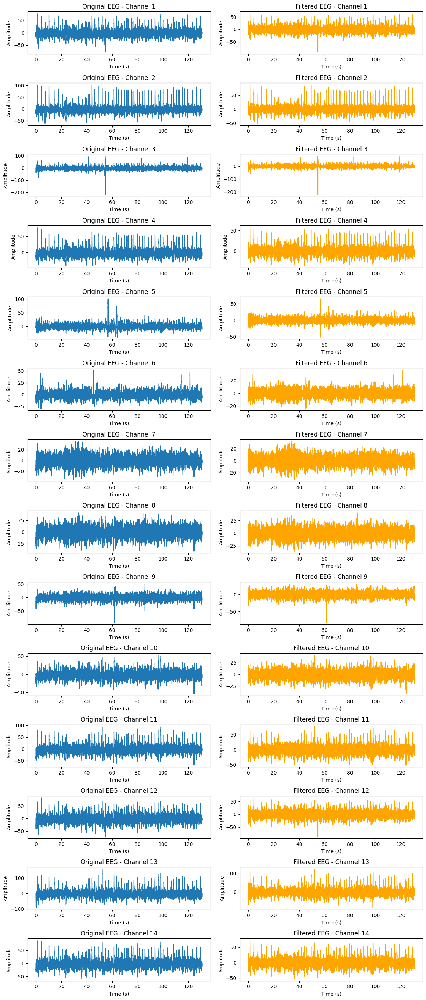

In [209]:
#LEFT Leg
eeg_df = data_ll

# Extract EEG data from the DataFrame (assuming EEG channels start from column 'EEG.AF3' to 'POW.AF4.Gamma')
eeg_data = eeg_df.iloc[:, 4:18].values  # Assuming EEG data starts from column index 4

# Extract timestamps from the DataFrame
timestamps = eeg_df['Timestamp'].values

# Define band-pass filter parameters
low_freq = 1  # Low cutoff frequency (Hz)
high_freq = 30  # High cutoff frequency (Hz)
sample_rate = 128  # Sampling rate (Hz)
order = 4  # Filter order

# Function to apply band-pass filter to EEG data
def bandpass_filter(eeg_data, lowcut, highcut, fs, order=4):
    nyquist_freq = 0.5 * fs
    low = lowcut / nyquist_freq
    high = highcut / nyquist_freq
    b, a = butter(order, [low, high], btype='band')
    filtered_data = filtfilt(b, a, eeg_data, axis=0)
    return filtered_data

# Apply band-pass filter to EEG data
filtered_eeg_data = bandpass_filter(eeg_data, low_freq, high_freq, sample_rate, order)

# Plot original and filtered EEG data for inspection
def plot_filtered_eeg(original_data, filtered_data, timestamps, sample_rate=128):
    time_axis = (timestamps - timestamps[0])  # Convert timestamps to relative time in seconds

    num_channels = original_data.shape[1]
    fig, ax = plt.subplots(num_channels, 2, figsize=(12, 2*num_channels))
    for i in range(num_channels):
        ax[i, 0].plot(time_axis, original_data[:, i])
        ax[i, 0].set_title(f'Original EEG - Channel {i+1}')
        ax[i, 0].set_xlabel('Time (s)')
        ax[i, 0].set_ylabel('Amplitude')
        
        ax[i, 1].plot(time_axis, filtered_data[:, i], color='orange')
        ax[i, 1].set_title(f'Filtered EEG - Channel {i+1}')
        ax[i, 1].set_xlabel('Time (s)')
        ax[i, 1].set_ylabel('Amplitude')

    plt.tight_layout()
    plt.show()

# Call the function to plot original and filtered EEG data
plot_filtered_eeg(eeg_data, filtered_eeg_data, timestamps)


In [210]:
import numpy as np

# Define baseline start and end (in seconds)
baseline_start = -0.2
baseline_end = 0

# Get the sampling frequency from the first epoch
sfreq = epochs_ll[0].info['sfreq']
print("Sample Frequencies:",sfreq)

# Convert baseline start and end from seconds to samples
baseline_start_idx = int(baseline_start * sfreq)
baseline_end_idx = int(baseline_end * sfreq)

# Ensure baseline indices are within the range of epoch data
baseline_start_idx = max(0, baseline_start_idx)
baseline_end_idx = min(epochs_ll[0].get_data().shape[1], baseline_end_idx)

# Compute baseline correction for each epoch
baseline_corrected_epochs_ll = []
for epoch in epochs_ll:
    # Extract epoch data
    epoch_data = epoch.get_data()
    
    # Check if baseline indices are valid
    if baseline_start_idx < baseline_end_idx:
        # Compute baseline correction (mean or median) along the time dimension
        baseline_values = np.mean(epoch_data[:, baseline_start_idx:baseline_end_idx], axis=1)
        # Or, if you prefer median:
        # baseline_values = np.median(epoch_data[:, baseline_start_idx:baseline_end_idx], axis=1)
        
        # Apply baseline correction
        baseline_corrected_epoch = epoch_data - baseline_values[:, np.newaxis]
    else:
        # If baseline indices are invalid, set baseline-corrected epoch to original epoch data
        baseline_corrected_epoch = epoch_data
    
    baseline_corrected_epochs_ll.append(baseline_corrected_epoch)

Sample Frequencies: 128.0


In [211]:
import pywt
import numpy as np

# Define parameters for wavelet transform
wavelet = 'db2'  # Choose a discrete wavelet, e.g., Daubechies 2
level = 4  # Choose the level of decomposition
mode = 'zero'  # Choose the extension mode for wavelet decomposition
axis = -1  # Choose the axis along which to apply wavelet transform

# Function to compute wavelet coefficients for each epoch
def compute_wavelet_coefficients(epoch_data, wavelet, level, mode, axis):
    coefficients = pywt.wavedec(epoch_data, wavelet, level=level, mode=mode, axis=axis)
    return coefficients

# Example EEG data (replace this with your actual EEG data)
# Assuming EEG data is stored in a pandas DataFrame named 'eeg_data'
# eeg_data = pd.read_csv(filepath, skiprows=1)

# Example DataFrame with random EEG-like data
num_epochs = 60  # Number of epochs
num_channels = 14  # Number of EEG channels per epoch
num_samples_per_epoch = 641  # Number of time points per epoch
# eeg_data_only = np.random.randn(num_epochs, num_channels, num_samples_per_epoch)

# Perform wavelet transform for each epoch
wavelet_coefficients = []
max_epoch_length = 0
for epoch_data in baseline_corrected_epochs_ll:
    epoch_coefficients = compute_wavelet_coefficients(epoch_data, wavelet, level, mode, axis)
    wavelet_coefficients.append(epoch_coefficients)
    # Update the maximum length of epochs
    max_epoch_length = max(max_epoch_length, epoch_data.shape[1])

# Pad or truncate each epoch to the length of the longest epoch
padded_wavelet_coefficients = []
for epoch_coeffs in wavelet_coefficients:
    padded_epoch_coeffs = [np.pad(coef, ((0, 0), (0, max_epoch_length - coef.shape[1])), mode='constant') for coef in epoch_coeffs]
    padded_wavelet_coefficients.append(padded_epoch_coeffs)

# Convert the list of padded wavelet coefficients to a numpy array
wavelet_coefficients_array_ll = np.array(padded_wavelet_coefficients)

# Now 'wavelet_coefficients_array' contains the wavelet coefficients for each epoch,
# with each epoch padded or truncated to the length of the longest epoch


In [212]:
import numpy as np

# Convert RawArray objects to NumPy arrays
epochs_ll_array = [epoch.get_data() for epoch in epochs_ll]

# Determine the maximum number of channels (features) across all epochs
max_channels = max(epoch.shape[1] for epoch in epochs_ll_array)

# Pad or crop each epoch to match the maximum number of channels
epochs_ll_padded = [np.pad(epoch, ((0, 0), (0, max_channels - epoch.shape[1])), mode='constant') if epoch.shape[1] < max_channels else epoch[:, :max_channels] for epoch in epochs_ll_array]

# Convert the list of epochs to a numpy array
epochs_ll_array = np.array(epochs_ll_padded)

# Reshape the EEG data to match the expected input shape of the LSTM model
epochs_ll_lstm = epochs_ll_array.reshape(len(epochs_ll_array), epochs_ll_array.shape[1], epochs_ll_array.shape[2])

# Make predictions on the epoch data
epoch_predictions = model.predict(epochs_ll_lstm)

# Interpret the predictions
for prediction in epoch_predictions:
    if prediction >= 0.5:
        print("Right hand movement")
    elif prediction < 0.5:
        print("Left hand movement")
    else:
        print("None")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Right hand movement
Left hand movement
Right hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Right hand movement
Left hand movement
Left hand movement
Left hand movement


### Test-2

In [213]:
filepath_rl=all_filepath[3]

data_rl=pd.read_csv(filepath_ll,skiprows=1)

In [214]:
data_rl.head()

,Timestamp,OriginalTimestamp,EEG.Counter,EEG.Interpolated,EEG.AF3,EEG.F7,EEG.F3,EEG.FC5,EEG.T7,EEG.P7,...,POW.F8.Theta,POW.F8.Alpha,POW.F8.BetaL,POW.F8.BetaH,POW.F8.Gamma,POW.AF4.Theta,POW.AF4.Alpha,POW.AF4.BetaL,POW.AF4.BetaH,POW.AF4.Gamma
0,1.708123e+09,1.708123e+09,29.0,0.0,4311.025879,4298.461426,4326.922852,4340.897461,4311.025879,4330.128418,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1.708123e+09,1.708123e+09,30.0,0.0,4310.128418,4298.589844,4317.820313,4335.256348,4309.871582,4328.461426,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.708123e+09,1.708123e+09,31.0,0.0,4311.410156,4296.025879,4312.692383,4334.487305,4311.794922,4328.205078,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1.708123e+09,1.708123e+09,32.0,0.0,4305.641113,4292.179688,4308.589844,4330.000000,4309.358887,4325.256348,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1.708123e+09,1.708123e+09,33.0,0.0,4305.641113,4293.717773,4307.820313,4324.871582,4306.282227,4323.333496,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [215]:

af4_index = data_rl.columns.get_loc('EEG.AF4')
data_rl = data_rl.iloc[:, :af4_index + 1]
data_rl.head()

,Timestamp,OriginalTimestamp,EEG.Counter,EEG.Interpolated,EEG.AF3,EEG.F7,EEG.F3,EEG.FC5,EEG.T7,EEG.P7,EEG.O1,EEG.O2,EEG.P8,EEG.T8,EEG.FC6,EEG.F4,EEG.F8,EEG.AF4
0,1.708123e+09,1.708123e+09,29.0,0.0,4311.025879,4298.461426,4326.922852,4340.897461,4311.025879,4330.128418,4326.922852,4336.025879,4345.384766,4310.769043,4550.256348,4525.641113,4458.333496,4477.692383
1,1.708123e+09,1.708123e+09,30.0,0.0,4310.128418,4298.589844,4317.820313,4335.256348,4309.871582,4328.461426,4321.153809,4328.077148,4334.102539,4311.410156,4541.794922,4517.051270,4450.128418,4471.794922
2,1.708123e+09,1.708123e+09,31.0,0.0,4311.410156,4296.025879,4312.692383,4334.487305,4311.794922,4328.205078,4316.538574,4325.641113,4325.641113,4306.410156,4539.743652,4510.641113,4441.538574,4464.487305
3,1.708123e+09,1.708123e+09,32.0,0.0,4305.641113,4292.179688,4308.589844,4330.000000,4309.358887,4325.256348,4311.025879,4311.922852,4319.102539,4295.000000,4529.615234,4502.692383,4430.256348,4459.102539
4,1.708123e+09,1.708123e+09,33.0,0.0,4305.641113,4293.717773,4307.820313,4324.871582,4306.282227,4323.333496,4307.820313,4308.077148,4323.077148,4298.333496,4526.410156,4501.794922,4427.179688,4458.589844


Creating RawArray with float64 data, n_channels=14, n_times=16763
    Range : 0 ... 16762 =      0.000 ...   130.953 secs
Ready.
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 423 samples (3.305 s)

Fitting ICA to data using 14 channels (please be patient, this may take a while)
Selecting by number: 2 components
Fitting ICA took 0.1s.
Applying ICA to Raw instance
    Transforming to ICA space (2 components)
    Zeroing out 2 ICA components
    Projecting back using 14 PCA components


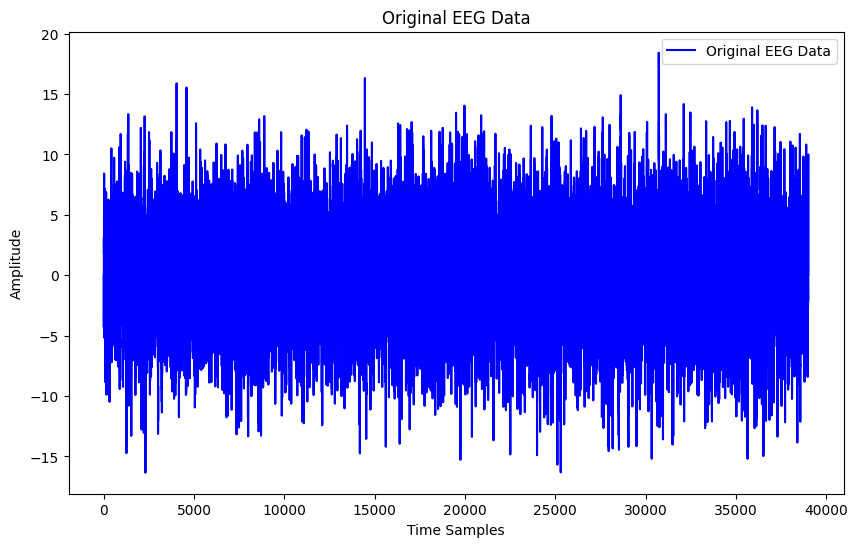

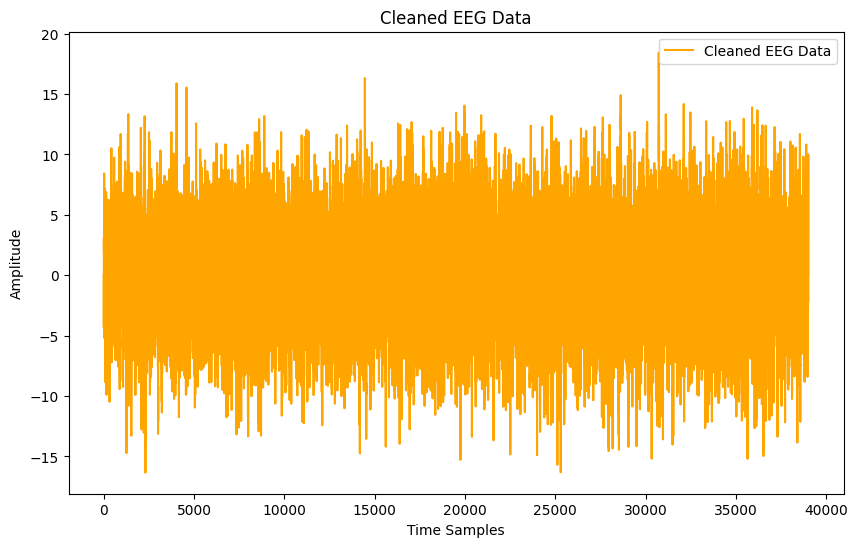

In [216]:
import pandas as pd
import numpy as np
import mne
from sklearn.decomposition import FastICA
import matplotlib.pyplot as plt

# Load EEG data from the CSV file
eeg_df = data_rl

# Extract EEG data columns (assuming EEG channels start from the 5th column)
eeg_data = eeg_df.iloc[:, 4:18].values

# Extract channel names
ch_names = eeg_df.columns[4:18].tolist()

# Create MNE Info object
info = mne.create_info(ch_names=ch_names, sfreq=128, ch_types='eeg')

# Transpose EEG data (rows as channels, columns as samples)
eeg_data = eeg_data.T

# Create MNE Raw object
raw_rl = mne.io.RawArray(eeg_data, info)

# Apply high-pass filter at 1 Hz
raw_rl.filter(l_freq=1, h_freq=None)

# Apply Independent Component Analysis (ICA) for artifact removal
n_components = 0.999999  # Set a threshold closer to 1
ica = mne.preprocessing.ICA(n_components=2, random_state=42)
ica.fit(raw_rh)

# ica = mne.preprocessing.ICA(n_components=5, random_state=42)
# ica.fit(raw)

# Identify components representing artifacts based on visual inspection
# Exclude artifact-related components from the data
ica.exclude = [0, 1, 2]  # Example: Exclude components 0, 1, and 2

# Apply ICA to Raw instance and obtain cleaned data
cleaned_eeg_data = ica.apply(raw_rh)

# Plot original and cleaned EEG data for inspection
# Plot original EEG data
plt.figure(figsize=(10, 6))
plt.plot(raw_rh._data[0, :],color='blue', label='Original EEG Data')
plt.xlabel('Time Samples')
plt.ylabel('Amplitude')
plt.title('Original EEG Data')
plt.legend()
plt.show()

# Plot cleaned EEG data
plt.figure(figsize=(10, 6))
plt.plot(cleaned_eeg_data._data[0, :],color='orange', label='Cleaned EEG Data')
plt.xlabel('Time Samples')
plt.ylabel('Amplitude')
plt.title('Cleaned EEG Data')
plt.legend()
plt.show()

# Save cleaned EEG data to CSV file
cleaned_eeg_df = pd.DataFrame(cleaned_eeg_data._data.T, columns=ch_names)
cleaned_eeg_df.to_csv('cleaned_data_rl.csv', index=False)


In [217]:
# import numpy as np

# # Function to segment EEG data into epochs
# def segment_epochs(eeg_data, epoch_length, sampling_frequency):
#     num_samples = len(eeg_data)
#     num_time_points_per_epoch = int(epoch_length * sampling_frequency)
#     num_epochs = num_samples // num_time_points_per_epoch
#     segmented_epochs = np.array_split(eeg_data[:num_epochs*num_time_points_per_epoch], num_epochs)
#     return segmented_epochs

# # Example usage
# eeg_data = data_ll 
# epoch_length = 5  # Length of each epoch in seconds
# sampling_frequency = 128  # Sampling frequency of the EEG data in Hz
# epochs_ll = segment_epochs(eeg_data, epoch_length, sampling_frequency)
duration = 5  # Duration of each epoch in seconds

# Define the start and end times for each epoch
start_times = np.arange(0, raw_rl.times[-1] - duration, duration)  # Adjusted to prevent exceeding max time
end_times = start_times + duration

# Create empty list to store epoch objects
epochs_rl = []

# Iterate over each epoch and extract the data
for start, end in zip(start_times, end_times):
    epoch = raw_rl.copy().crop(tmin=start, tmax=end)
    epochs_rl.append(epoch)

# Now 'epochs' is a list containing individual epoch objects
# You can further process or analyze each epoch as needed

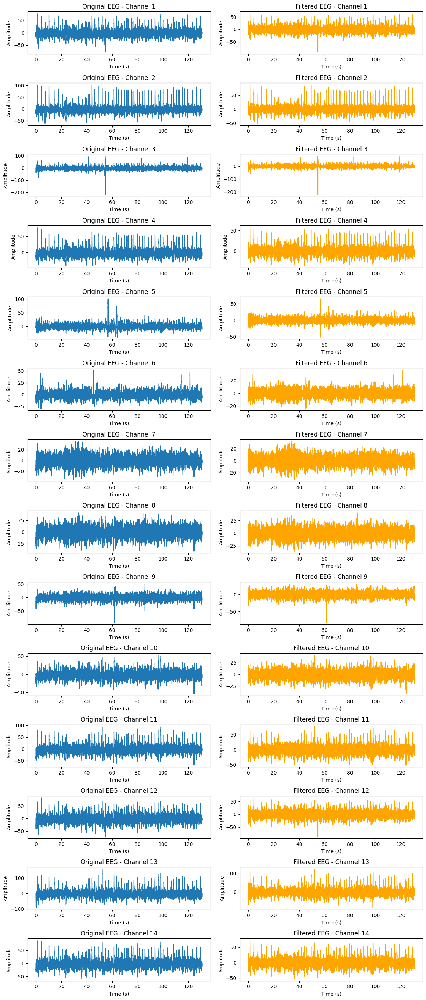

In [218]:
#LEFT Leg
eeg_df = data_rl

# Extract EEG data from the DataFrame (assuming EEG channels start from column 'EEG.AF3' to 'POW.AF4.Gamma')
eeg_data = eeg_df.iloc[:, 4:18].values  # Assuming EEG data starts from column index 4

# Extract timestamps from the DataFrame
timestamps = eeg_df['Timestamp'].values

# Define band-pass filter parameters
low_freq = 1  # Low cutoff frequency (Hz)
high_freq = 30  # High cutoff frequency (Hz)
sample_rate = 128  # Sampling rate (Hz)
order = 4  # Filter order

# Function to apply band-pass filter to EEG data
def bandpass_filter(eeg_data, lowcut, highcut, fs, order=4):
    nyquist_freq = 0.5 * fs
    low = lowcut / nyquist_freq
    high = highcut / nyquist_freq
    b, a = butter(order, [low, high], btype='band')
    filtered_data = filtfilt(b, a, eeg_data, axis=0)
    return filtered_data

# Apply band-pass filter to EEG data
filtered_eeg_data = bandpass_filter(eeg_data, low_freq, high_freq, sample_rate, order)

# Plot original and filtered EEG data for inspection
def plot_filtered_eeg(original_data, filtered_data, timestamps, sample_rate=128):
    time_axis = (timestamps - timestamps[0])  # Convert timestamps to relative time in seconds

    num_channels = original_data.shape[1]
    fig, ax = plt.subplots(num_channels, 2, figsize=(12, 2*num_channels))
    for i in range(num_channels):
        ax[i, 0].plot(time_axis, original_data[:, i])
        ax[i, 0].set_title(f'Original EEG - Channel {i+1}')
        ax[i, 0].set_xlabel('Time (s)')
        ax[i, 0].set_ylabel('Amplitude')
        
        ax[i, 1].plot(time_axis, filtered_data[:, i], color='orange')
        ax[i, 1].set_title(f'Filtered EEG - Channel {i+1}')
        ax[i, 1].set_xlabel('Time (s)')
        ax[i, 1].set_ylabel('Amplitude')

    plt.tight_layout()
    plt.show()

# Call the function to plot original and filtered EEG data
plot_filtered_eeg(eeg_data, filtered_eeg_data, timestamps)


In [219]:
import numpy as np

# Define baseline start and end (in seconds)
baseline_start = -0.2
baseline_end = 0

# Get the sampling frequency from the first epoch
sfreq = epochs_rl[0].info['sfreq']
print("Sample Frequencies:",sfreq)

# Convert baseline start and end from seconds to samples
baseline_start_idx = int(baseline_start * sfreq)
baseline_end_idx = int(baseline_end * sfreq)

# Ensure baseline indices are within the range of epoch data
baseline_start_idx = max(0, baseline_start_idx)
baseline_end_idx = min(epochs_rl[0].get_data().shape[1], baseline_end_idx)

# Compute baseline correction for each epoch
baseline_corrected_epochs_rl = []
for epoch in epochs_rl:
    # Extract epoch data
    epoch_data = epoch.get_data()
    
    # Check if baseline indices are valid
    if baseline_start_idx < baseline_end_idx:
        # Compute baseline correction (mean or median) along the time dimension
        baseline_values = np.mean(epoch_data[:, baseline_start_idx:baseline_end_idx], axis=1)
        # Or, if you prefer median:
        # baseline_values = np.median(epoch_data[:, baseline_start_idx:baseline_end_idx], axis=1)
        
        # Apply baseline correction
        baseline_corrected_epoch = epoch_data - baseline_values[:, np.newaxis]
    else:
        # If baseline indices are invalid, set baseline-corrected epoch to original epoch data
        baseline_corrected_epoch = epoch_data
    
    baseline_corrected_epochs_rl.append(baseline_corrected_epoch)

Sample Frequencies: 128.0


In [220]:
import pywt
import numpy as np

# Define parameters for wavelet transform
wavelet = 'db2'  # Choose a discrete wavelet, e.g., Daubechies 2
level = 4  # Choose the level of decomposition
mode = 'zero'  # Choose the extension mode for wavelet decomposition
axis = -1  # Choose the axis along which to apply wavelet transform

# Function to compute wavelet coefficients for each epoch
def compute_wavelet_coefficients(epoch_data, wavelet, level, mode, axis):
    coefficients = pywt.wavedec(epoch_data, wavelet, level=level, mode=mode, axis=axis)
    return coefficients

# Example EEG data (replace this with your actual EEG data)
# Assuming EEG data is stored in a pandas DataFrame named 'eeg_data'
# eeg_data = pd.read_csv(filepath, skiprows=1)

# Example DataFrame with random EEG-like data
num_epochs = 60  # Number of epochs
num_channels = 14  # Number of EEG channels per epoch
num_samples_per_epoch = 641  # Number of time points per epoch
# eeg_data_only = np.random.randn(num_epochs, num_channels, num_samples_per_epoch)

# Perform wavelet transform for each epoch
wavelet_coefficients = []
max_epoch_length = 0
for epoch_data in baseline_corrected_epochs_rl:
    epoch_coefficients = compute_wavelet_coefficients(epoch_data, wavelet, level, mode, axis)
    wavelet_coefficients.append(epoch_coefficients)
    # Update the maximum length of epochs
    max_epoch_length = max(max_epoch_length, epoch_data.shape[1])

# Pad or truncate each epoch to the length of the longest epoch
padded_wavelet_coefficients = []
for epoch_coeffs in wavelet_coefficients:
    padded_epoch_coeffs = [np.pad(coef, ((0, 0), (0, max_epoch_length - coef.shape[1])), mode='constant') for coef in epoch_coeffs]
    padded_wavelet_coefficients.append(padded_epoch_coeffs)

# Convert the list of padded wavelet coefficients to a numpy array
wavelet_coefficients_array_rl = np.array(padded_wavelet_coefficients)

# Now 'wavelet_coefficients_array' contains the wavelet coefficients for each epoch,
# with each epoch padded or truncated to the length of the longest epoch


In [223]:
import numpy as np

# Convert RawArray objects to NumPy arrays
epochs_rl_array = [epoch.get_data() for epoch in epochs_rl]

# Determine the maximum number of channels (features) across all epochs
max_channels = max(epoch.shape[1] for epoch in epochs_rl_array)

# Pad or crop each epoch to match the maximum number of channels
epochs_rl_padded = [np.pad(epoch, ((0, 0), (0, max_channels - epoch.shape[1])), mode='constant') if epoch.shape[1] < max_channels else epoch[:, :max_channels] for epoch in epochs_rl_array]

# Convert the list of epochs to a numpy array
epochs_rl_array = np.array(epochs_rl_padded)

# Reshape the EEG data to match the expected input shape of the LSTM model
epochs_rl_lstm = epochs_rl_array.reshape(len(epochs_rl_array), epochs_rl_array.shape[1], epochs_rl_array.shape[2])

# Make predictions on the epoch data
epoch_predictions = model.predict(epochs_rl_lstm)

# Interpret the predictions
for prediction in epoch_predictions:
    if prediction >= 0.5:
        print("Right hand movement")
    elif prediction < 0.5:
        print("Left hand movement")
    else:
        print("None")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Right hand movement
Left hand movement
Right hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Left hand movement
Right hand movement
Left hand movement
Left hand movement
Left hand movement
